In [1]:
from sqlite3 import SQLITE_CREATE_VIEW
import anndata
import scanpy as sc
import os
#from bbknn import bbknn
import matplotlib.pyplot as plt
import omicverse as ov
#import scib
from scvi.model.utils import mde
#from scib_metrics.benchmark import Benchmarker
import scvi
#import scanorama
import numpy as np
#import pyliger
#from harmony import harmonize
from rich import print
import seaborn as sns
#import bbknn
#import doubletdetection
%matplotlib inline
import pandas as pd
plt.rcParams.update({'font.size': 12})


   ____            _     _    __                  
  / __ \____ ___  (_)___| |  / /__  _____________ 
 / / / / __ `__ \/ / ___/ | / / _ \/ ___/ ___/ _ \ 
/ /_/ / / / / / / / /__ | |/ /  __/ /  (__  )  __/ 
\____/_/ /_/ /_/_/\___/ |___/\___/_/  /____/\___/                                              

Version: 1.5.3, Tutorials: https://omicverse.readthedocs.io/


[rank: 0] Global seed set to 0


In [2]:
#####Change path and Load data
os.chdir("/storage/liuxiaodongLab/fanxueying/mayanalysis/2024Aug")
adata = anndata.read_h5ad("human_clustering.h5ad")

In [3]:
adata

AnnData object with n_obs × n_vars = 33599 × 60421
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sample', 'stage', 'percent.mt', 'species', 'embryo', 'platform', 'ann_level_2', 'ann_level_3', 'ann_level_1', 'doublet', 'doublet_score', 'Unintegrated_res_0.5', 'Scanorama_res_0.5', 'LIGER_res_0.5', 'Harmony_res_0.5', 'scVI_res_0.5', 'scANVI_res_0.5', 'CCA_res_0.5', 'FastMNN_res_0.5', 'leiden_1', 'leiden_2', 'leiden_3', 'leiden_4'
    var: 'features', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'CCA_res_0.5_colors', 'FastMNN_res_0.5_colors', 'Harmony_res_0.5_colors', 'LIGER_res_0.5_colors', 'Scanorama_res_0.5_colors', 'Unintegrated_res_0.5_colors', 'anno_colors', 'harmo.anno_colors', 'hvg', 'leiden', 'leiden_3_colors', 'log1p', 'neighbors', 'orig.ident_colors', 'pca', 'scANVI_res_0.5_colors', 'scVI_res_0.5_colors', 'stage_colors', 'sub_anno_colors', 'umap'
    obsm: 'CCA', 'FastMNN', '

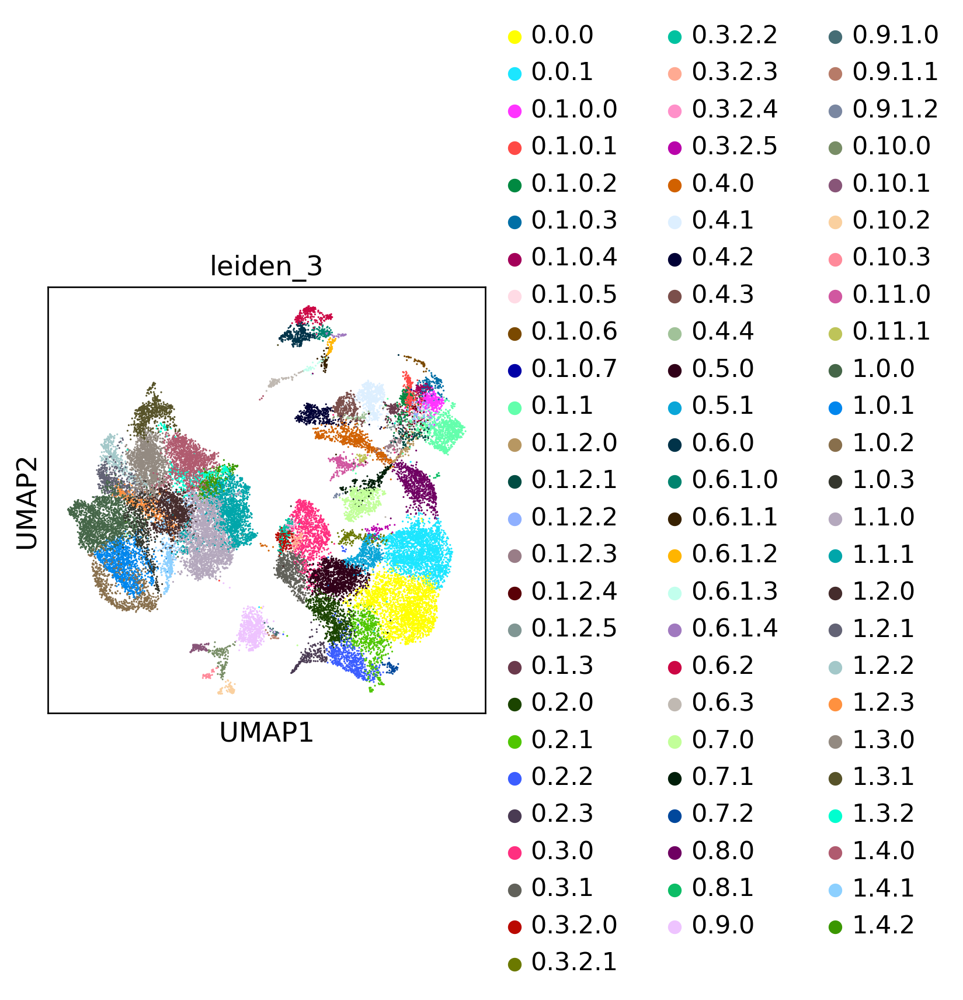

In [4]:
# plot
sc.pl.umap(adata, color="leiden_3")

In [5]:
# focusing on TE/TrB lineage
ana_sub= adata[adata.obs['ann_level_1'].isin([ 'ICM', 'TE/TrB'])]

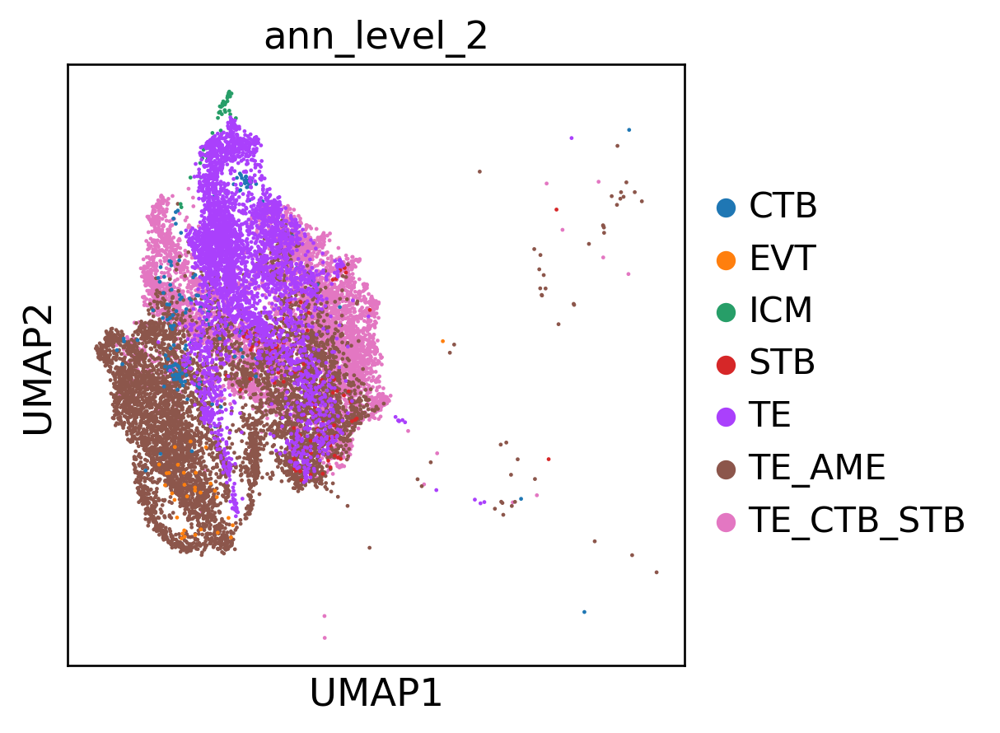

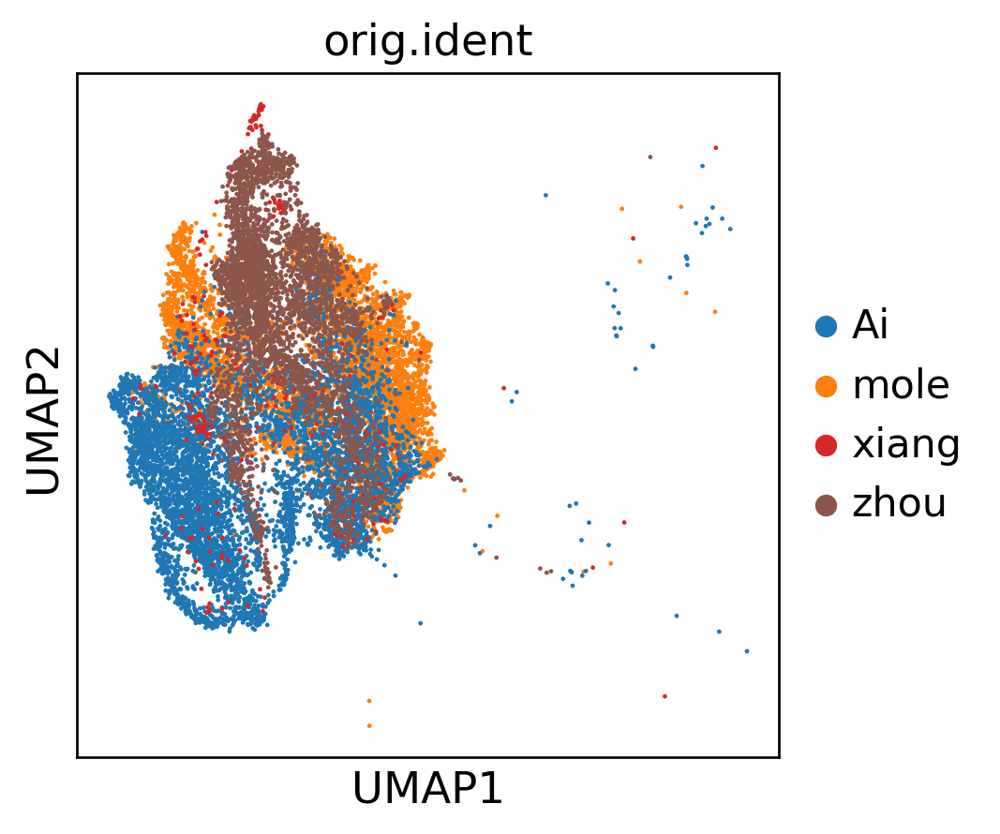

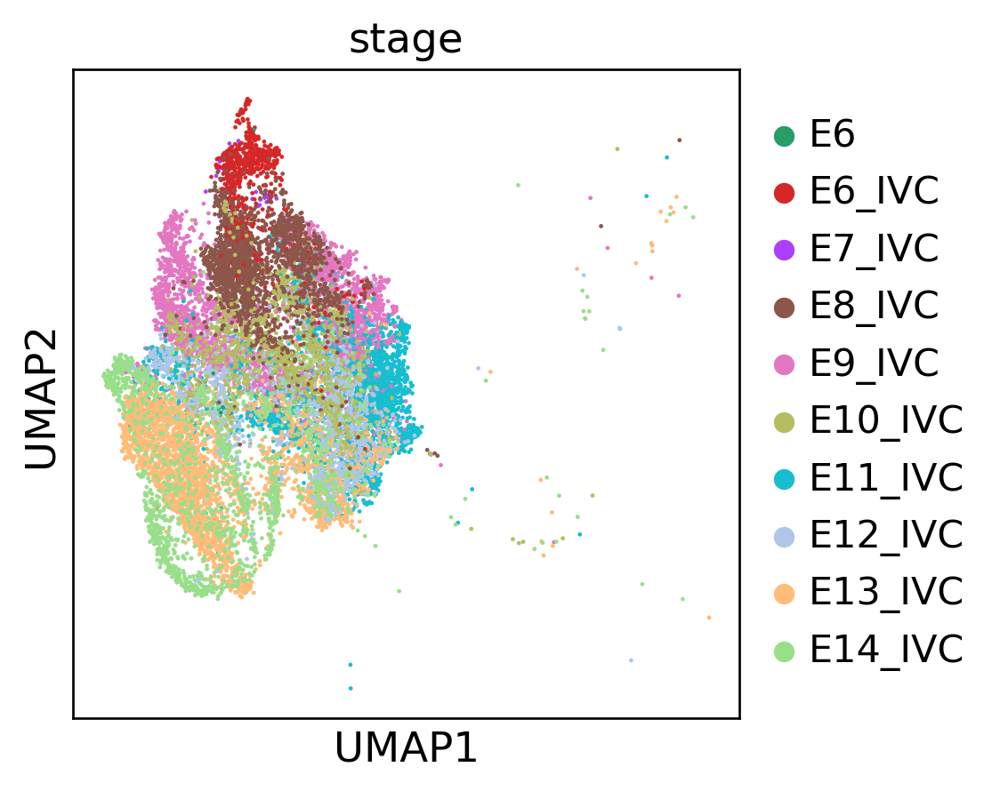

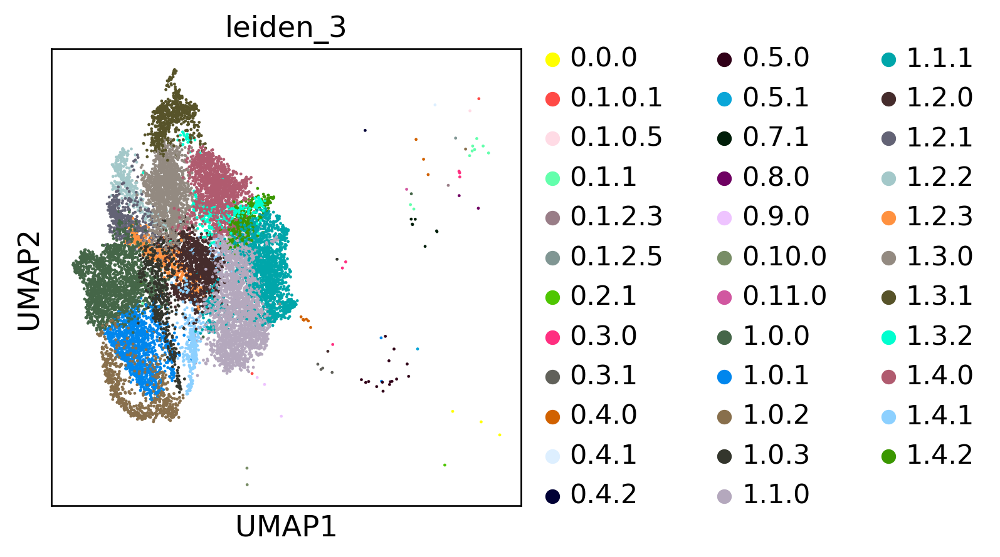

In [6]:
sc.pl.umap(ana_sub, color=['ann_level_2'])
sc.pl.umap(ana_sub, color=['orig.ident'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['leiden_3'])

In [7]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_3'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)


1.1.0      2357
1.0.0      1810
1.1.1      1671
1.3.0      1477
1.4.0      1386
1.0.1      1211
1.2.0      1172
1.0.2       648
1.3.1       610
1.2.1       490
1.0.3       373
1.2.2       366
1.2.3       359
1.4.1       329
1.3.2       283
1.4.2       275
0.5.0        15
0.4.0        11
0.1.1        10
0.7.1         7
0.3.0         7
0.3.1         4
0.0.0         3
0.9.0         3
0.1.0.1       2
0.8.0         2
0.2.1         2
0.10.0        2
0.11.0        1
0.5.1         1
0.4.2         1
0.4.1         1
0.1.2.5       1
0.1.2.3       1
0.1.0.5       1
Name: leiden_3, dtype: int64

In [8]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 20].index

# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_3'].isin(clusters_to_keep)]

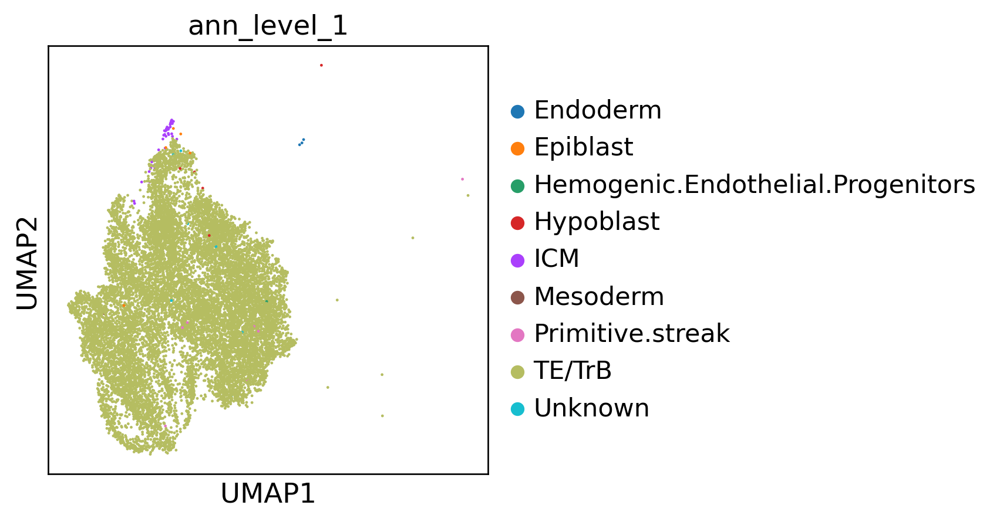

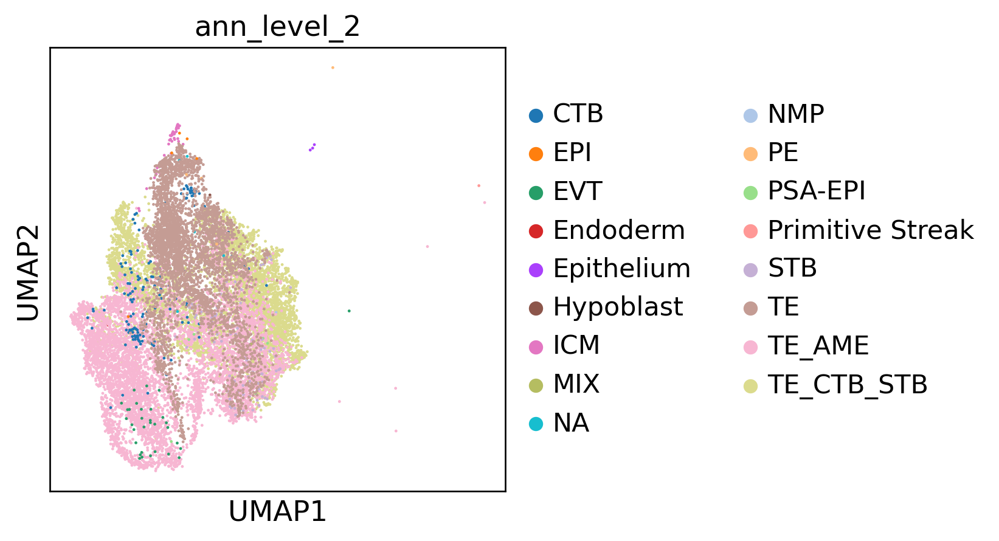

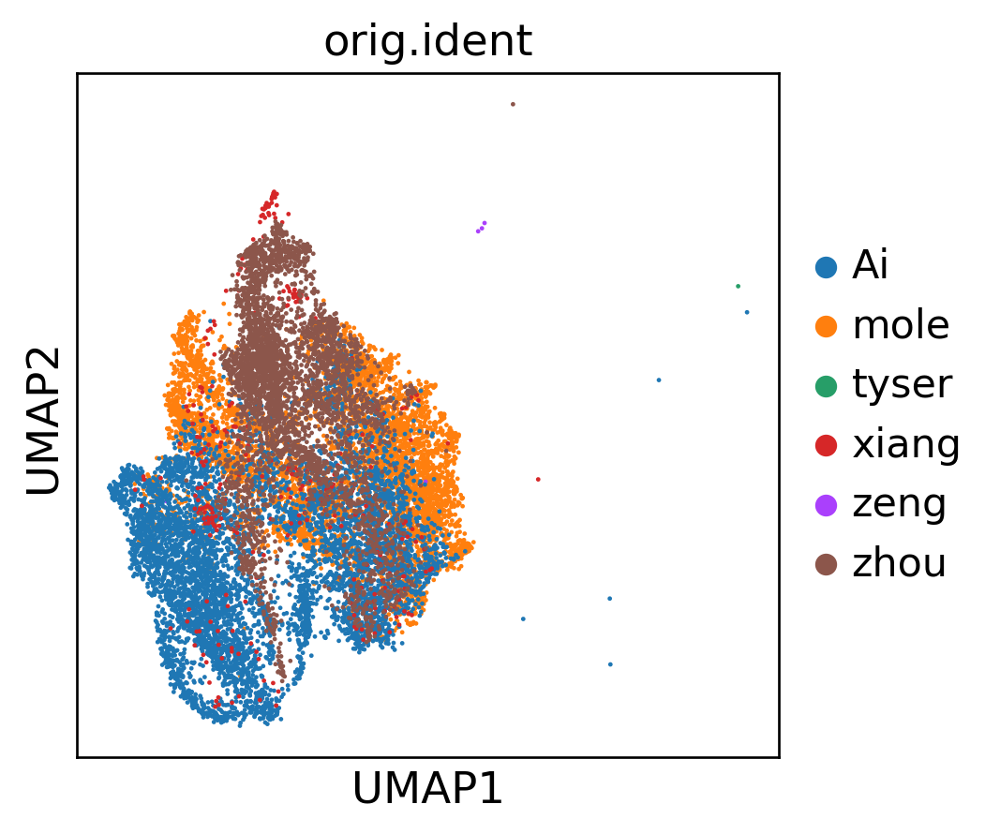

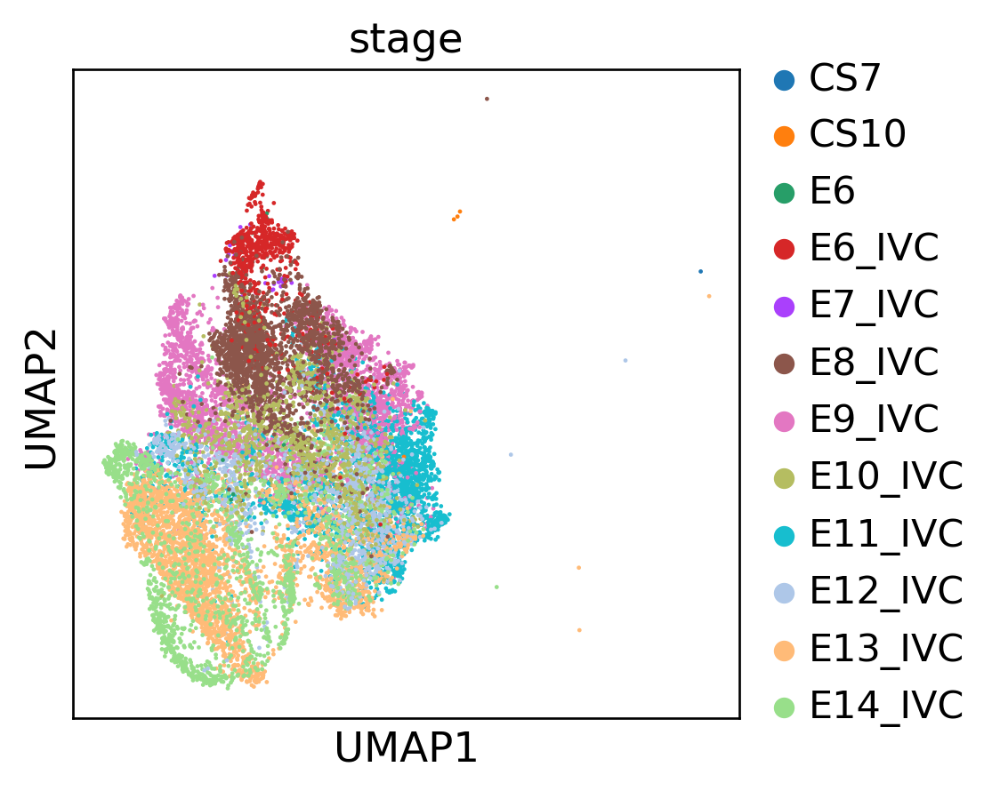

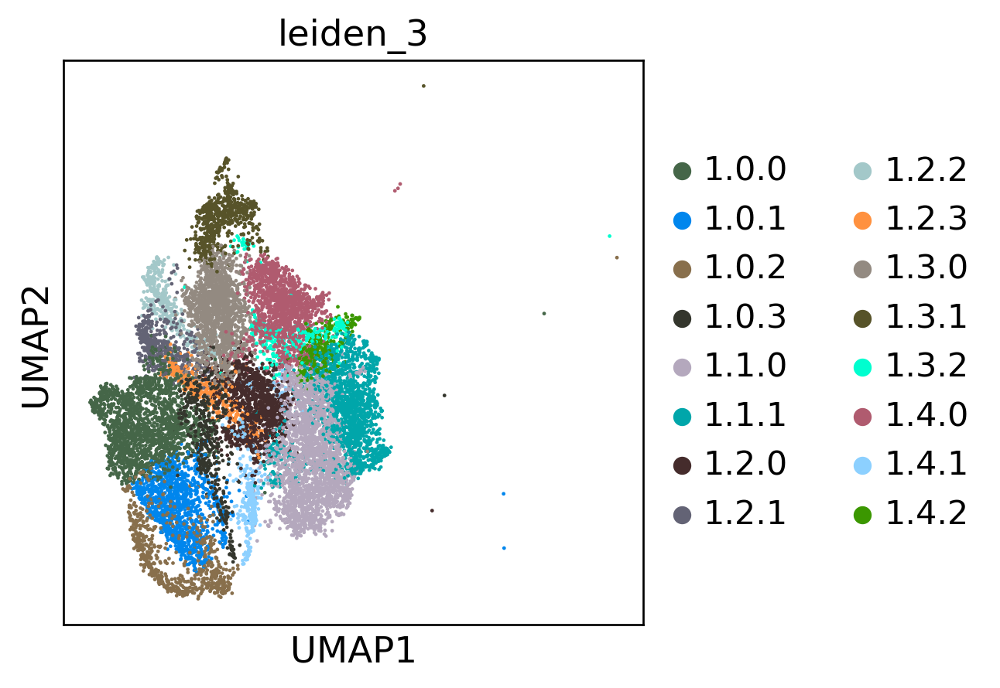

In [9]:
sc.pl.umap(ana_sub, color=['ann_level_1'])
sc.pl.umap(ana_sub, color=['ann_level_2'])
sc.pl.umap(ana_sub, color=['orig.ident'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['leiden_3'])

In [10]:
#dot plot
TE_marker_genes = {
    "general": [ "GATA3","TFAP2A","TFAP2C",],
    "pre-CTBs": [ "CDX2","TEAD4", "POU5F1",],
    "CTBs": [ "ITGA6","FABP5","FGFR1","PEG10","CDH1","DLX6","HIF1A","NR1H3","TFDP2","RXRA","ESRRG",],
    "early_STBs": ["MAFK","TBX20","ATF3",], #"ZNF292",
    "STBs": ["PSG3","PSG6","TCL6","TBX3","CGB2","CGB3","CGB5","CGB7",],
    "EVTs":["HLA-G","CSH1","MMP2","ERBB2","KRT7","ASCL2", "SP100", "IRF9", "SP110", "STAT6", "ZNF462",]
   
}

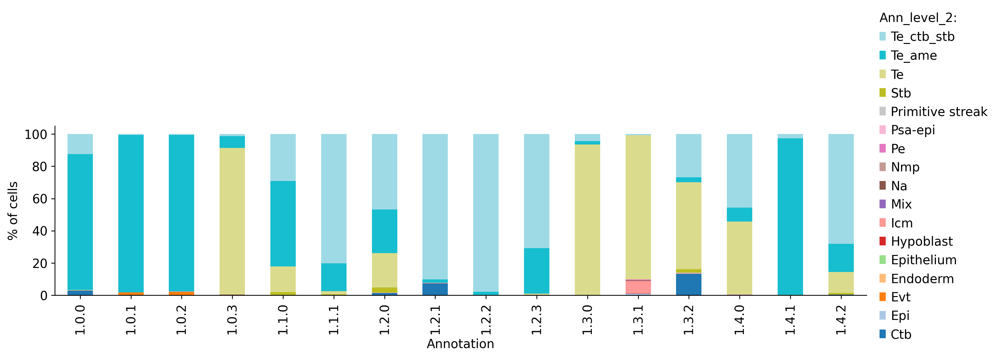

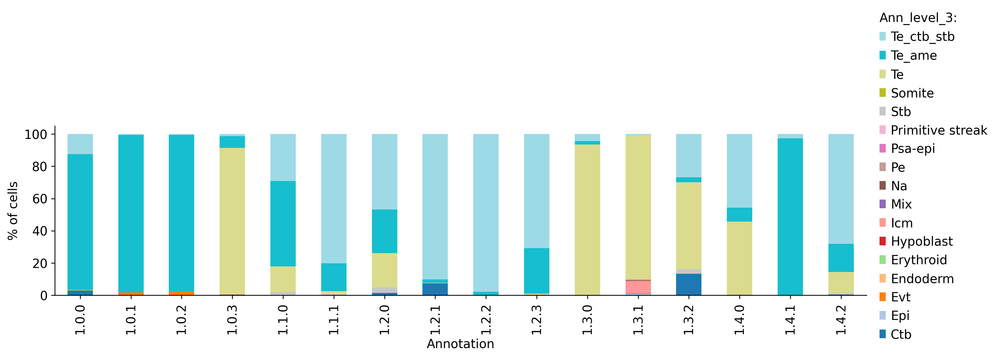

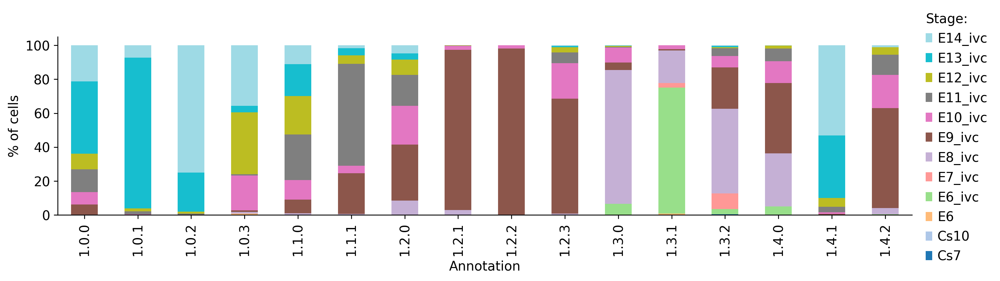

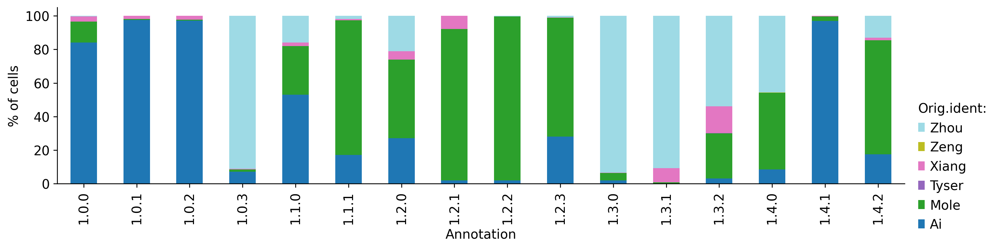

In [11]:
FIGURES = dict()
fz = 12
annos = ['ann_level_2','ann_level_3','stage', 'orig.ident']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['leiden_3'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

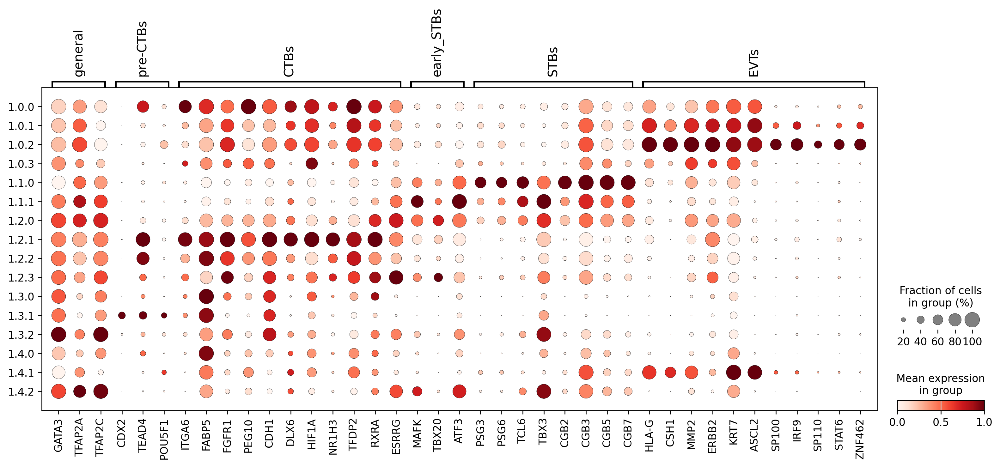

In [12]:
sc.pl.dotplot(ana_sub, TE_marker_genes, groupby="leiden_3", use_raw=False, standard_scale="var")

In [13]:
# Obtain cluster-specific differentially expressed genes
#sc.tl.rank_genes_groups(ana_sub, groupby="leiden_3", method="wilcoxon",use_raw=False)
#sc.tl.dendrogram(ana_sub, groupby="leiden_3")

#sc.pl.rank_genes_groups_dotplot(ana_sub, groupby="leiden_3", standard_scale="var", n_genes=5,use_raw=False, save='marker')

In [14]:
##rename clusters

ana_sub.obs['reanno'] = ana_sub.obs['leiden_3'].cat.add_categories(['TE', 'CTBs', 
                                                                    'STBs_1','STBs_2','STBs_3', 
                                                                  'EVTs_1', 'EVTs_2', 
                      ])

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], [ '1.0.0' ])] = 'EVTs_1'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], [ '1.0.3' ])] = 'EVTs_1'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], [ '1.4.1' ])] = 'EVTs_2'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.0.1'])] = 'EVTs_2'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], [ '1.0.2' ])] = 'EVTs_2'


ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.2.0'])] = 'STBs_1'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.2.3'])] = 'STBs_1'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.1.1'])] = 'STBs_2'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.1.0'])] = 'STBs_3'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.2.1'])] = 'CTBs'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.2.2'])] = 'CTBs'


ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.3.0'])] = 'CTBs'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.3.1' ])] = 'TE'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.3.2'])] = 'CTBs'


ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.4.0'])] = 'CTBs'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['1.4.2'])] = 'CTBs'


ana_sub.obs['reanno'] = ana_sub.obs['reanno'].cat.remove_unused_categories()


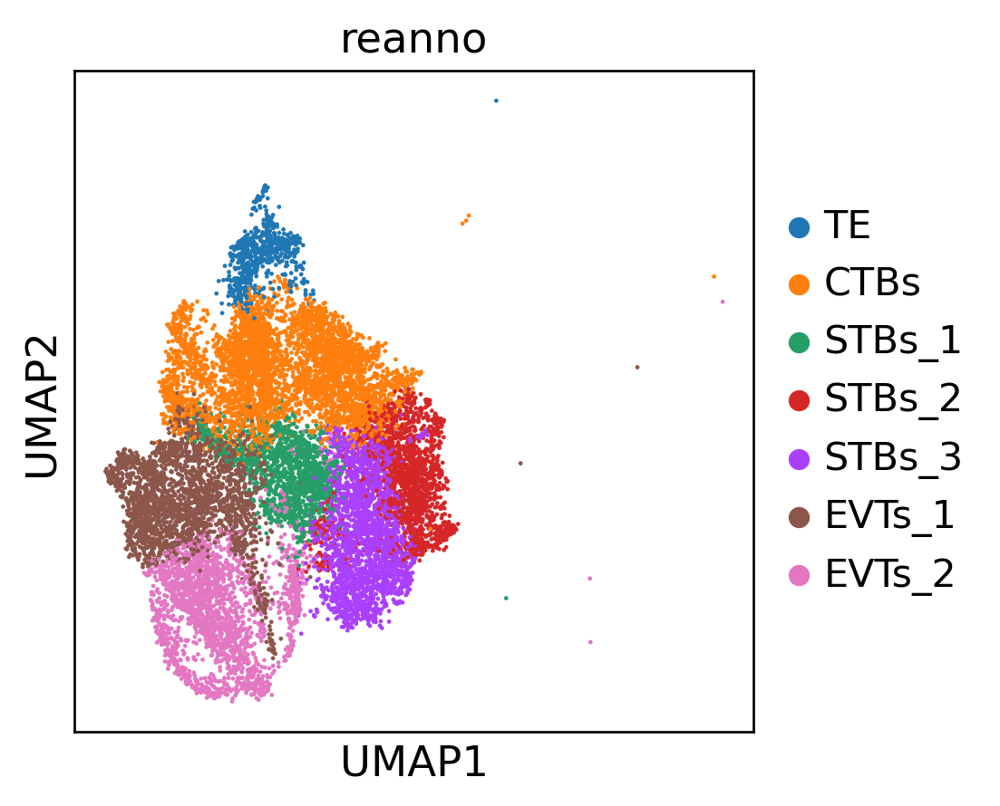

In [15]:
sc.pl.umap(ana_sub, color=['reanno'])

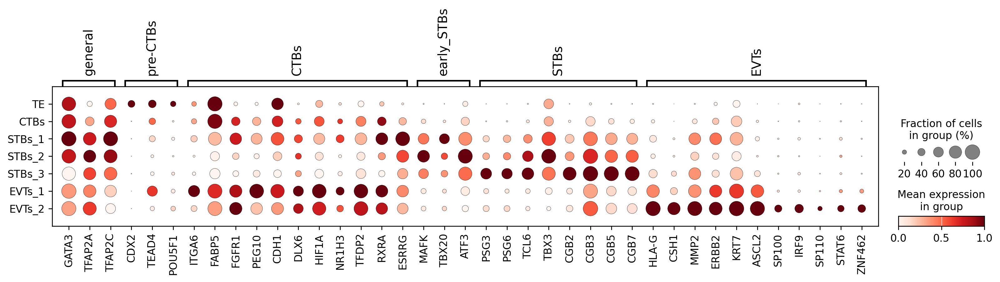

In [16]:
sc.pl.dotplot(ana_sub, TE_marker_genes, groupby="reanno", use_raw=False, standard_scale="var")

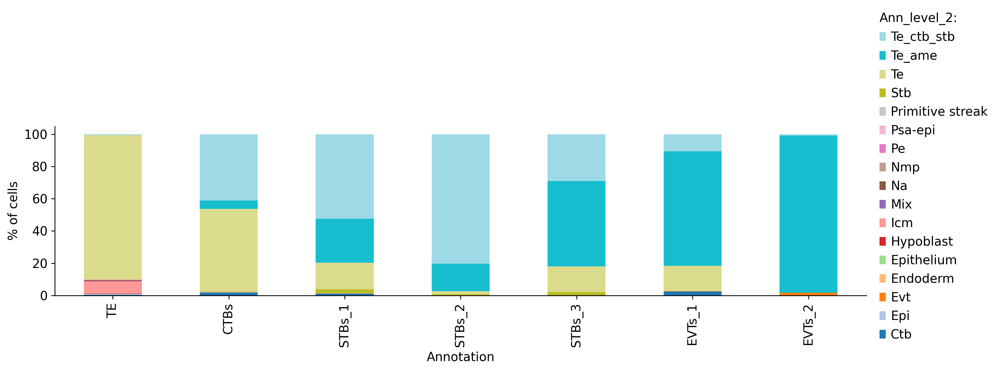

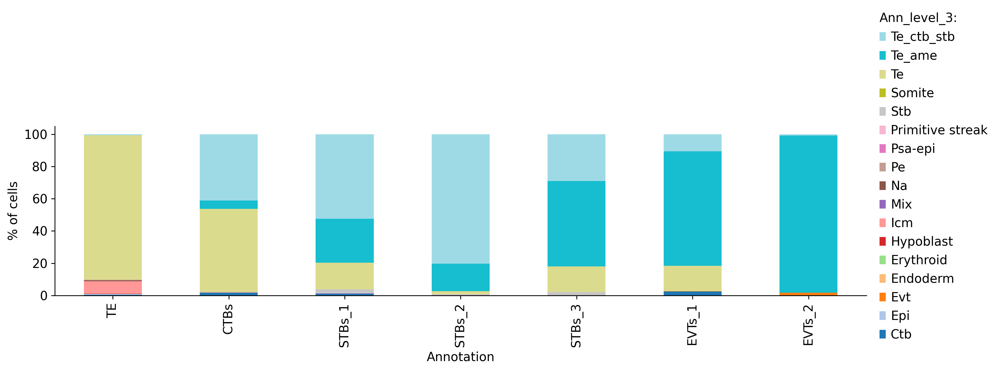

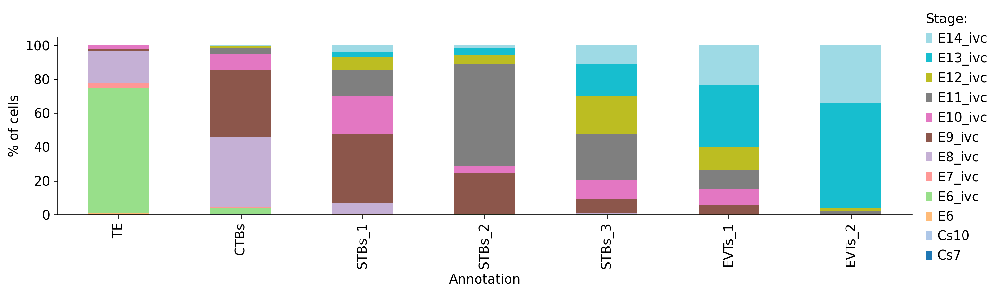

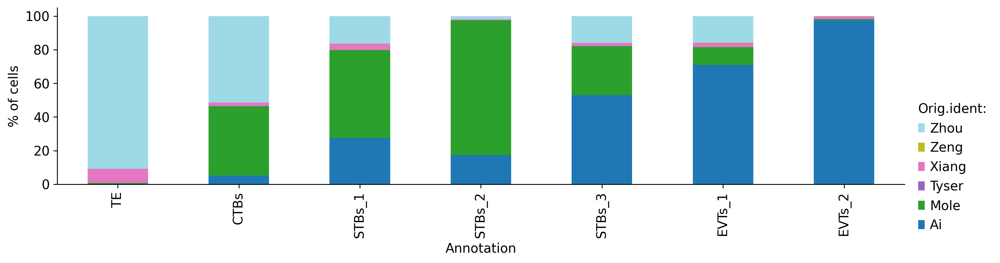

In [17]:
FIGURES = dict()
fz = 12
annos = ['ann_level_2','ann_level_3','stage', 'orig.ident']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['reanno'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [18]:
# Obtain cluster-specific differentially expressed genes
#sc.tl.rank_genes_groups(ana_sub, groupby="reanno", method="wilcoxon",use_raw=False)
#sc.tl.dendrogram(ana_sub, groupby="reanno")

#sc.pl.rank_genes_groups_dotplot(ana_sub, groupby="reanno", standard_scale="var", n_genes=5,use_raw=False, save='marker')

In [19]:
# Step 1: Annotate the cells in cluster_A_cells based on their sub-cluster labels
# The sub-cluster labels are stored in the 'sub_cluster' column of cluster_A_cells.obs
sub_cluster_labels = ana_sub.obs['reanno']

# Step 2: Add these annotations back to the main AnnData object
# Create a new column in the main AnnData object to store the sub-cluster labels for cluster A cells
adata.obs['reanno'] = 'NA'

# Update the main AnnData object with the sub-cluster labels for the cells in cluster A
adata.obs.loc[ana_sub.obs.index, 'reanno'] = sub_cluster_labels

# Optionally, verify the changes
print(adata.obs['reanno'].value_counts())

NA        18752
CTBs       4284
STBs_3     2360
EVTs_2     2189
EVTs_1     2186
STBs_2     1674
STBs_1     1533
TE          621
Name: reanno, dtype: int64

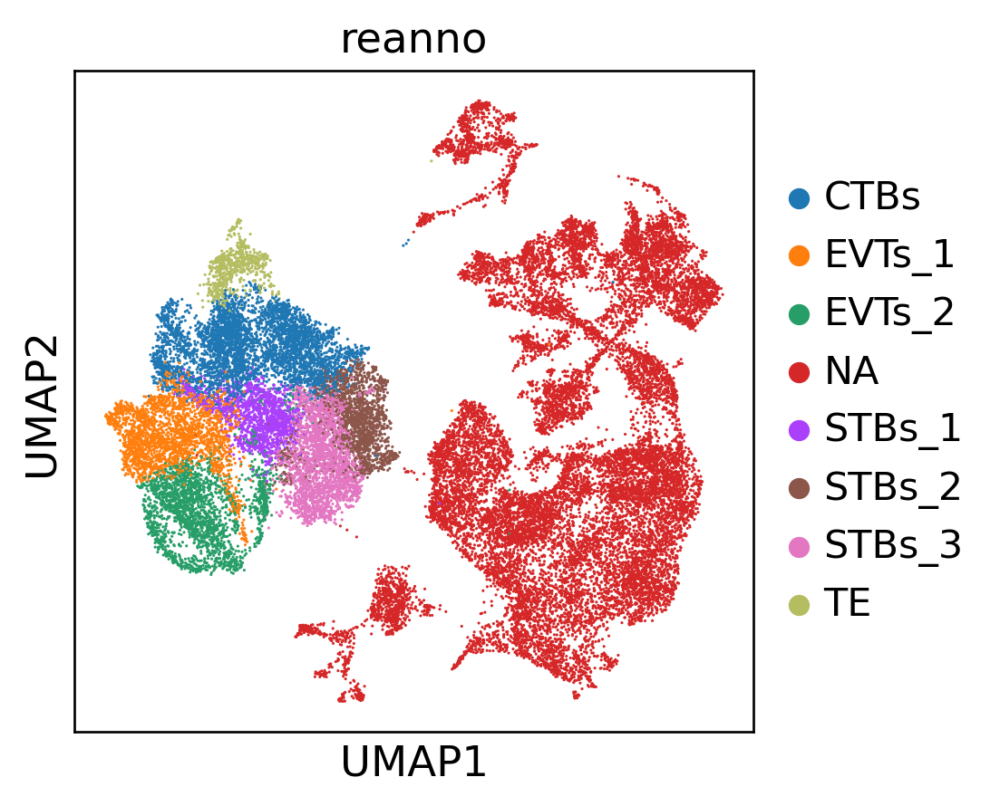

In [20]:
sc.pl.umap(adata, color=['reanno'])

In [21]:
# focusing on blood lineage
ana_sub= adata[adata.obs['ann_level_1'].isin([ 'Hemogenic.Endothelial.Progenitors', ])] 

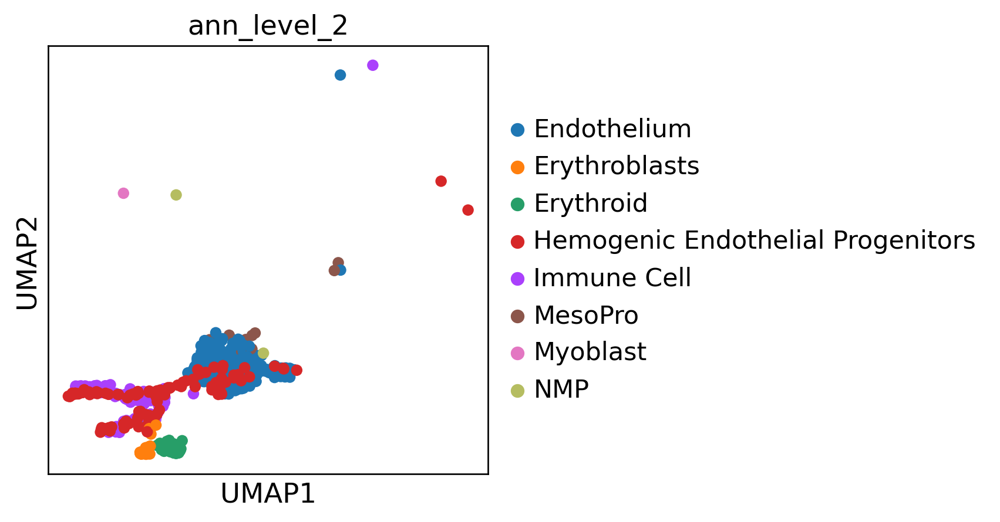

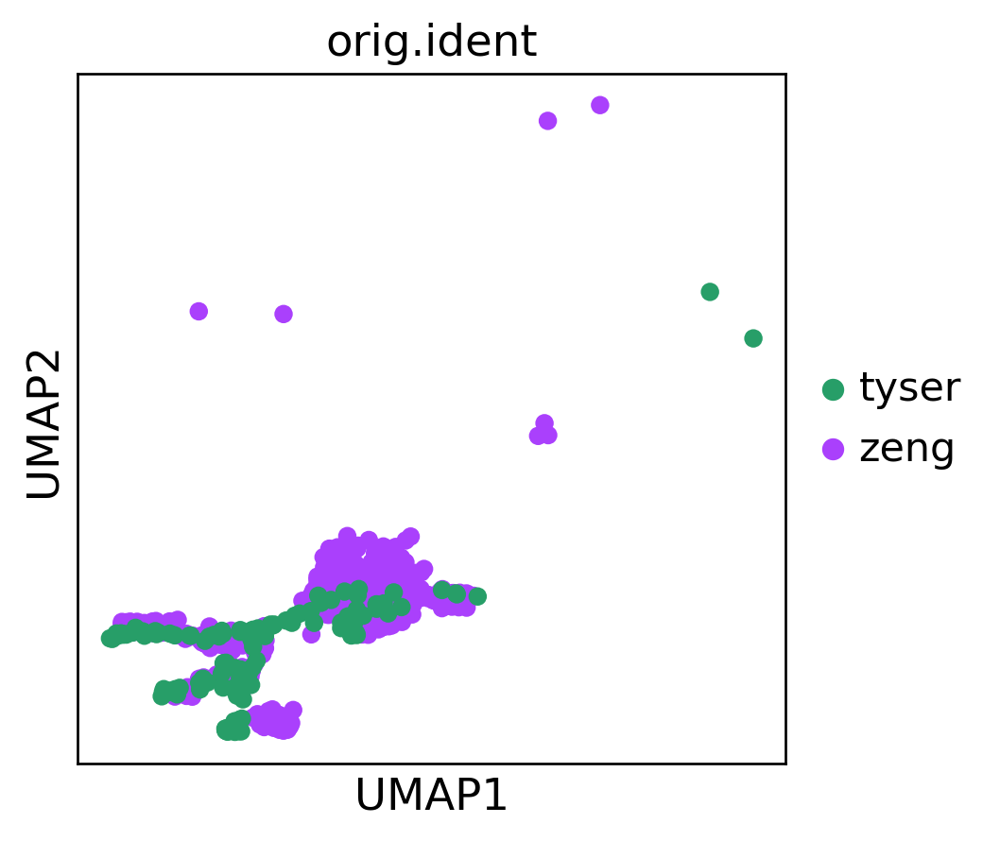

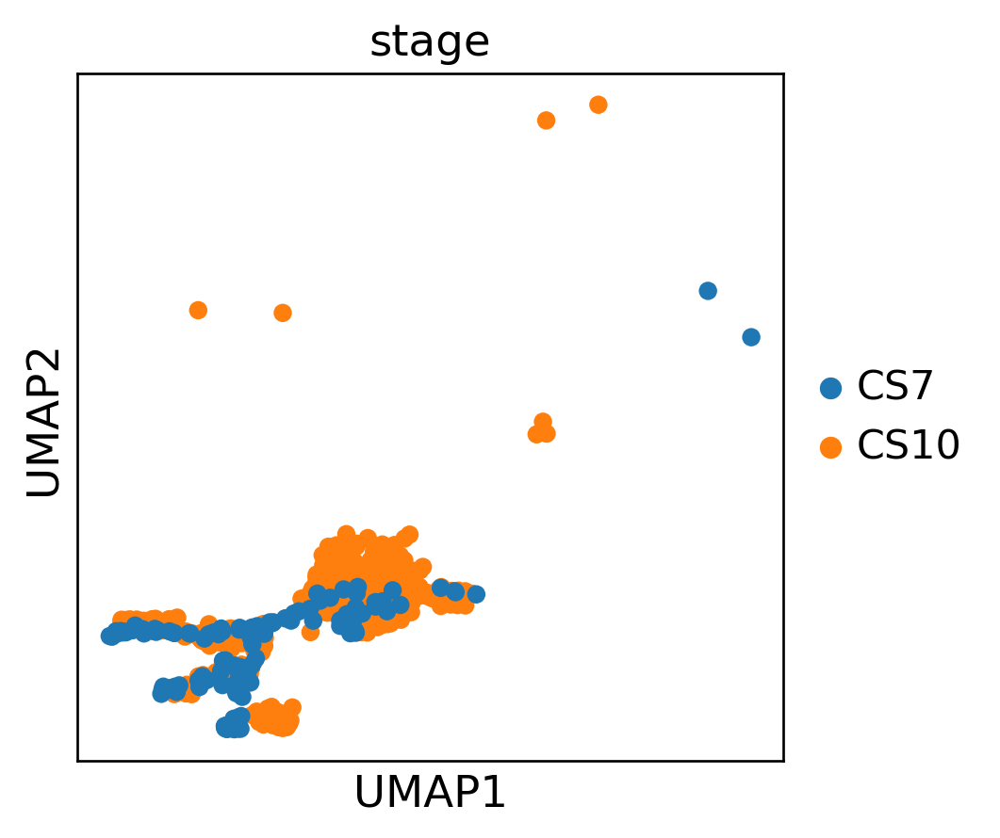

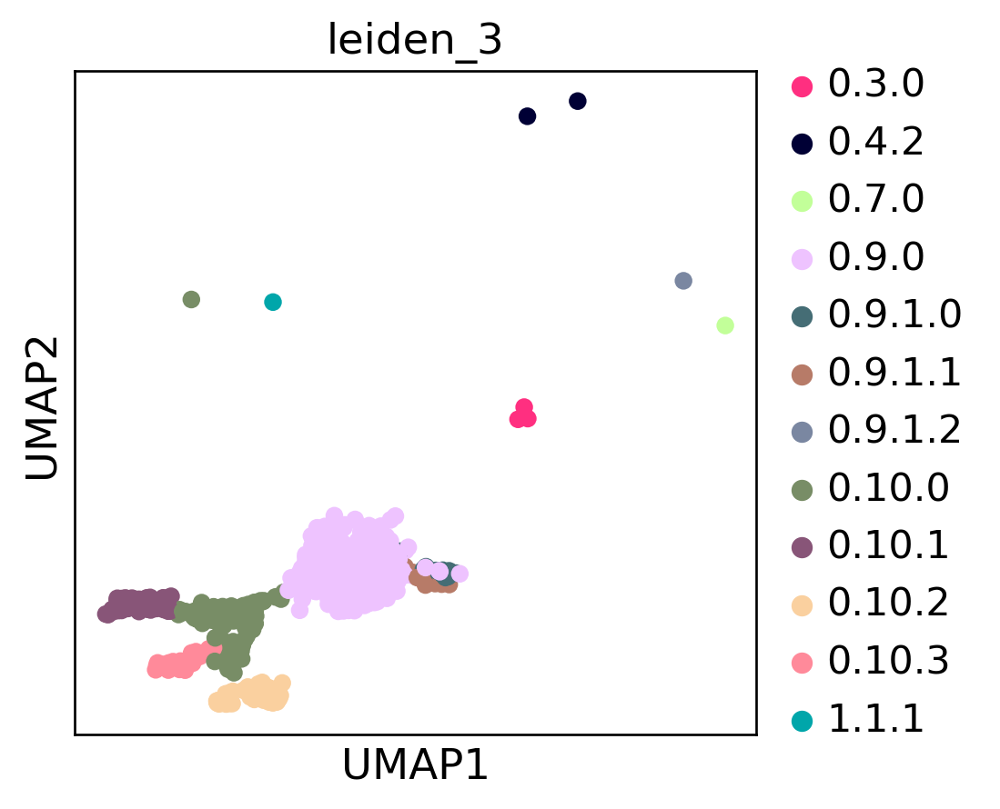

In [22]:
sc.pl.umap(ana_sub, color=['ann_level_2'])
sc.pl.umap(ana_sub, color=['orig.ident'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['leiden_3'])

In [23]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_3'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)

0.9.0      482
0.10.0     126
0.10.1     104
0.10.2      82
0.10.3      40
0.9.1.0     25
0.9.1.1     14
0.3.0        3
0.4.2        2
0.7.0        1
0.9.1.2      1
1.1.1        1
Name: leiden_3, dtype: int64

In [24]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 5].index

# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_3'].isin(clusters_to_keep)]

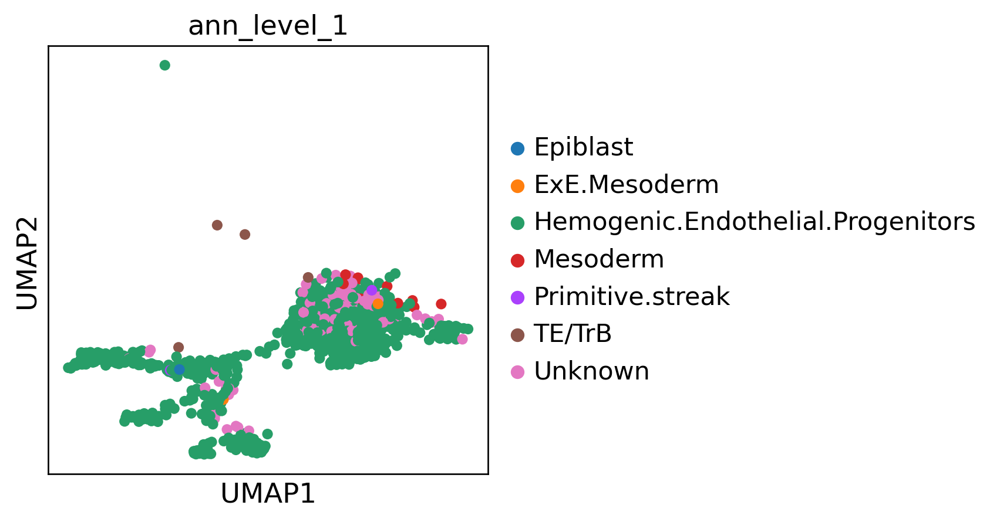

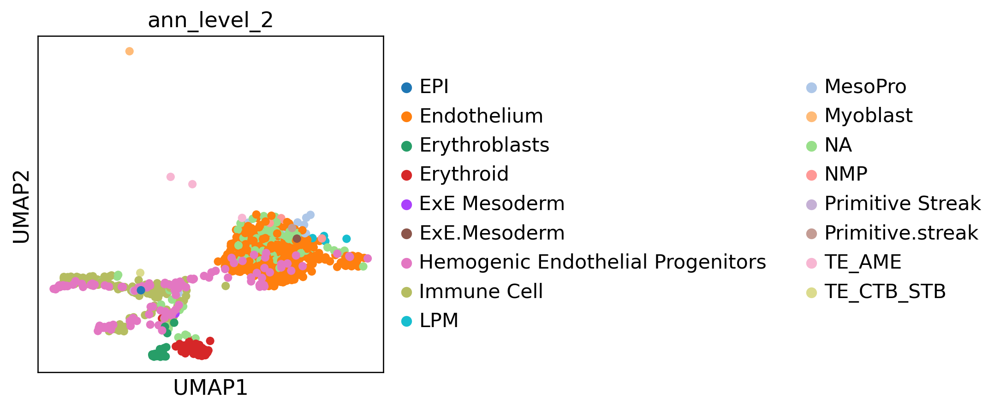

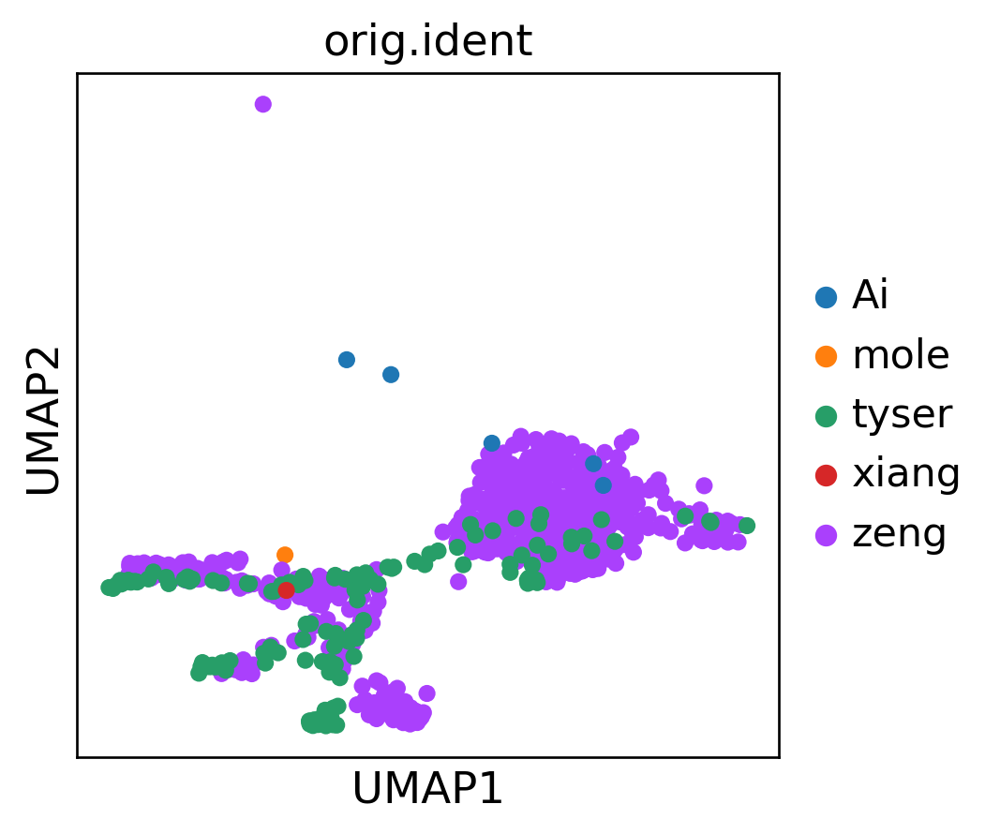

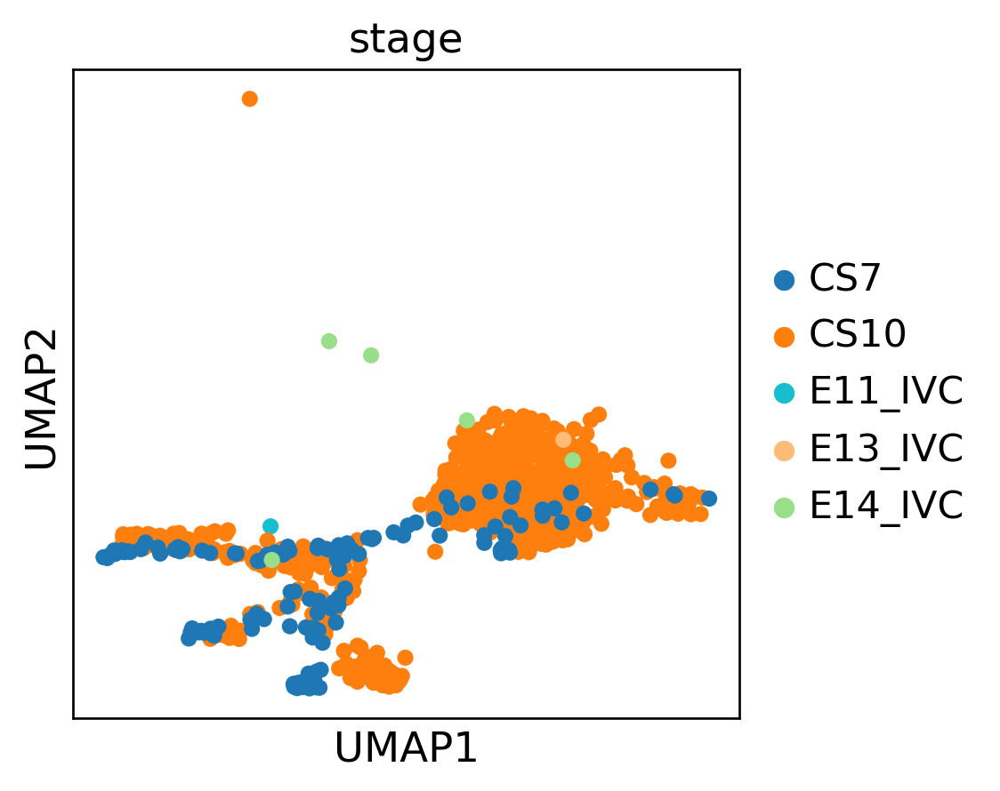

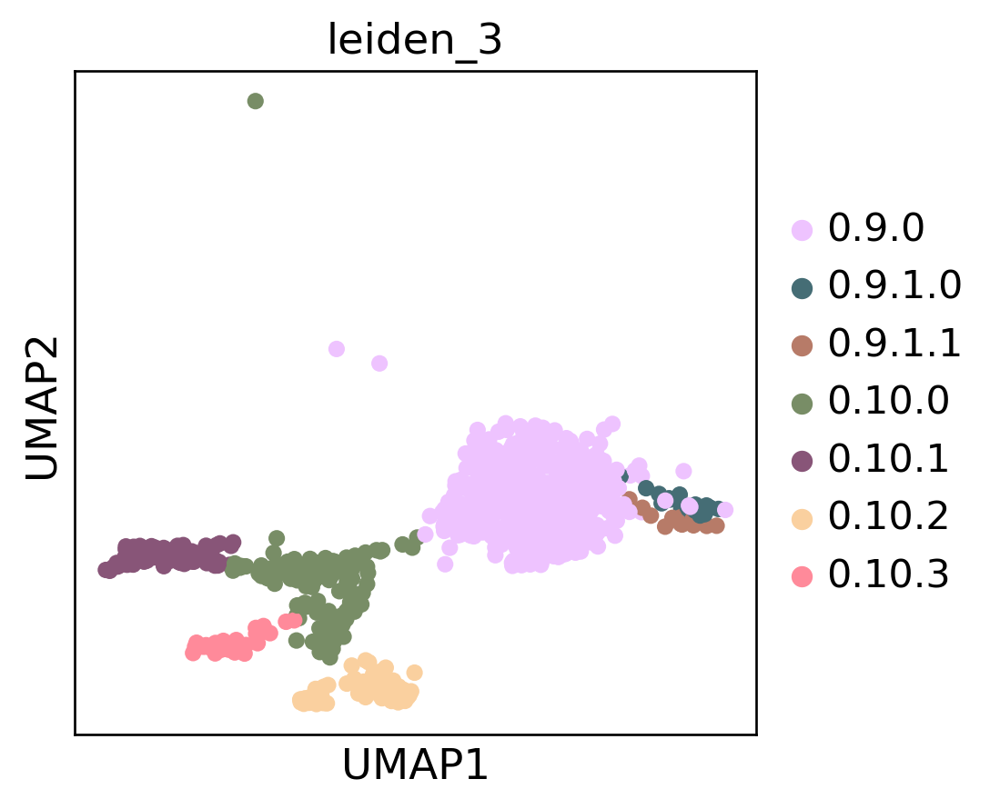

In [25]:
sc.pl.umap(ana_sub, color=['ann_level_1'])
sc.pl.umap(ana_sub, color=['ann_level_2'])
sc.pl.umap(ana_sub, color=['orig.ident'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['leiden_3'])

In [26]:
#dot plot
hemato_marker_genes = {
     "Primitive.streak": ["TBXT", "SP5", "HOXA1", "CDX1", "CDX2","MIXL1", "FST" ],
    "endothelial": [ "PECAM1","CDH5", "KDR", "TEK"],
    "erythroblasts":["HBZ", "HBE1", "GATA1", ],
    "erythroid": [ "GATA1", "KLF1", "GYPB", "HBE1"],
    "megakatyocyte":["GP1BB", "ITGA2B", "NFE2", ],
    "myeloid progenitor": [ "PTPRC", "CSF1R", "LYVE1",],  
   
}

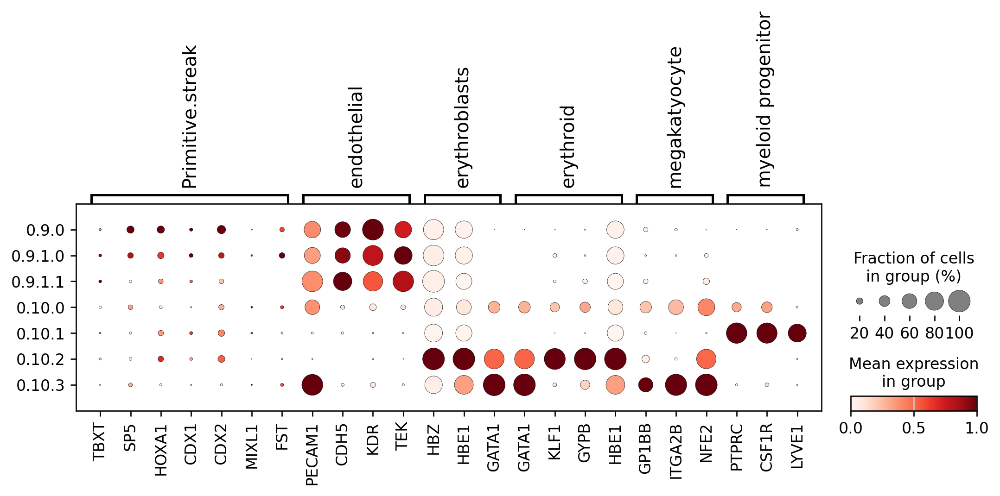

In [27]:
sc.pl.dotplot(ana_sub, hemato_marker_genes, groupby="leiden_3", use_raw=False, standard_scale="var")

In [28]:
# Obtain cluster-specific differentially expressed genes
#sc.tl.rank_genes_groups(ana_sub, groupby="leiden_3", method="wilcoxon",use_raw=False)
#sc.tl.dendrogram(ana_sub, groupby="leiden_3")

#sc.pl.rank_genes_groups_dotplot(ana_sub, groupby="leiden_3", standard_scale="var", n_genes=5,use_raw=False, save='marker')

In [29]:
##rename clusters

ana_sub.obs['reanno'] = ana_sub.obs['leiden_3'].cat.add_categories([
                        'Endothelium', 'Myeloid progenitor', 'Erythroid','Hemogenic endothelial progenitors'])

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.9.0','0.9.1.0','0.9.1.1'])] = 'Endothelium'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.10.2'])] = 'Erythroid'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.10.1'])] = 'Myeloid progenitor'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.10.0','0.10.3'])] = 'Hemogenic endothelial progenitors'


ana_sub.obs['reanno'] = ana_sub.obs['reanno'].cat.remove_unused_categories()

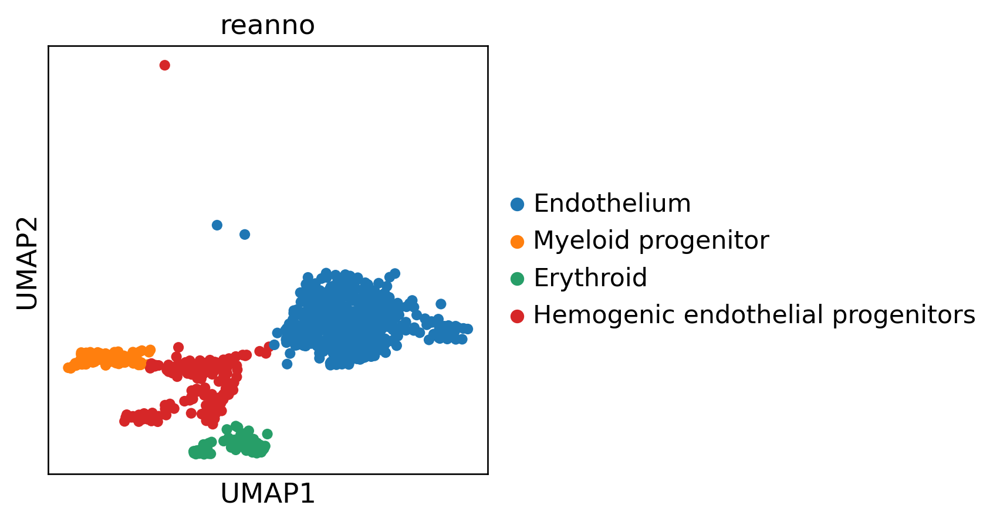

In [30]:
sc.pl.umap(ana_sub, color=['reanno'])

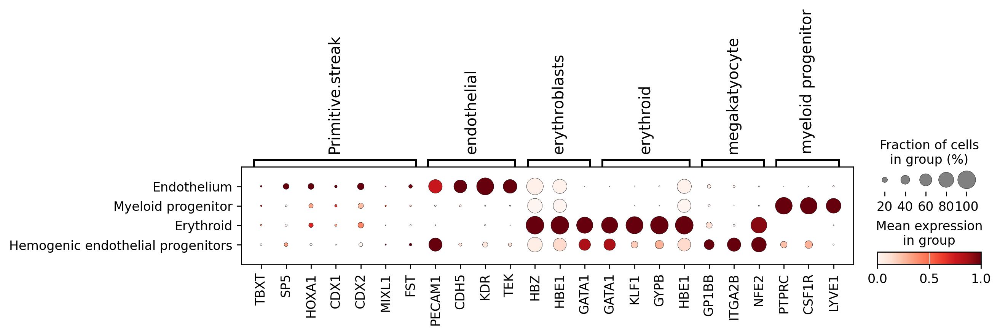

In [31]:
sc.pl.dotplot(ana_sub, hemato_marker_genes, groupby="reanno", use_raw=False, standard_scale="var")

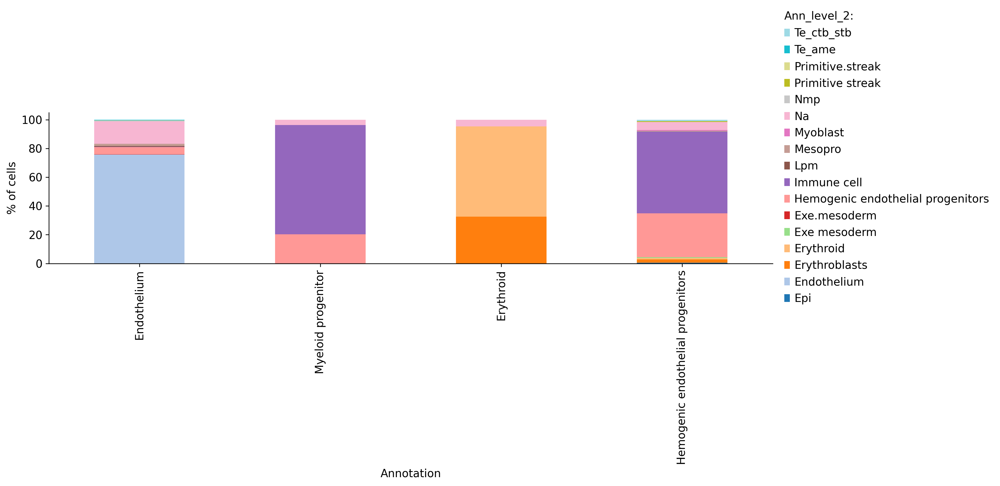

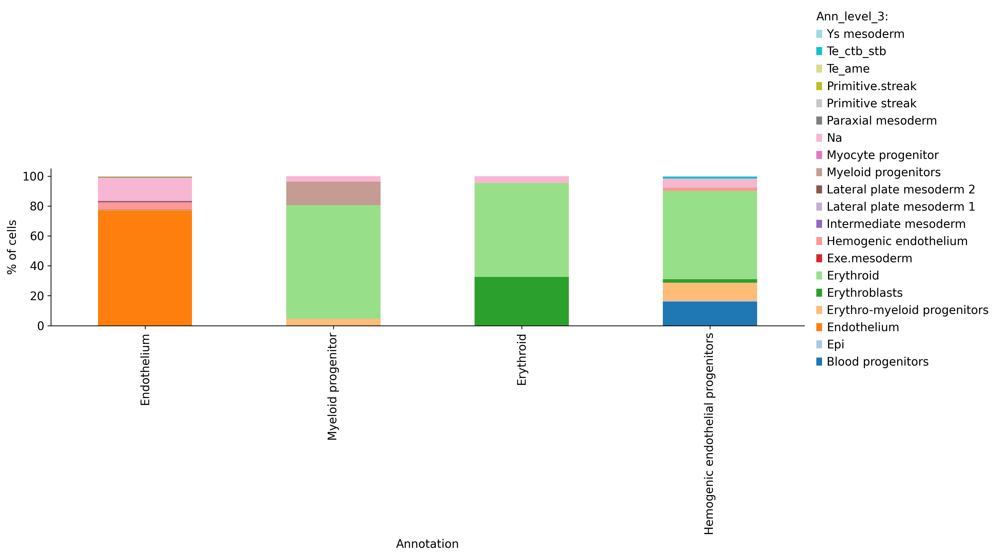

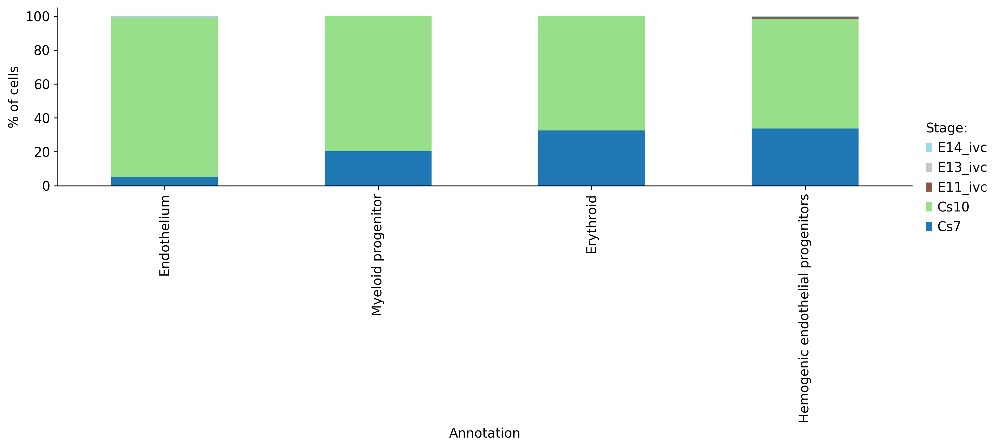

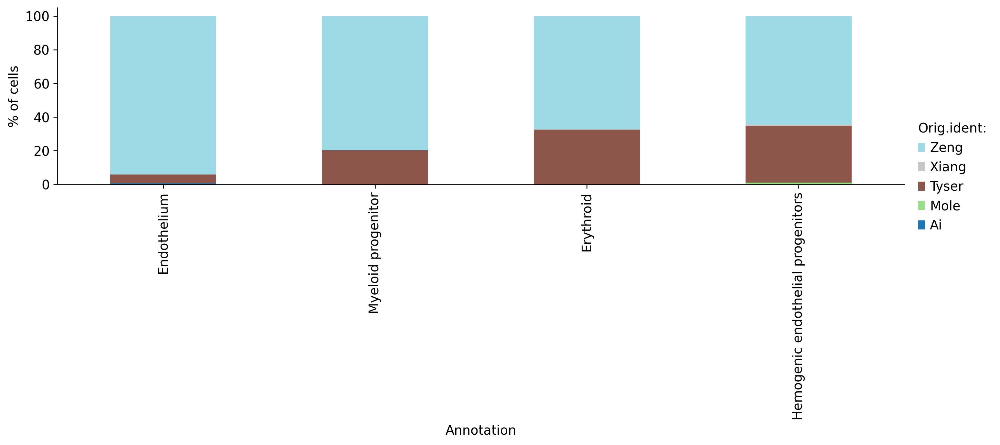

In [32]:
FIGURES = dict()
fz = 12
annos = ['ann_level_2','ann_level_3','stage', 'orig.ident']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['reanno'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [33]:
# Extract the sub-cluster labels
sub_cluster_labels = ana_sub.obs['reanno']

# Combine the categories
combined_categories = pd.CategoricalDtype(categories=list(set(adata.obs['reanno'].cat.categories).union(set(sub_cluster_labels.cat.categories))))

# Convert both columns to the combined categories
adata.obs['reanno'] = adata.obs['reanno'].astype(combined_categories)
sub_cluster_labels = sub_cluster_labels.astype(combined_categories)

# Ensure indices in ann_sub are a subset of those in adata
assert set(ana_sub.obs.index).issubset(set(adata.obs.index)), "Indices in ann_sub are not a subset of those in adata"

# Update 'reanno' in adata with the values from sub_cluster_labels
adata.obs.loc[ana_sub.obs.index, 'reanno'] = sub_cluster_labels.loc[ana_sub.obs.index]

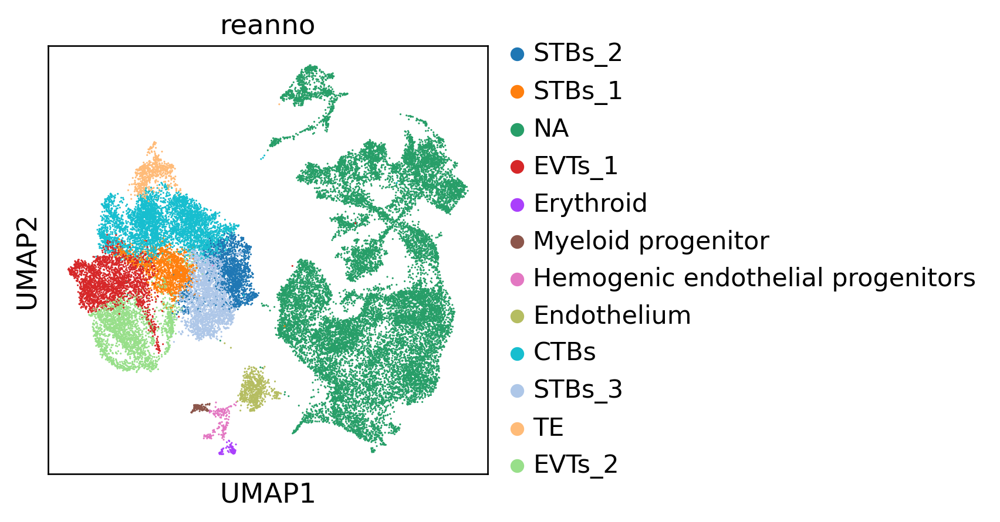

In [34]:
sc.pl.umap(adata, color=['reanno'])

In [35]:
ana_sub= adata[adata.obs['ann_level_1'].isin([ 'Mesoderm'])]

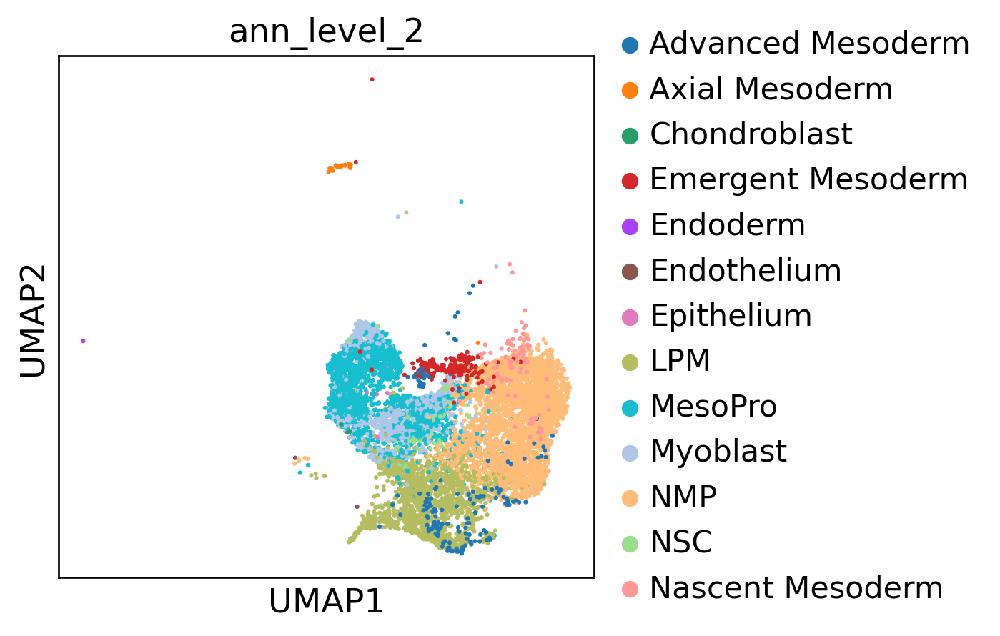

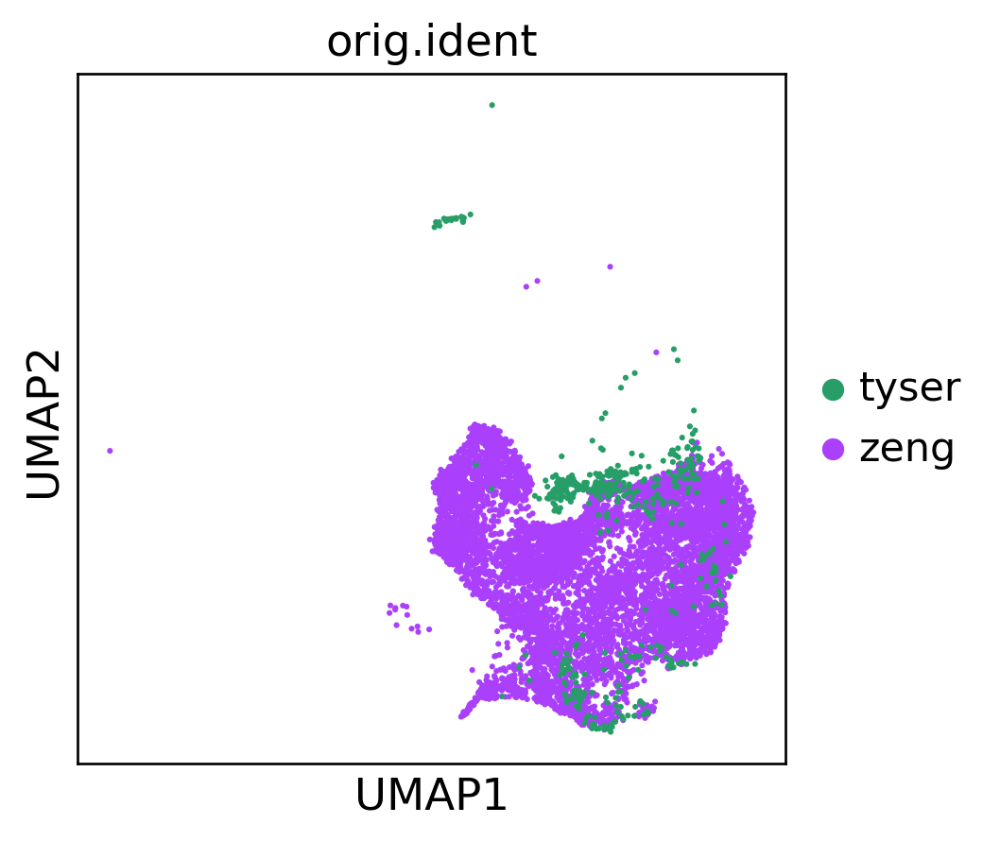

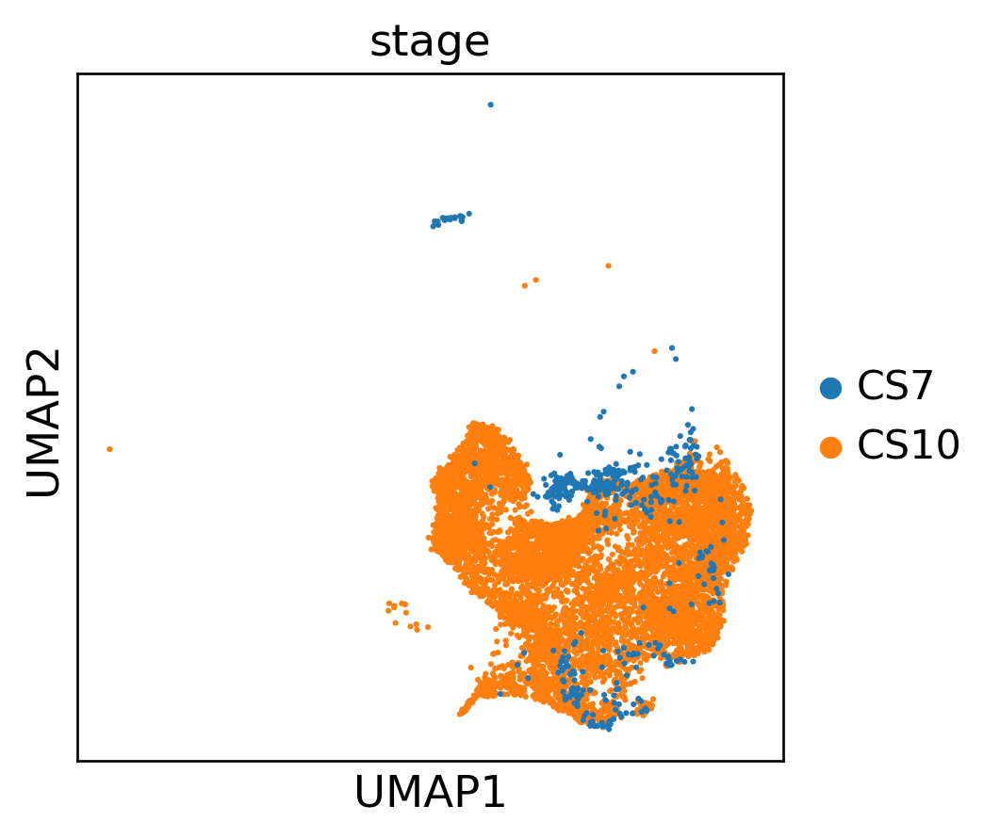

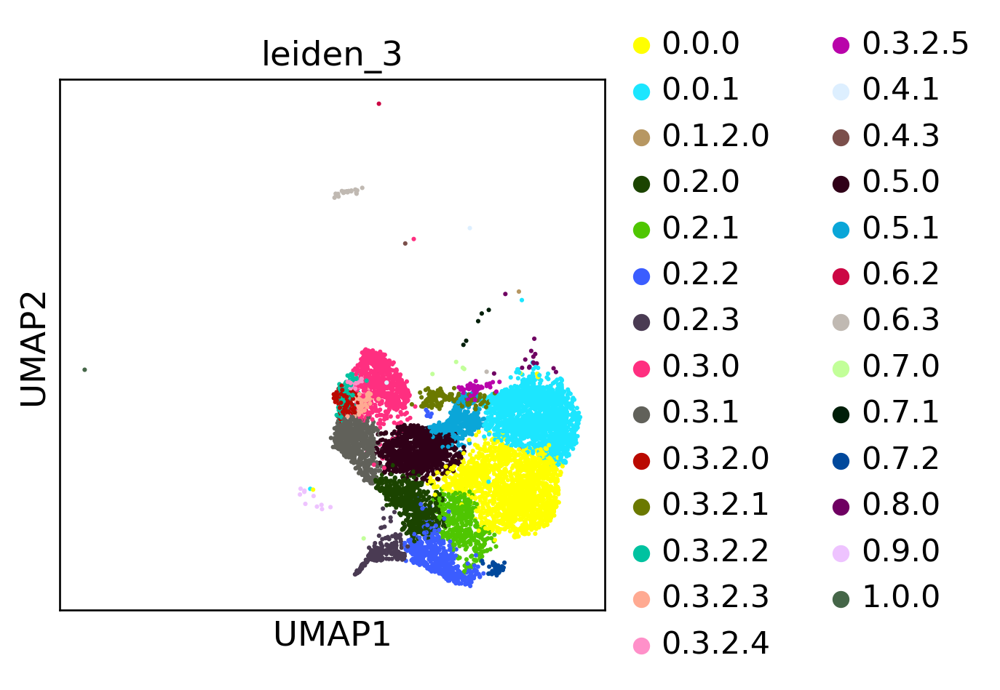

In [36]:
sc.pl.umap(ana_sub, color=['ann_level_2'])
sc.pl.umap(ana_sub, color=['orig.ident'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['leiden_3'])

In [37]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_3'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)

0.0.1      1864
0.0.0      1694
0.5.0      1046
0.3.0       720
0.3.1       626
0.2.0       604
0.2.2       508
0.5.1       456
0.2.1       424
0.2.3       206
0.3.2.0     143
0.3.2.1     140
0.3.2.2     130
0.3.2.3      94
0.7.2        43
0.3.2.4      43
0.3.2.5      42
0.6.3        26
0.8.0        15
0.9.0        10
0.7.0         5
0.7.1         5
0.4.1         2
0.4.3         1
0.6.2         1
0.1.2.0       1
1.0.0         1
Name: leiden_3, dtype: int64

In [38]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 20].index

# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_3'].isin(clusters_to_keep)]


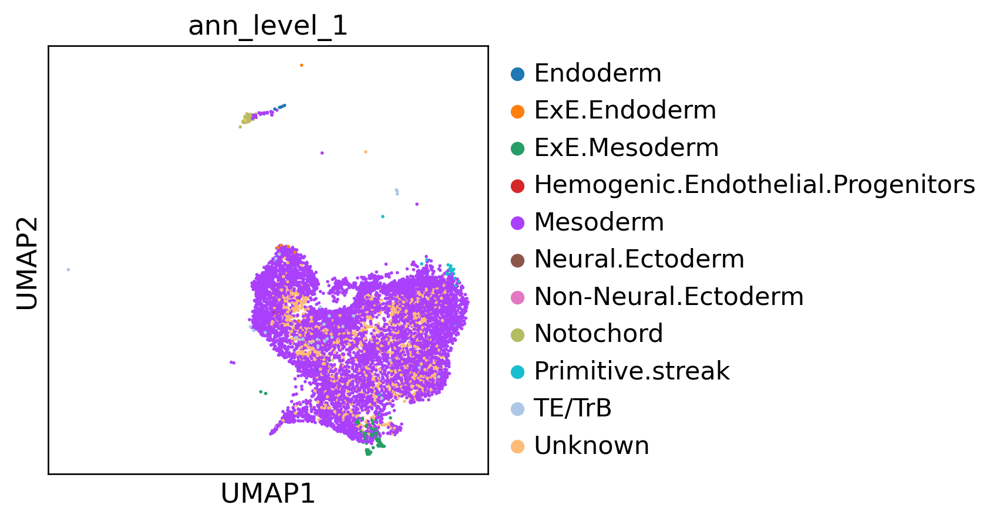

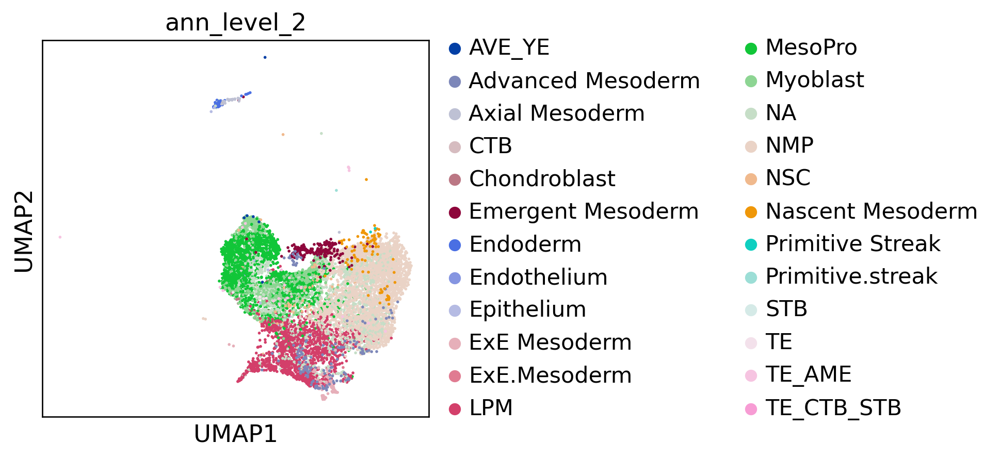

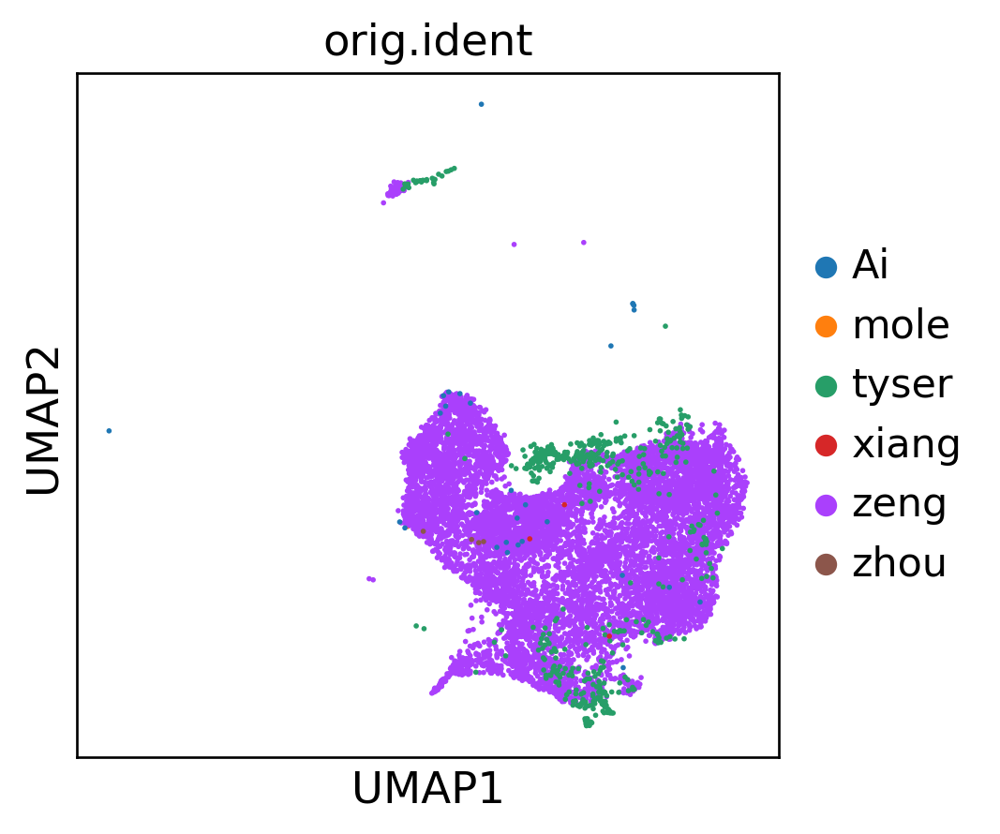

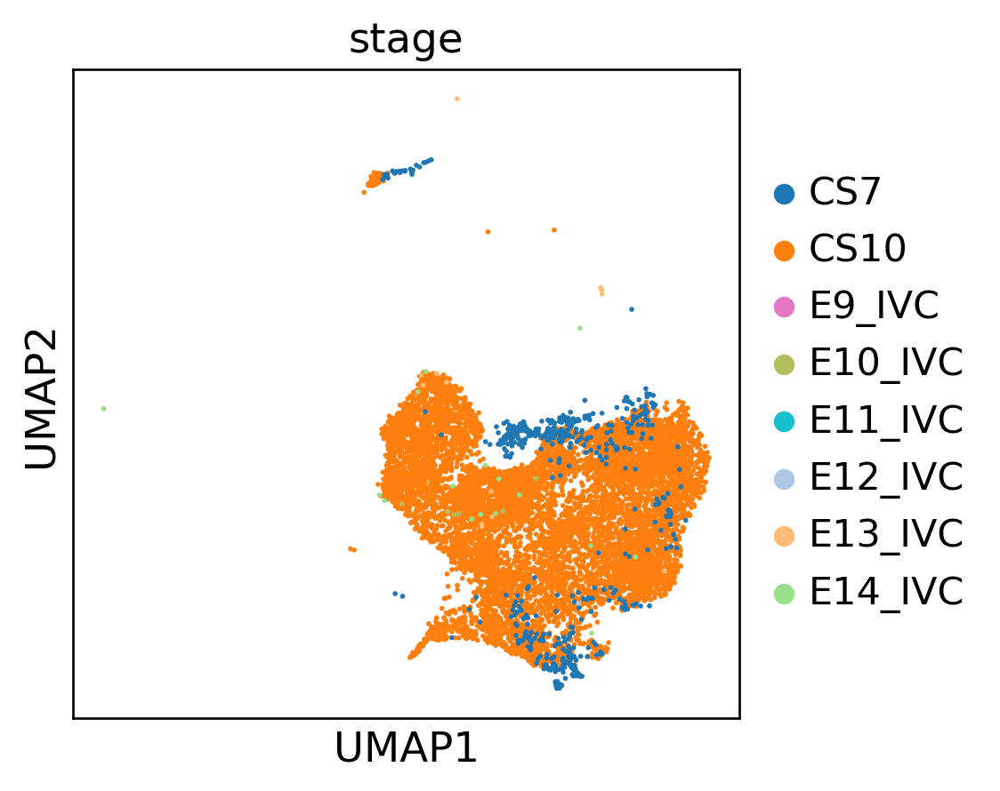

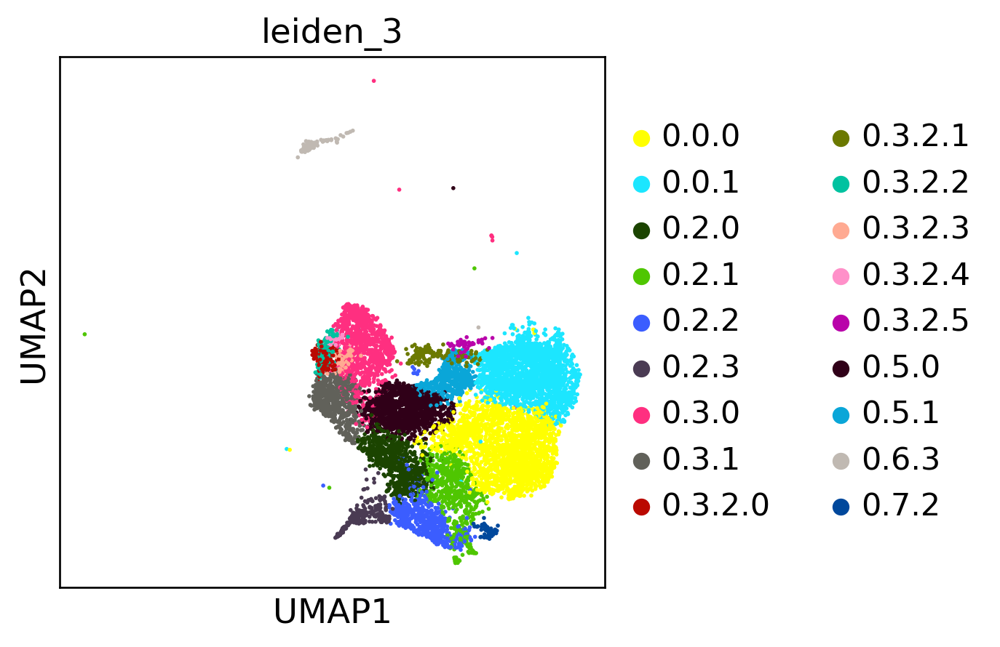

In [39]:
sc.pl.umap(ana_sub, color=['ann_level_1'])
sc.pl.umap(ana_sub, color=['ann_level_2'])
sc.pl.umap(ana_sub, color=['orig.ident'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['leiden_3'])

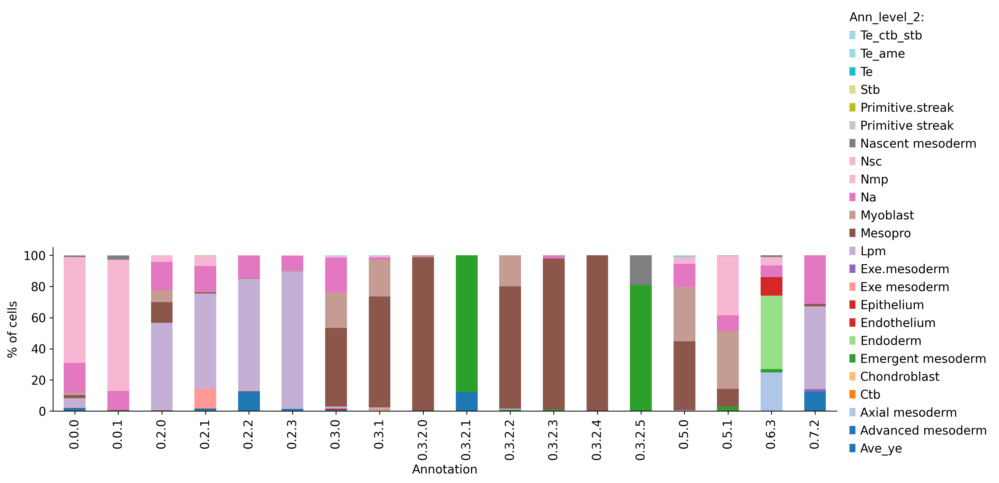

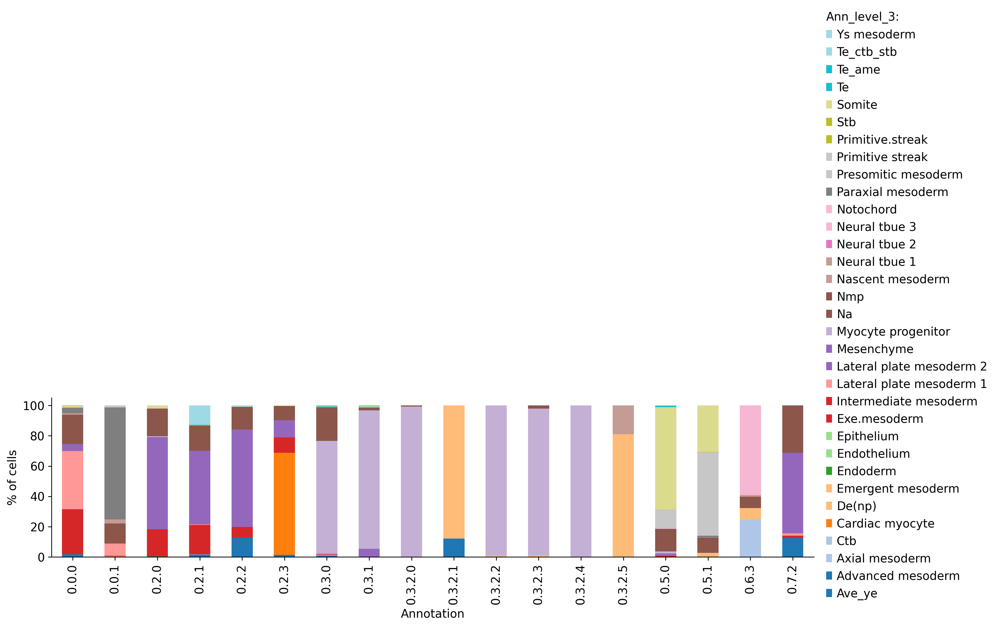

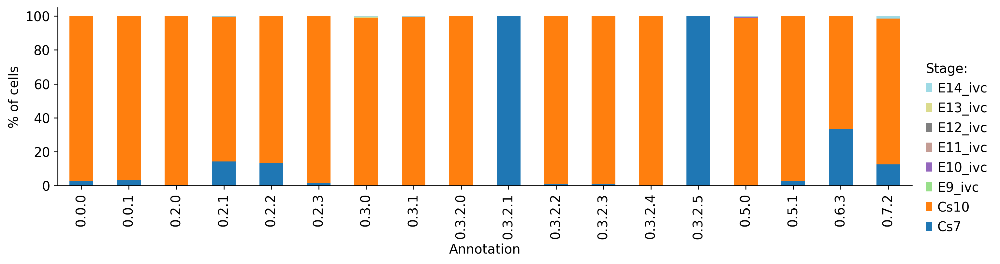

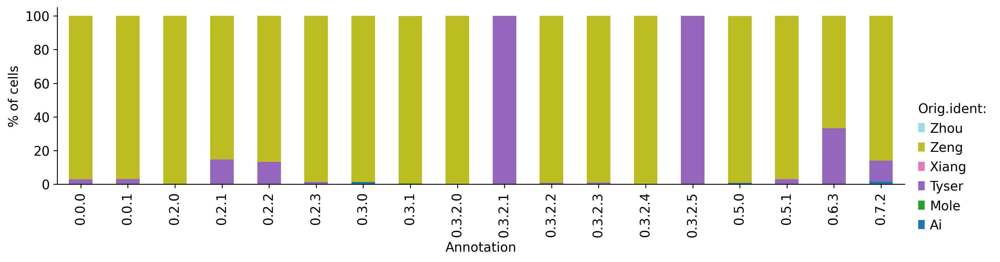

In [40]:
FIGURES = dict()
fz = 12
annos = ['ann_level_2','ann_level_3','stage', 'orig.ident']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['leiden_3'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [41]:
#dot plot
meso_marker_genes = {
    "Primitive.streak": ["TBXT", "SP5", "HOXA1", "CDX1", "CDX2","MIXL1", "FST" ],
    "meso.general":["PDGFRA", "MESP1",  "GATA6",],
    "emergent.meso": ["LEFTY2", "OTX2","LHX1" ],
    "Nascent.meso":["TBX6","MEIS1",],
    "Notochord":["CHRD", "NOTO"],
    "Axial.meso": ["DCLK1", "ESRG",],
    "Paraxial.meso":["MSGN1", "HES7", ],
    "Caudal.meso":[ "SFRP2", "HOXA1"],
    "Rostral.meso":[ "PITX2", "IRX3"],
    "Intermediate.meso":["PAX8", "OSR1", "EYA1", ],
    "lateral plate.meso":["HAND1", "MYL7","HAPLN1", "BMP4", "FOXF1", "SNAI2" ],
    "ExE mesoderm progenitor":["LUM", "POSTN", "IGF2", "ANXA1"],
   "YS mesoderm":[ "CREB3L1", "NR2F2", "PLAGL1", "ANXA1", "NID2"],
    #"Allantoic stalk":["CDX1", "CDX2", "FGF9", "FGF18", "SHH", "WNT5B", "MDK"],

   # "myocyte": ["PITX2", "TGFBI"],
    "cardio myocyte":["TNNT2", "MYL7", "TNNI1", "MYH10"],
    "somite":["ALDH1A2",  "MEOX2", "MEOX1",  "FOXC2"],

     "ecto.epi.general":[ "POU5F1", "DNMT3B","EPCAM","CLDN6"],
    #"radial glial":["CDH2", "NES",  "FABP7", "VIM"],
     "neural.ecto":["SOX3", "PAX6", "TTYH1"],
     "neural crest":["SOX10", "MPZ", "TFAP2A"],
     "neural tube":["SOX2", "OTX2", "RFX4"],
    "proliferating.meso": ["MKI67", "TOP2A", "CDK1" ],
    #"Amniotic.ecto": ["TFAP2C", "GATA3", "MSX2",  "WNT6","DLX5",],
        "EXM": ["DEPDC1B", "FBN2", "FRMD4B", "HAND2", "OAF"],
    "Allantois": ["COL6A2", "COL6A1",  "PCOLCE", "VCAN"],
   
}

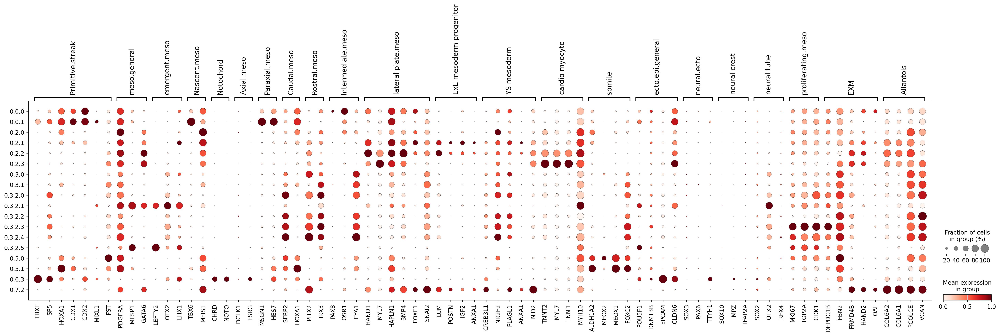

In [42]:
sc.pl.dotplot(ana_sub, meso_marker_genes, groupby="leiden_3", use_raw=False, standard_scale="var")

In [43]:
# Obtain cluster-specific differentially expressed genes
#sc.tl.rank_genes_groups(ana_sub, groupby="leiden_3", method="wilcoxon",use_raw=False)
#sc.tl.dendrogram(ana_sub, groupby="leiden_3")

#sc.pl.rank_genes_groups_dotplot(ana_sub, groupby="leiden_3", standard_scale="var", n_genes=5,use_raw=False, save='marker')

In [44]:
##rename clusters

ana_sub.obs['reanno'] = ana_sub.obs['leiden_3'].cat.add_categories(['Notochord','Paraxial mesoderm','Intermediate mesoderm',
                                                                    'Emergent mesoderm', 'Lateral plate mesoderm_1','Lateral plate mesoderm_2',
                                                                   'Lateral plate mesoderm_3','pre-somatic mesoderm','Somite',
                                                                    'Rostral mesoderm_1','Rostral mesoderm_2',
                                                                   'Rostral mesoderm_3', 'Cardiac myocyte',])


ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.0.0'])] = 'Intermediate mesoderm'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.0.1'])] = 'Paraxial mesoderm'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.5.1'])] = 'pre-somatic mesoderm'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.5.0'])] = 'Somite'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.2.0'])] = 'Lateral plate mesoderm_1'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.2.1'])] = 'Lateral plate mesoderm_2'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.2.2'])] = 'Lateral plate mesoderm_2'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.7.2'])] = 'Lateral plate mesoderm_3'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.2.3'])] = 'Cardiac myocyte'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.6.3'])] = 'Notochord'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.3.2.1','0.3.2.5'])] = 'Emergent mesoderm'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.3.2.0','0.3.2.2','0.3.2.3','0.3.2.4',])] = 'Rostral mesoderm_3'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.3.0'])] = 'Rostral mesoderm_1'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.3.1'])] = 'Rostral mesoderm_2'




ana_sub.obs['reanno'] = ana_sub.obs['reanno'].cat.remove_unused_categories()


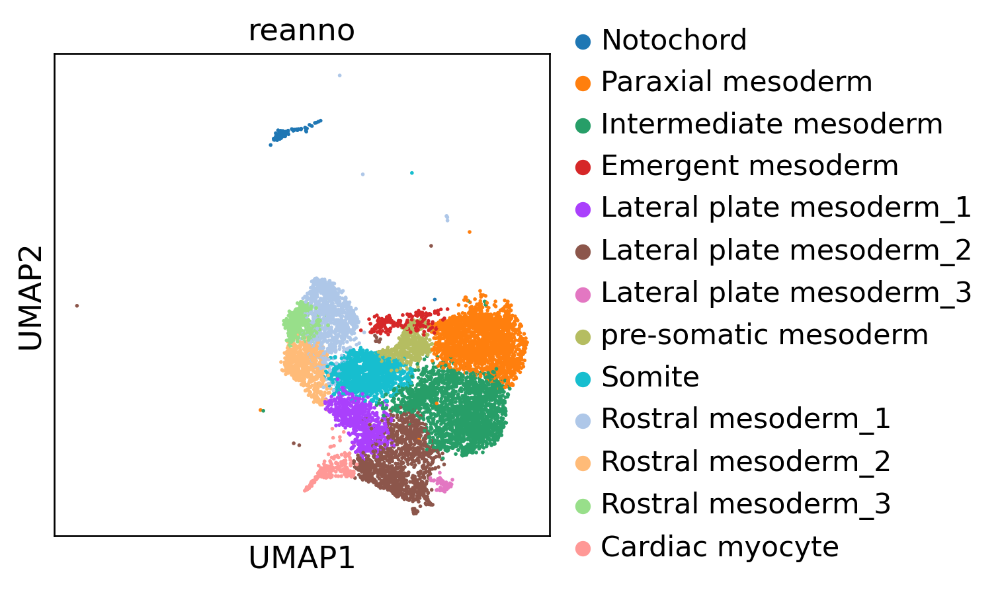

In [45]:
sc.pl.umap(ana_sub, color=['reanno'])

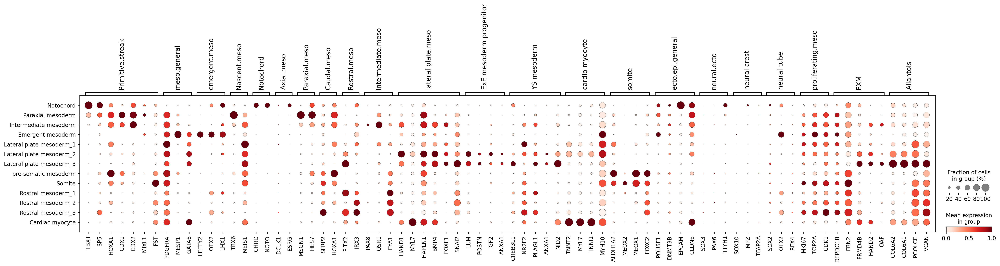

In [46]:
sc.pl.dotplot(ana_sub, meso_marker_genes, groupby="reanno", use_raw=False, standard_scale="var")

In [47]:
# Obtain cluster-specific differentially expressed genes
#sc.tl.rank_genes_groups(ana_sub, groupby="reanno", method="wilcoxon",use_raw=False)
#sc.tl.dendrogram(ana_sub, groupby="reanno")

#sc.pl.rank_genes_groups_dotplot(ana_sub, groupby="reanno", standard_scale="var", n_genes=5,use_raw=False, save='marker')

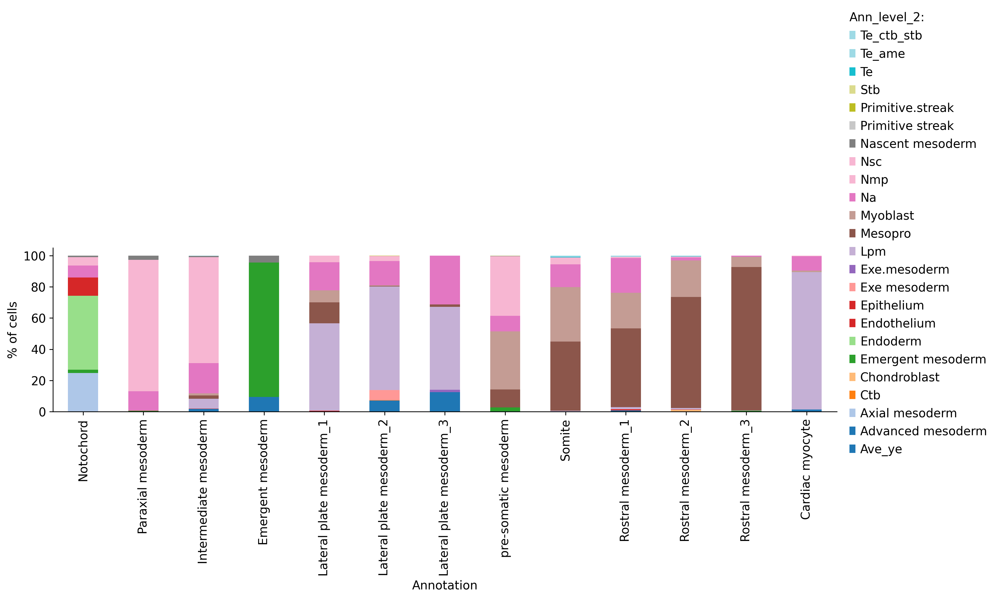

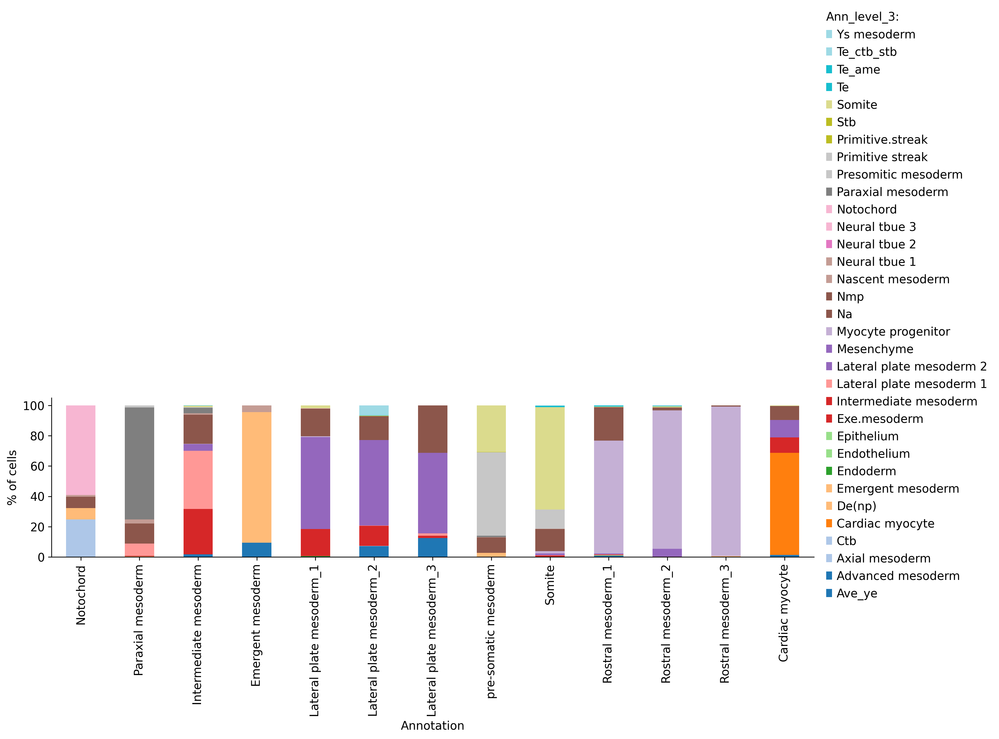

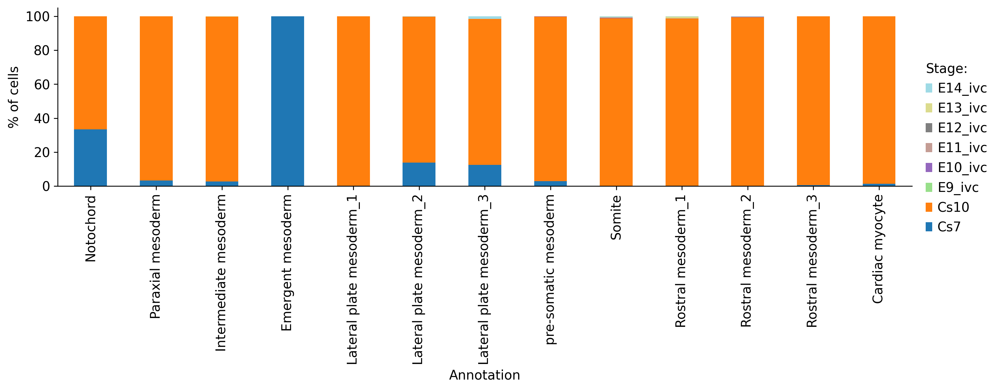

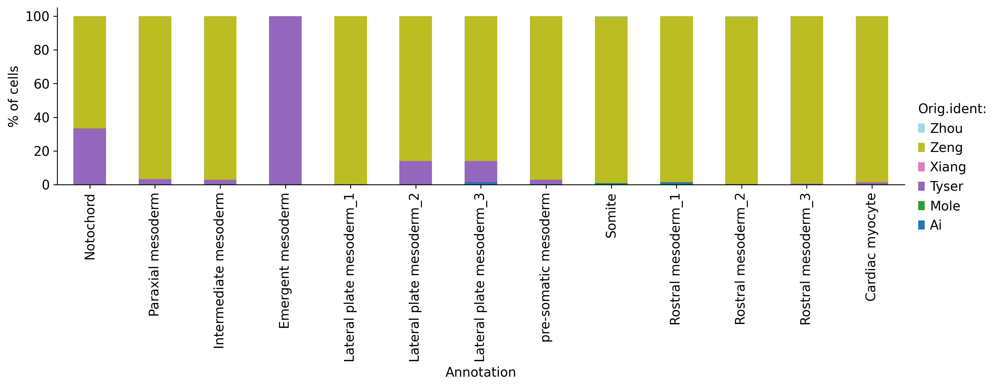

In [48]:
FIGURES = dict()
fz = 12
annos = ['ann_level_2','ann_level_3','stage', 'orig.ident']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['reanno'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [49]:
# Extract the sub-cluster labels
sub_cluster_labels = ana_sub.obs['reanno']

# Combine the categories
combined_categories = pd.CategoricalDtype(categories=list(set(adata.obs['reanno'].cat.categories).union(set(sub_cluster_labels.cat.categories))))

# Convert both columns to the combined categories
adata.obs['reanno'] = adata.obs['reanno'].astype(combined_categories)
sub_cluster_labels = sub_cluster_labels.astype(combined_categories)

# Ensure indices in ann_sub are a subset of those in adata
assert set(ana_sub.obs.index).issubset(set(adata.obs.index)), "Indices in ann_sub are not a subset of those in adata"

# Update 'reanno' in adata with the values from sub_cluster_labels
adata.obs.loc[ana_sub.obs.index, 'reanno'] = sub_cluster_labels.loc[ana_sub.obs.index]

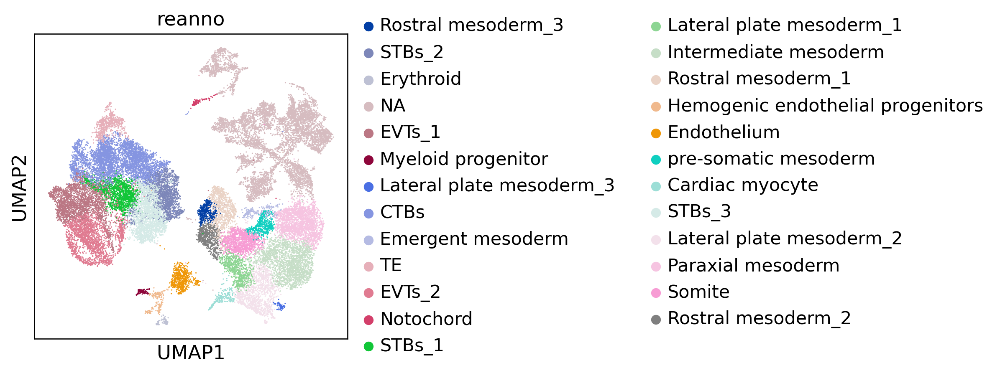

In [50]:
sc.pl.umap(adata, color=['reanno'])

In [51]:
# focusing on Endoderm lineage
ana_sub= adata[adata.obs['ann_level_1'].isin([ 'Endoderm','Hypoblast', 'ExE.Endoderm'])]

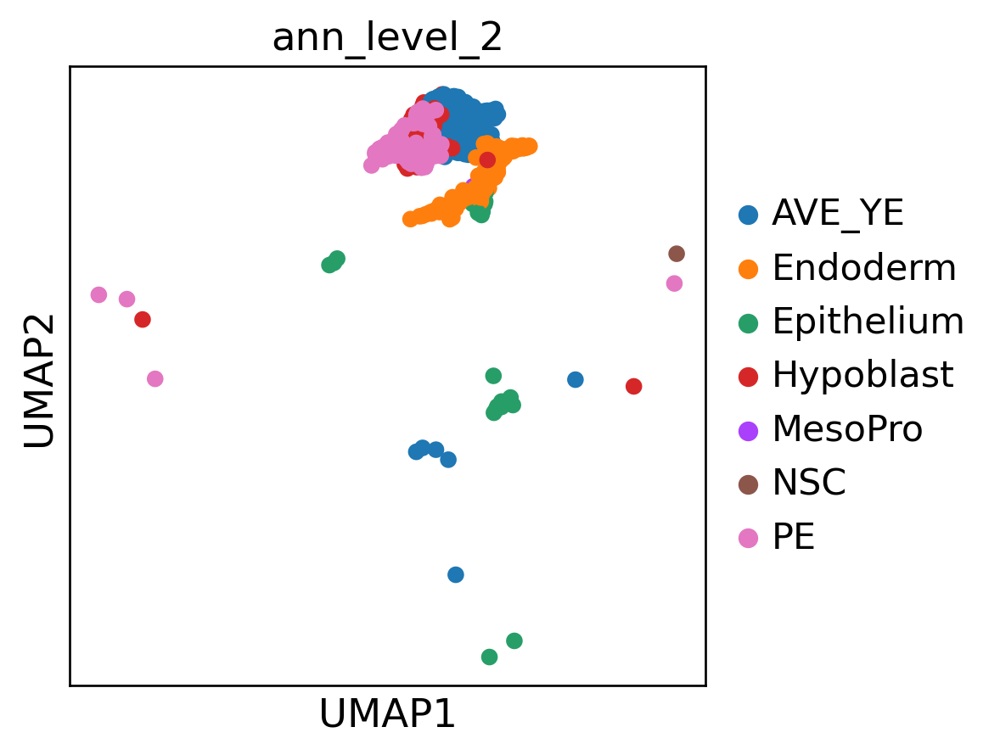

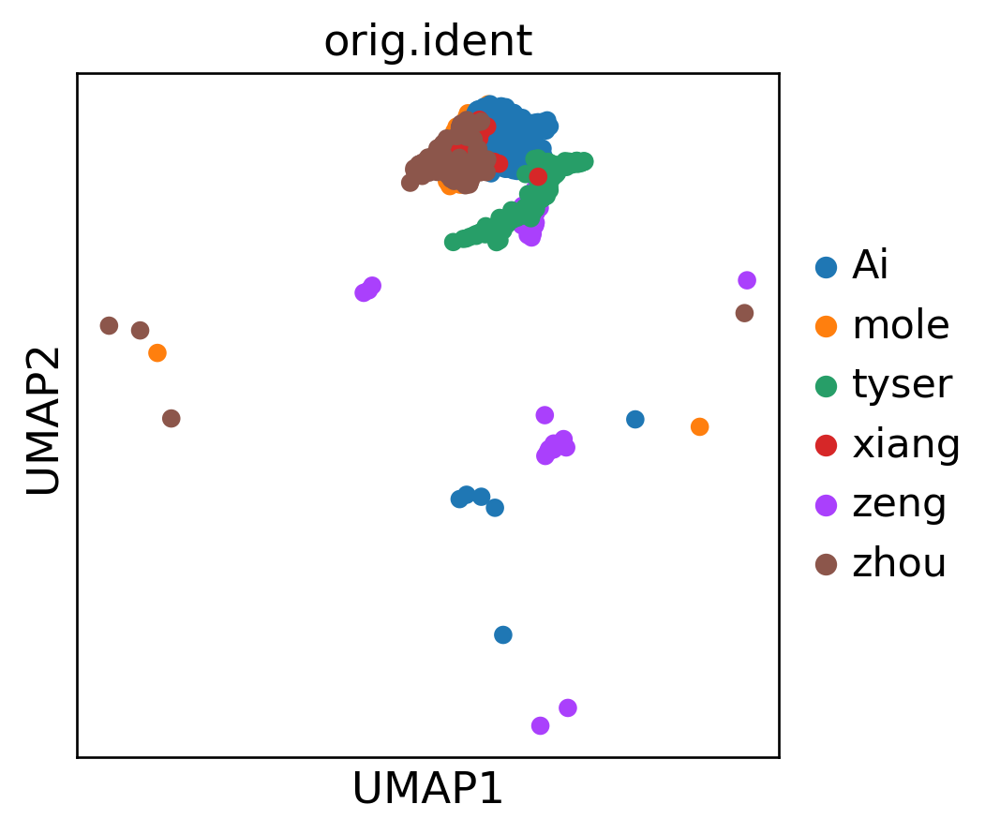

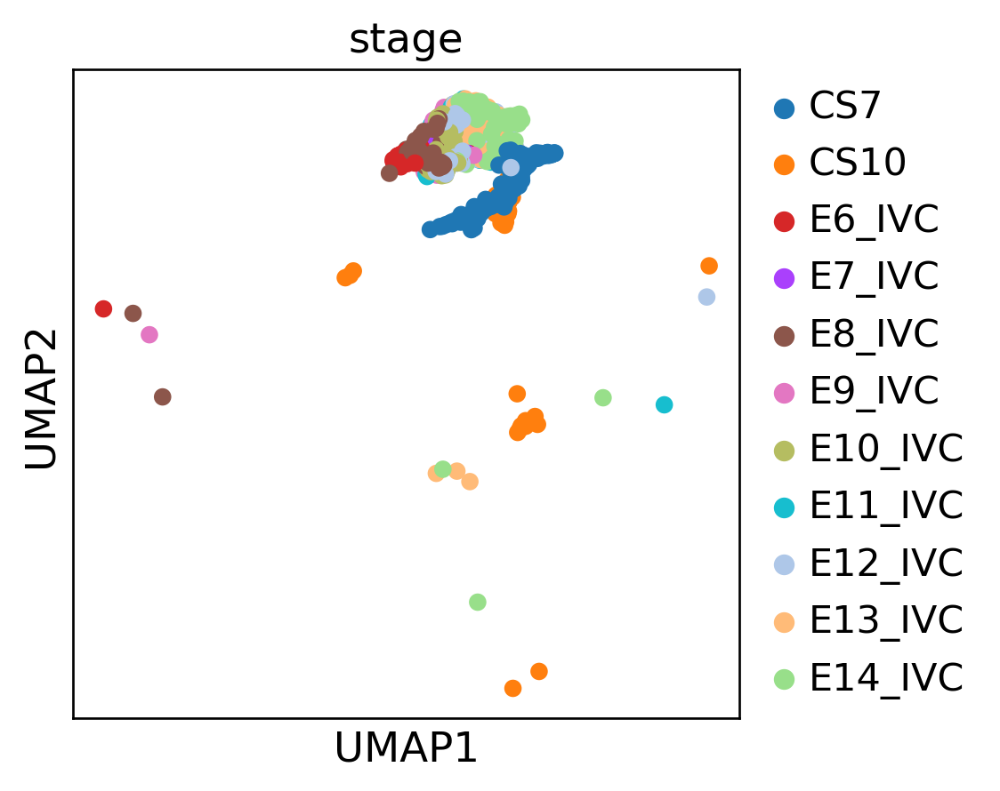

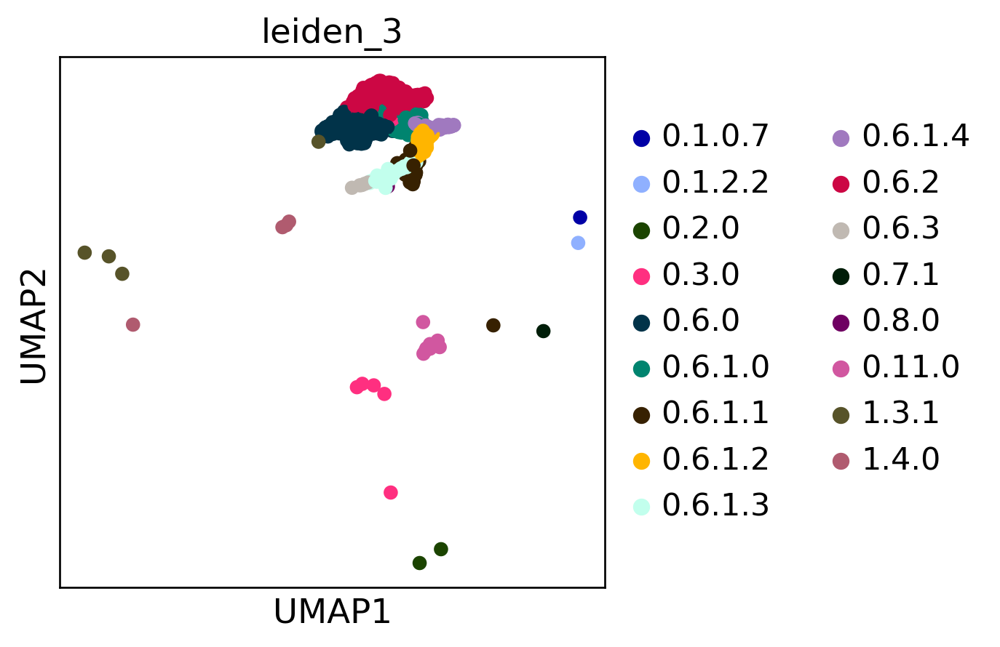

In [52]:
sc.pl.umap(ana_sub, color=['ann_level_2'])
sc.pl.umap(ana_sub, color=['orig.ident'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['leiden_3'])

In [53]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_3'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)

0.6.0      320
0.6.2      228
0.6.1.0    106
0.6.1.1     61
0.6.1.2     50
0.6.1.3     37
0.6.1.4     30
0.11.0      13
0.3.0        6
0.6.3        5
1.3.1        4
1.4.0        4
0.2.0        2
0.7.1        1
0.8.0        1
0.1.2.2      1
0.1.0.7      1
Name: leiden_3, dtype: int64

In [54]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 20].index
# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_3'].isin(clusters_to_keep)]
#ana_sub= adata[adata.obs['leiden_3'].isin([ '0.6.0', '0.6.2', '0.6.1.0', '0.6.1.1', '0.6.1.2', '0.6.1.3','0.6.1.4', ])] 

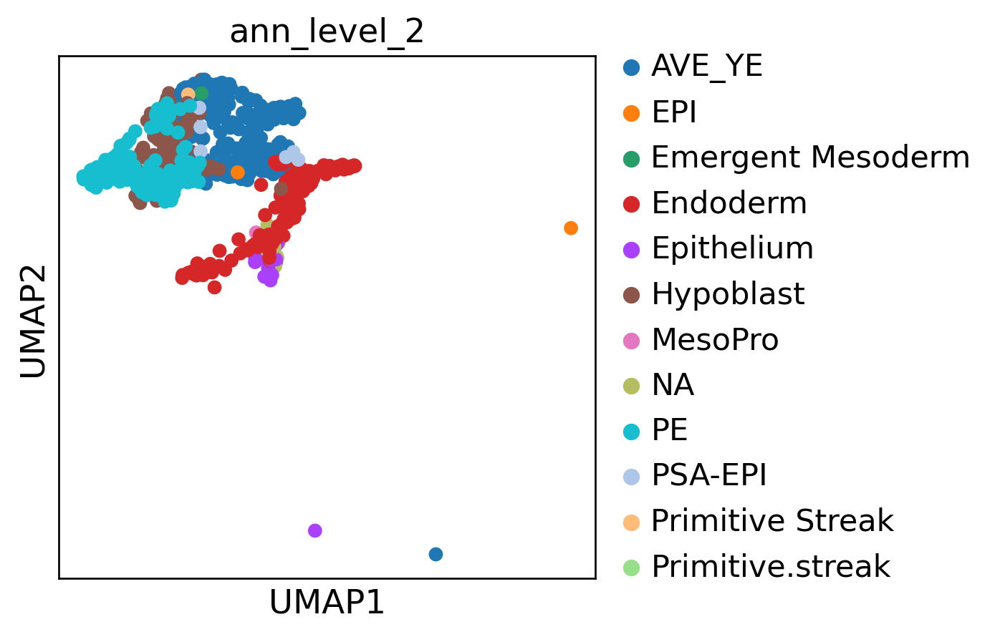

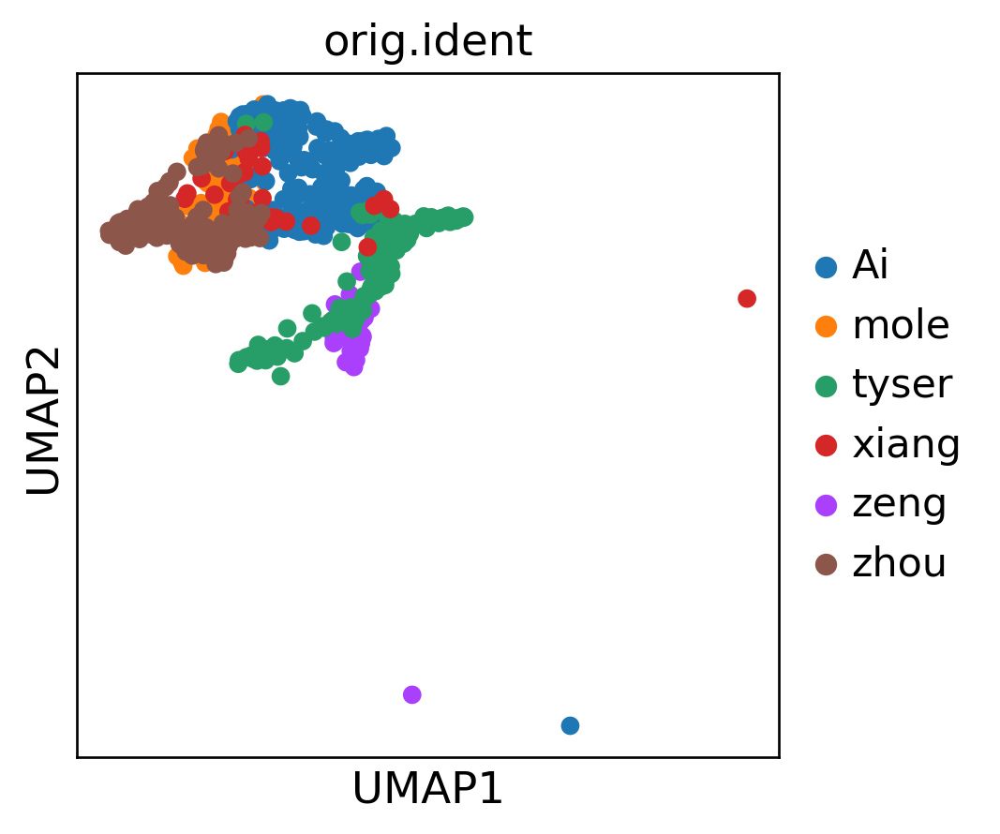

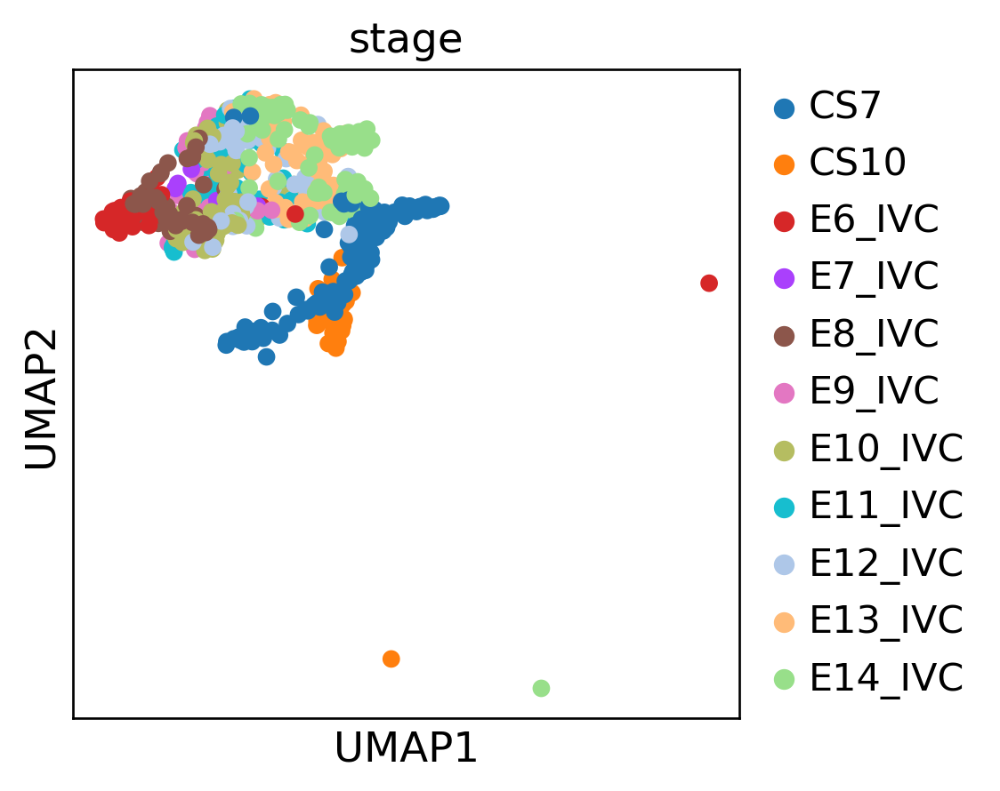

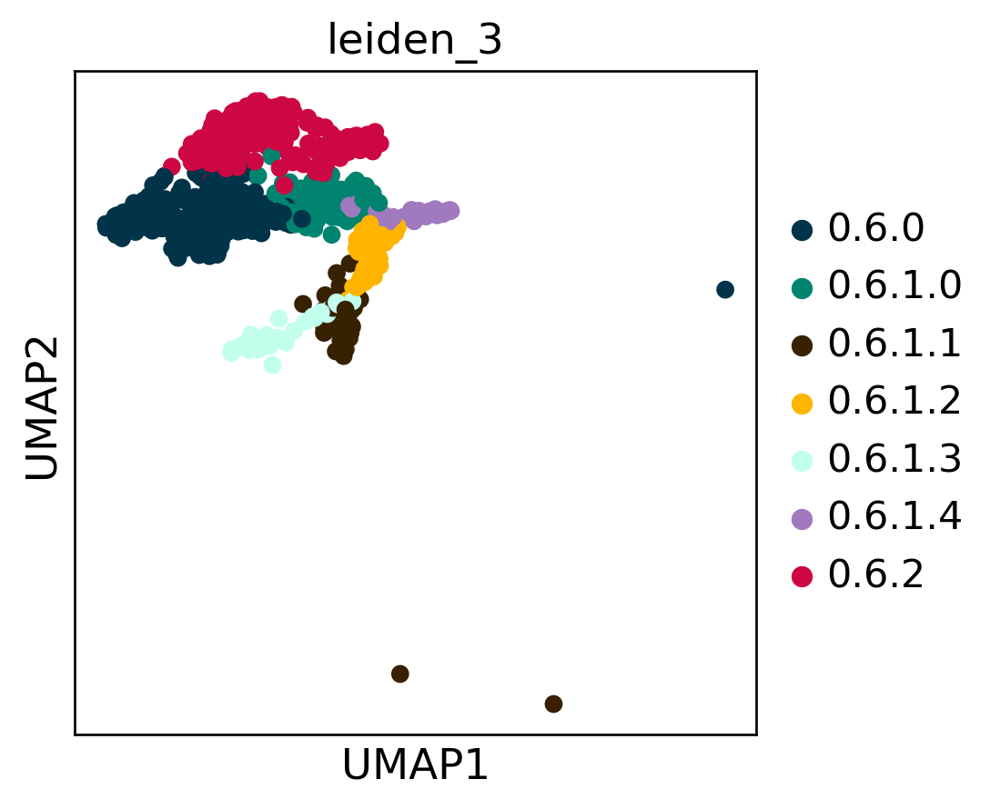

In [55]:
sc.pl.umap(ana_sub, color=['ann_level_2'])
sc.pl.umap(ana_sub, color=['orig.ident'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['leiden_3'])

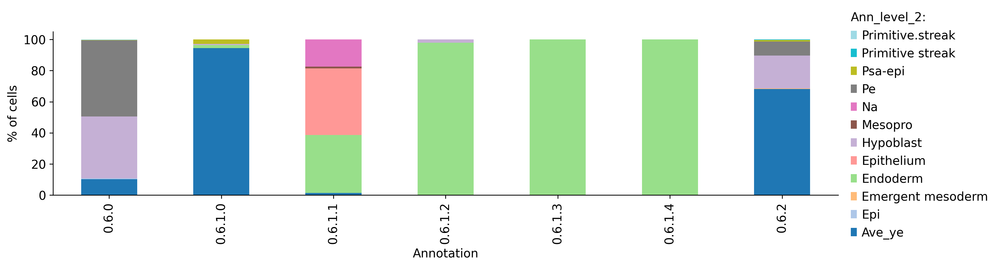

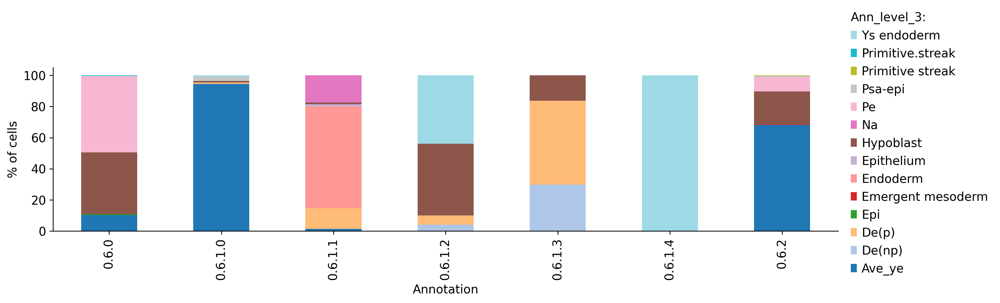

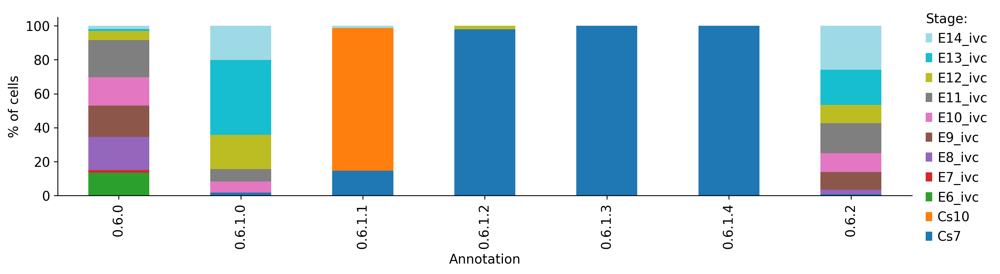

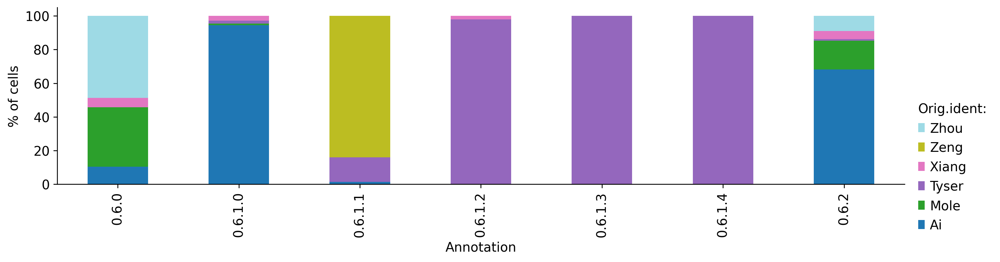

In [56]:
FIGURES = dict()
fz = 12
annos = ['ann_level_2','ann_level_3','stage', 'orig.ident']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['leiden_3'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [57]:
#dot plot
all_marker_genes = {
    "epi.general": [ "POU5F1","NANOG","SOX2",],
    "primed Epi":["UTF1", "FGF2", "DNMT3B", "SOX11", "SFRP2", "SALL2" ,],
    "Amniotic.epi": ["TFAP2C", "GATA3", "MSX2", "TFAP2A", "WNT6","DLX5",],
    "Advanced amnion": ["GABRP", "IGFBP3", "IGFBP5",],
    "Anterior Epi": ["HESX1", "CER1", "LEFTY1","LEFTY2", "OTX2" ],
    "Primitive.streak": ["TBXT", "SP5", "HOXA1", "CDX1", "CDX2","MIXL1", "FST" ],
    "PGC":["NANOS3", "PDPN", "PRDM1"],
    "epithelium":[ "EPCAM","CLDN6"],
    "hypoblast":["GATA6","SOX17","PDGFRA","GATA4"],
    "ExE.endoderm progenitor": ["PODXL", "CDH2", "APOA1", "IHH", "FOXA1", "FOXA2", "HNF4A",],
    "AVE":["LHX1", "HHEX", "EOMES", "GSC", "CER1", "LEFTY1", "LEFTY2","NOG"],
    "VE/YE":["AFP", "TTR", "APOA4", "APOC3","MTTP",],
    "YS endoderm": ["AFP","TTR","GJB1"], 
    "anterior endoderm": ["HHEX", "OTX2", "SHISA2", "CER1"],
         "neural.ecto":["SOX3", "PAX6", "TTYH1"],
     "neural crest":["SOX10", "MPZ", "TFAP2A"],
     "neural tube":["SOX2", "OTX2", "RFX4"],
        "meso.general":[ "MESP1", "PDGFRA", "GATA6"],
    "proliferating.meso": ["MKI67", "TOP2A", "CDK1" ],
        "myocytete": ["PITX2", "TGFBI"],
    "cardio myocyte":["TNNT2", "MYL7", "TNNI1", "MYH10"],
    "somite":["ALDH1A2",  "MEOX2", "MEOX1"],
        "YS.ExE.meso1":["GNRH2", "SPINK1"],
   "YS.ExE.meso2":["MT2A", "A2M"],
    "YS.mesothelium":["PODXL", "CDH1"], 
    "ExE.mesoderm":["LUM", "POSTN", "IGF2", "ANXA1"],

 }


In [58]:
#dot plot
meso_marker_genes2 = {
    "Primitive.streak": ["TBXT", "MESP1","MESP2", "EOMES", "TBX6" ],
    "meso.general":[  "PDGFRA", "GATA6"],
    "EPI": ["USP44", "DNMT3B", "SSB", "PTPRZ1", "SOX2"],
    "PS": ["VRTN", "HAS2", "EOMES", "DUT", "SP5"],
    "Neural plate like": ["ID1", "HSP90AA1", "NPM3", "SLC37A3", "TMEM205"],
    "PGCLC": ["POU5F1", "SOX17", "TFAP2C", "NANOG", "MKRN1"],
    "AM like": ["NOTO", "TAC1", "RHBDF1", "TRIB3", "MAL2", "ID4"],
    "PM": ["MESP1", "FOXL1", "CDX2", "RBPJ", "HMGB3"],
    "LPM": ["TUBB", "TMSB15A", "HMGA2", "PTMS", "DOK4"],
    "ysMeso": ["SLC9A3R1", "MAF", "GNG5", "BNC1", "EPHA7"],
    "Mes": ["CSRP2", "GPX4", "COL21A1", "TNNI1", "DCN"],
    "Cardiomyocyte": ["FAP",  "TIMP1", "COL4A1", "TAGLN"],
    "EXM": ["DEPDC1B", "FBN2", "FRMD4B", "HAND2", "OAF"],
    "Allantois": ["COL6A2", "COL6A1", "F5", "PCOLCE", "VCAN"],
    "Endo": ["GNG11", "CD34", "SOX7", "MEF2C", "CDH5"],
    "Blood": ["LMO2", "IKZF1", "LAPTM5", "FERMT3", "LYL1"],
    "Border": ["WNT6", "TMEM54", "SLC2A3", "CXCL12", "ID2"],
    "Epidermis": ["PRTG", "TSPAN2", "TPM1", "COX4I2", "TSTD1"],
    "Amnion": ["GABRP", "WFDC2", "CPE", "VTCN1", "GPC3"],
    "VE": ["SPINK1", "PDZK1", "MTTP", "HNF4A", "F2", "APOA1"],
    "ParE": ["RPL39", "CCK",  "BCL2L1", "ZFP36"],
    "DE": ["UCP2", "RDX", "COL9A2", "FOXA2", "SORL1"],
     "foregut1": [ "HHEX","PHLDA2","IGF2","MECOM","NR4A1","STMN1",],
     "foregut2": [ "AREG","EGFR","BMP4","IFI6",],
    "midgut":["MNX1", "HOXB2", "HOXC9",],
    "hindgut1": ["HOXA10", "CXCL12","RSPO3","TMEM88","SOX17",],
    "hindgut2": ["KITLG", "COL9A2","COL4A1","WNT5B","IHH",],
     
}

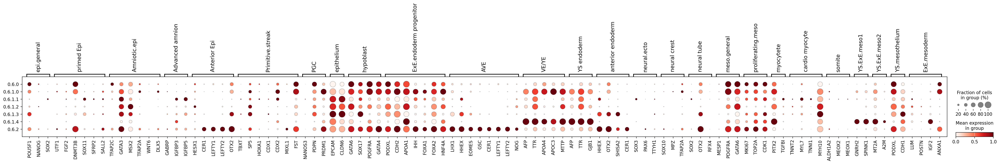

In [59]:
sc.pl.dotplot(ana_sub, all_marker_genes, groupby="leiden_3", use_raw=False, standard_scale="var")

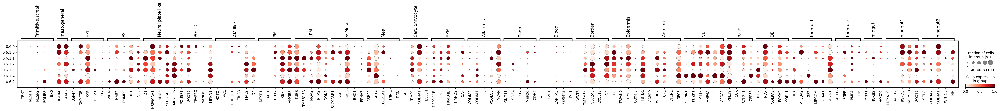

In [60]:
sc.pl.dotplot(ana_sub, meso_marker_genes2, groupby="leiden_3", use_raw=False, standard_scale="var")

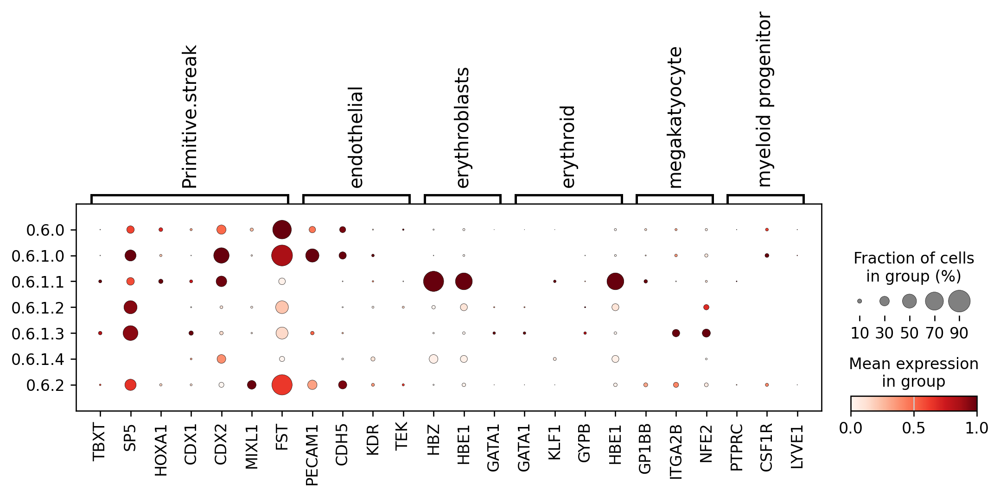

In [61]:
sc.pl.dotplot(ana_sub, hemato_marker_genes, groupby="leiden_3", use_raw=False, standard_scale="var")

In [62]:
# Obtain cluster-specific differentially expressed genes
#sc.tl.rank_genes_groups(ana_sub, groupby="leiden_3", method="wilcoxon",use_raw=False)
#sc.tl.dendrogram(ana_sub, groupby="leiden_3")

#sc.pl.rank_genes_groups_dotplot(ana_sub, groupby="leiden_3", standard_scale="var", n_genes=5,use_raw=False, save='marker')

In [63]:
##rename clusters

ana_sub.obs['reanno'] = ana_sub.obs['leiden_3'].cat.add_categories(['Hypoblast','VE/YE','YS.Endoderm','AVE',
                                                                    'DE'])


ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.6.0'])] = 'Hypoblast'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.6.1.0'])] = 'VE/YE'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.6.2'])] = 'AVE'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.6.1.4'])] = 'YS.Endoderm'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.6.1.1'])] = 'DE'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.6.1.2'])] = 'DE'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.6.1.3'])] = 'DE'



ana_sub.obs['reanno'] = ana_sub.obs['reanno'].cat.remove_unused_categories()


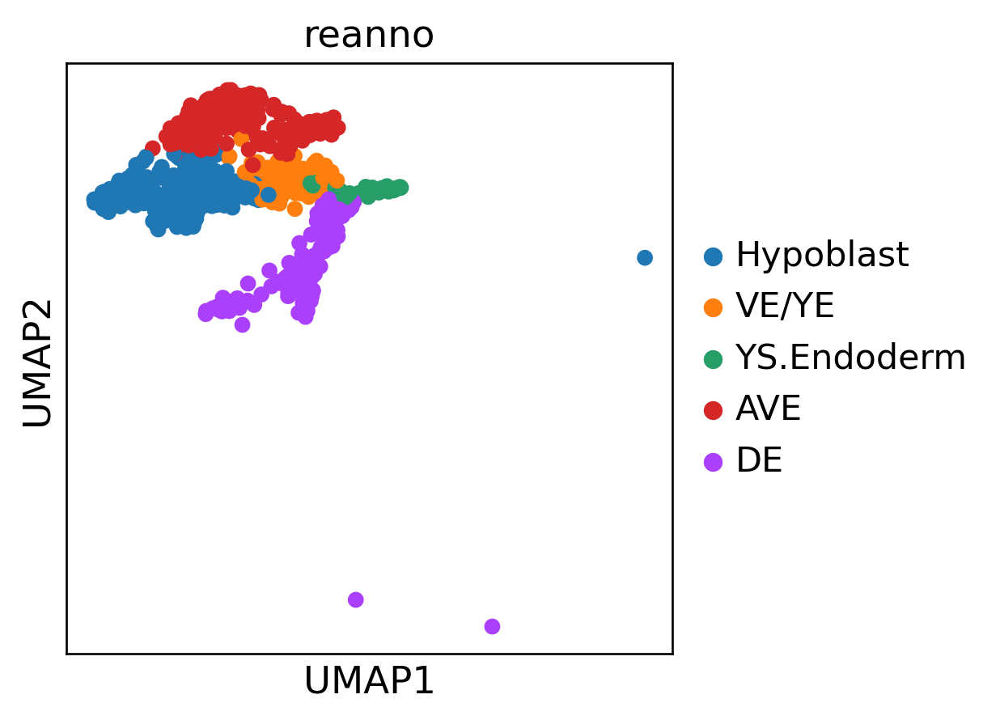

In [64]:
sc.pl.umap(ana_sub, color=['reanno'])

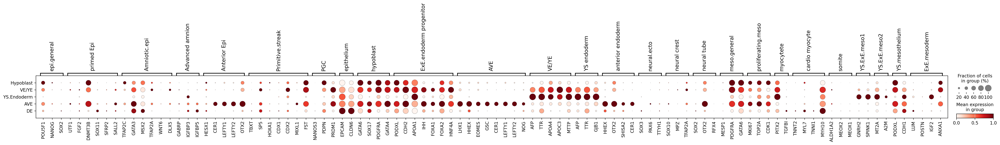

In [65]:
sc.pl.dotplot(ana_sub, all_marker_genes, groupby="reanno", use_raw=False, standard_scale="var")

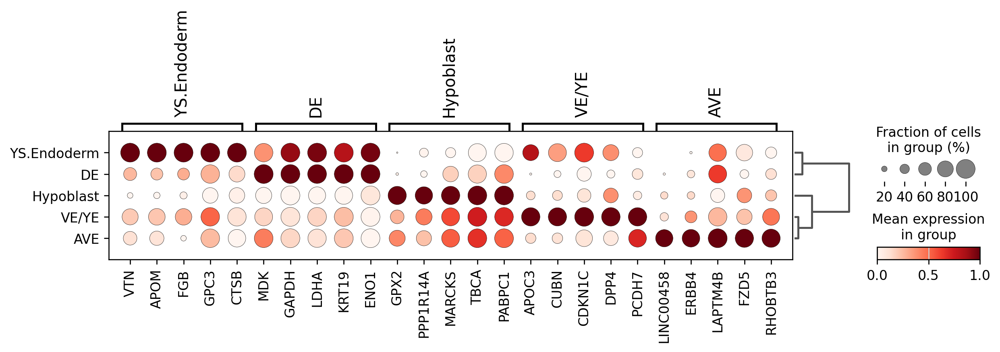

In [66]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(ana_sub, groupby="reanno", method="wilcoxon",use_raw=False)
sc.tl.dendrogram(ana_sub, groupby="reanno")

sc.pl.rank_genes_groups_dotplot(ana_sub, groupby="reanno", standard_scale="var", n_genes=5,use_raw=False, save='marker')

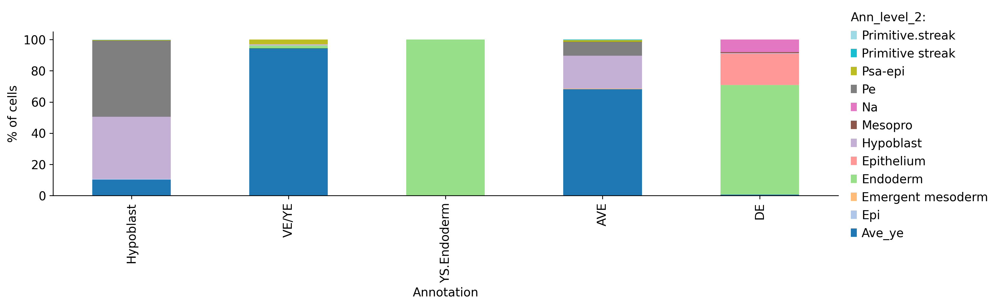

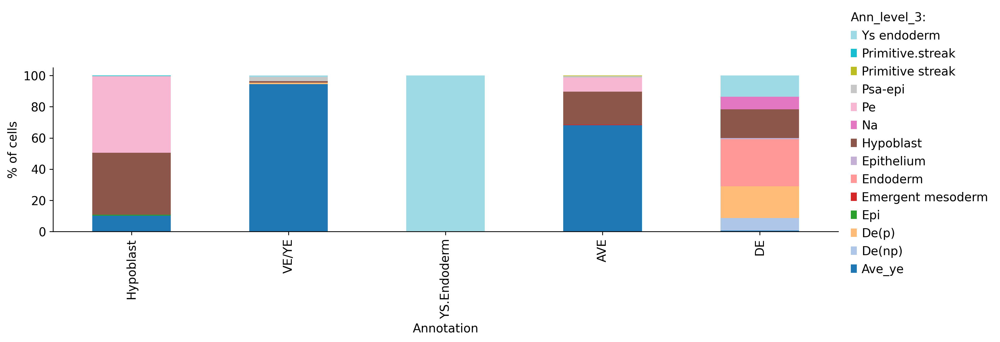

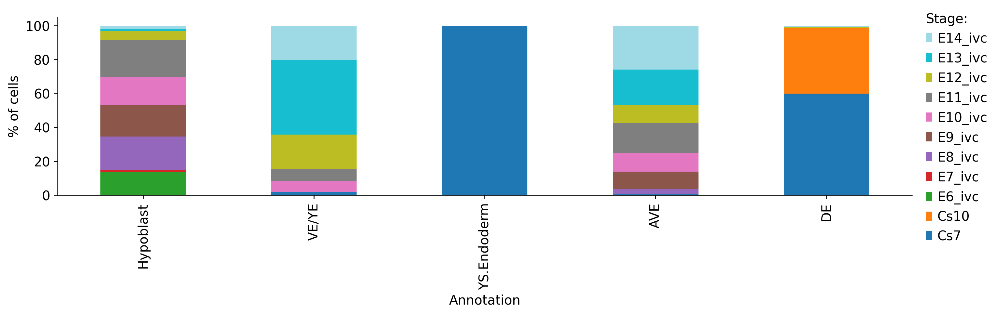

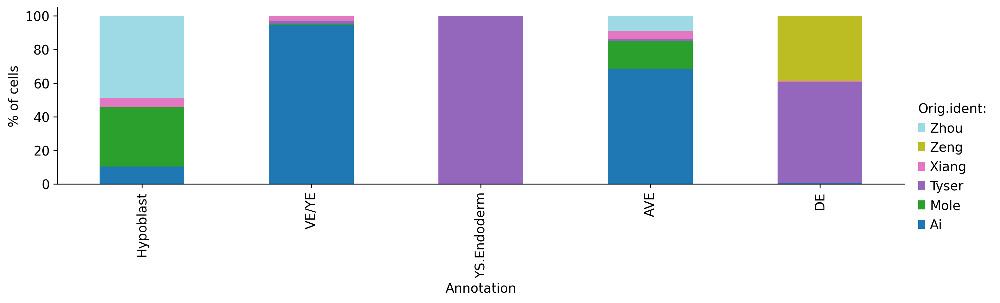

In [67]:
FIGURES = dict()
fz = 12
annos = ['ann_level_2','ann_level_3','stage', 'orig.ident']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['reanno'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [68]:
# Extract the sub-cluster labels
sub_cluster_labels = ana_sub.obs['reanno']

# Combine the categories
combined_categories = pd.CategoricalDtype(categories=list(set(adata.obs['reanno'].cat.categories).union(set(sub_cluster_labels.cat.categories))))

# Convert both columns to the combined categories
adata.obs['reanno'] = adata.obs['reanno'].astype(combined_categories)
sub_cluster_labels = sub_cluster_labels.astype(combined_categories)

# Ensure indices in ann_sub are a subset of those in adata
assert set(ana_sub.obs.index).issubset(set(adata.obs.index)), "Indices in ann_sub are not a subset of those in adata"

# Update 'reanno' in adata with the values from sub_cluster_labels
adata.obs.loc[ana_sub.obs.index, 'reanno'] = sub_cluster_labels.loc[ana_sub.obs.index]

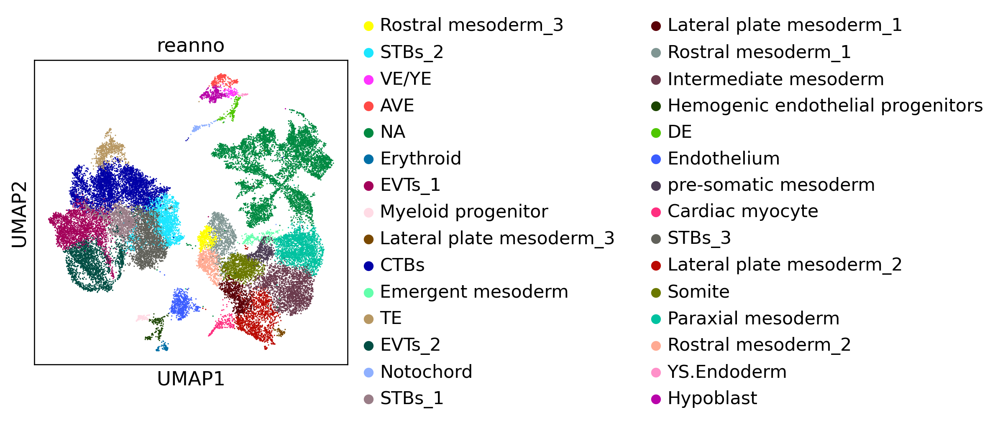

In [69]:
sc.pl.umap(adata, color=['reanno'])

In [70]:
# focusing on Endoderm lineage
ana_sub= adata[adata.obs['ann_level_1'].isin([ 'Epiblast','Neural.Ectoderm', 'Non-Neural.Ectoderm','ExE.Mesoderm','Primitive.streak','PGC',])]

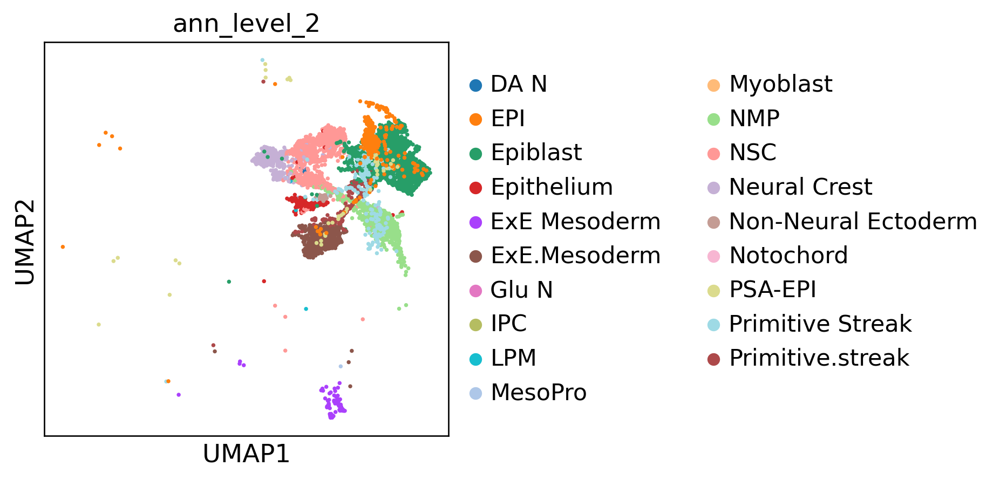

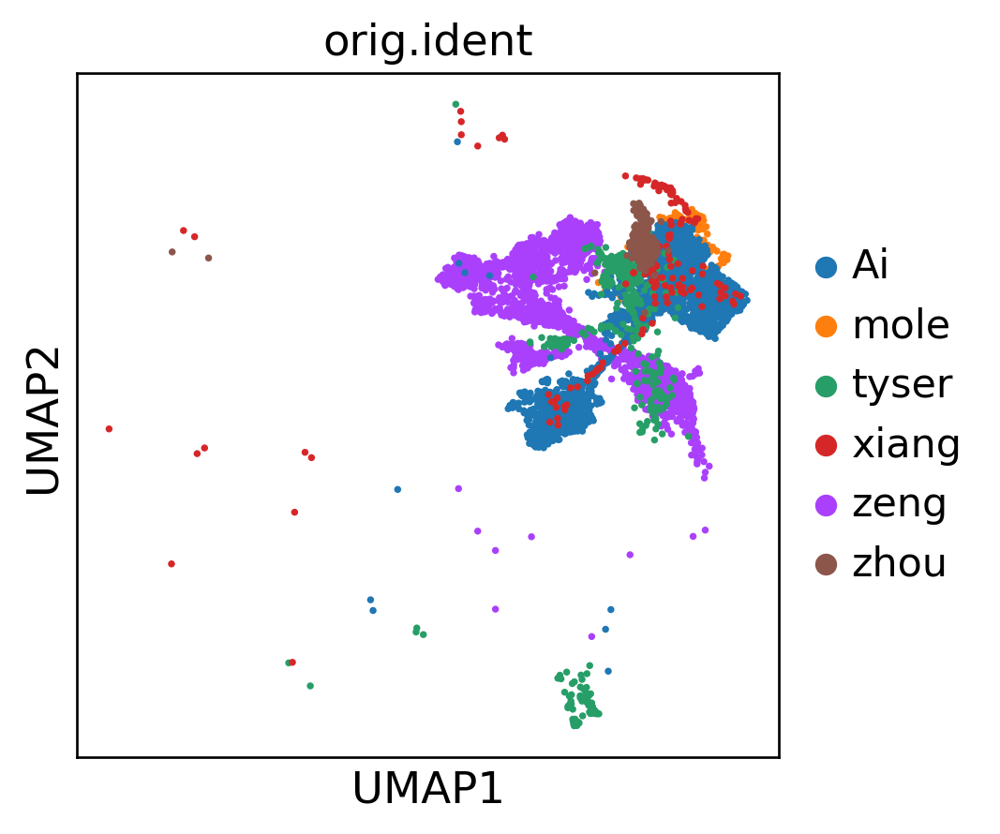

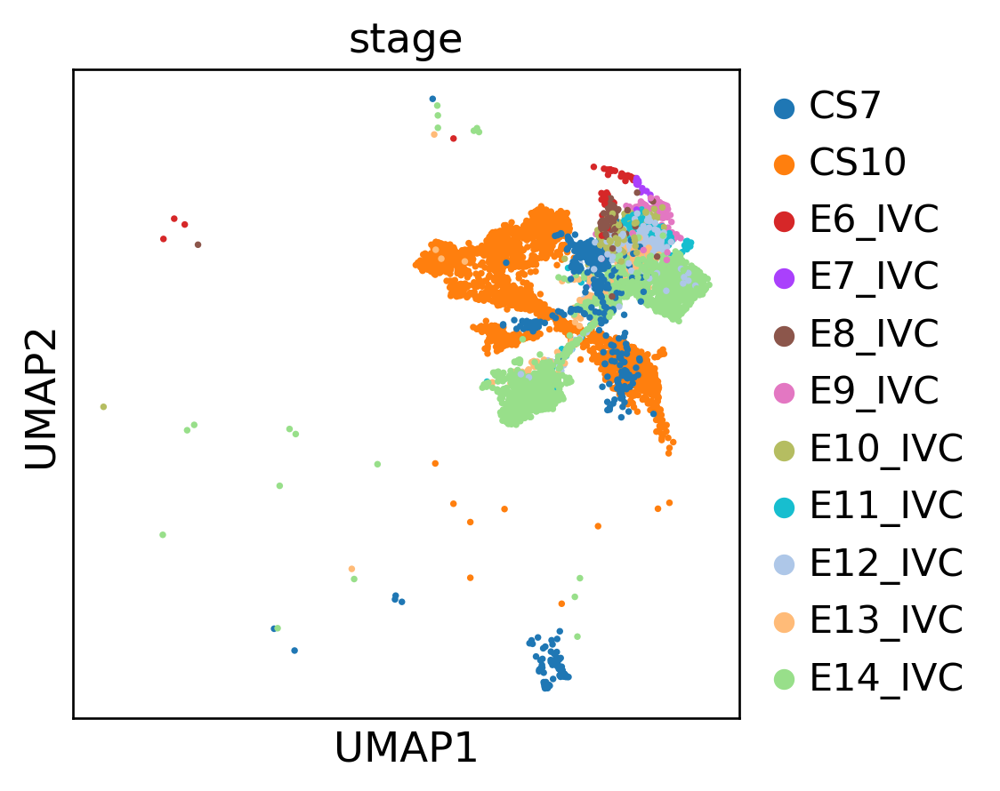

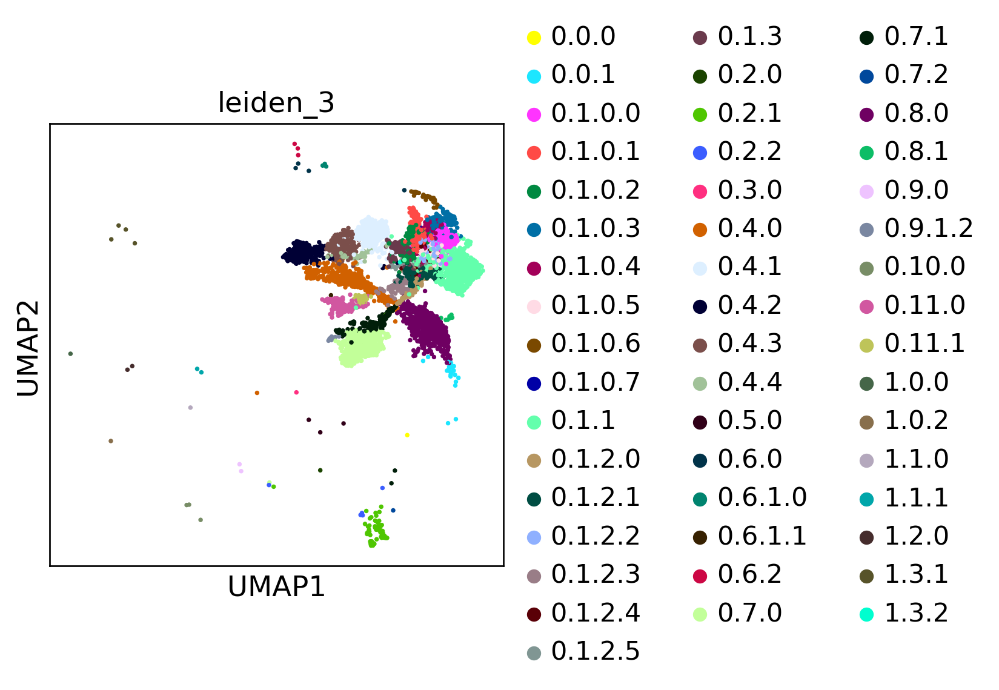

In [71]:
sc.pl.umap(ana_sub, color=['ann_level_2'])
sc.pl.umap(ana_sub, color=['orig.ident'])
sc.pl.umap(ana_sub, color=['stage'])
sc.pl.umap(ana_sub, color=['leiden_3'])

In [72]:
# Use value_counts to count the number of cells in each cluster
cluster_counts = ana_sub.obs['leiden_3'].value_counts()

# Set the display option to show all rows
pd.set_option('display.max_rows', None)

# Print the counts
print(cluster_counts)

0.1.1      874
0.8.0      646
0.7.0      643
0.4.0      506
0.4.1      447
0.4.2      316
0.4.3      307
0.1.0.0    287
0.1.0.1    228
0.7.1      186
0.1.0.2    174
0.11.0     171
0.1.0.3    158
0.1.0.4    132
0.1.3      115
0.1.2.1     96
0.1.0.5     86
0.1.2.0     85
0.1.2.2     79
0.2.1       77
0.1.2.3     68
0.4.4       61
0.1.2.4     53
0.11.1      46
0.1.0.6     36
0.1.2.5     27
0.0.1       23
0.9.1.2     12
0.1.0.7     10
0.8.1       10
0.2.2        5
0.6.0        4
1.3.1        4
0.5.0        3
0.6.1.0      3
0.6.2        3
0.10.0       3
1.1.1        2
0.9.0        2
1.2.0        2
1.0.2        1
1.1.0        1
0.0.0        1
1.0.0        1
0.7.2        1
0.6.1.1      1
0.3.0        1
0.2.0        1
1.3.2        1
Name: leiden_3, dtype: int64

In [73]:
# Subset the clusters that have more than 10 counts
clusters_to_keep = cluster_counts[cluster_counts > 5].index
# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_3'].isin(clusters_to_keep)]

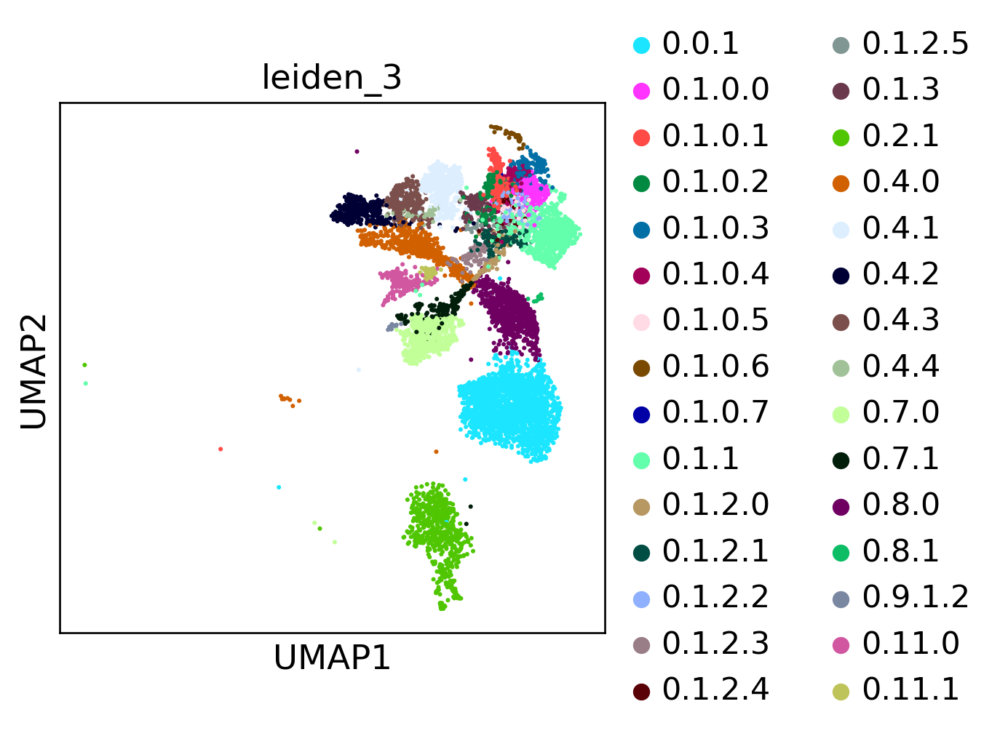

In [74]:
sc.pl.umap(ana_sub, color=['leiden_3'])

In [75]:
#manually remove 0.0.1 and 0.2.1
# Remove specific clusters
clusters_to_remove = ["0.0.1", "0.2.1"]
clusters_to_keep = clusters_to_keep[~clusters_to_keep.isin(clusters_to_remove)]
# Subset the original data to keep only the selected clusters
ana_sub = adata[adata.obs['leiden_3'].isin(clusters_to_keep)]

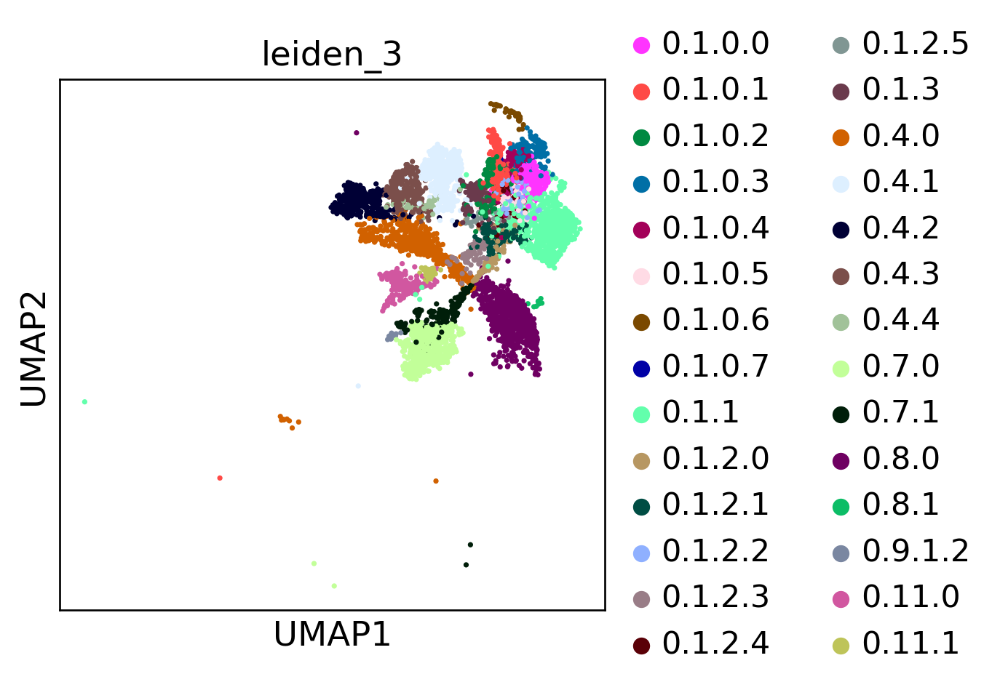

In [76]:
sc.pl.umap(ana_sub, color=['leiden_3'])

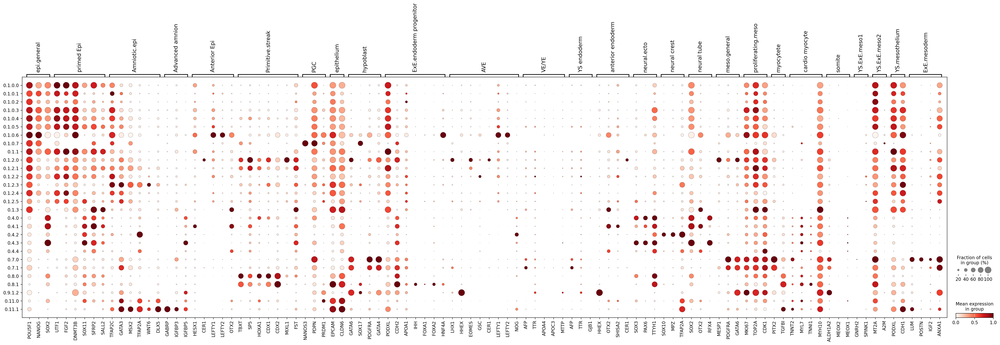

In [77]:
sc.pl.dotplot(ana_sub, all_marker_genes, groupby="leiden_3", use_raw=False, standard_scale="var")

In [78]:
#dot plot
epi_marker_genes = {
    "epi.general": [ "POU5F1","NANOG","SOX2",],
    "naïve Epi":["KLF4", "KLF17", "DNMT3L", "SOX15", "TFCP2L1", "ZFP42",],
    "primed Epi":["UTF1", "FGF2", "DNMT3B", "SOX11", "SFRP2", "SALL2" ,],
    "PostE-EPI": [ "UTF1", "FGF4", "NODAL",],
    "PostL-EPI": [ "IGFBP2", "USP44", "CD24",],
    "Amniotic.epi": ["TFAP2C", "GATA3", "MSX2", "TFAP2A", "WNT6","DLX5",],
    "Advanced amnion": ["GABRP", "IGFBP3", "IGFBP5",],
    "Anterior Epi": ["HESX1", "CER1", "LEFTY1","LEFTY2", "OTX2" ],
    "Primitive.streak": ["TBXT", "SP5", "HOXA1", "CDX1", "CDX2","MIXL1", "FST" ],
    "PGC":["NANOS3", "PDPN", "PRDM1"],
    "epithelium":[ "EPCAM","CLDN6"],
    "hypoblast":["GATA6","SOX17","PDGFRA"],
    "ExE.endoderm progenitor": ["PODXL", "CDH2", "APOA1", "IHH", "FOXA1", "FOXA2", "HNF4A",],
    "AVE":["LHX1", "HHEX", "EOMES", "GSC", "CER1", "LEFTY1", "LEFTY2","NOG"],
    "VE/YE":["AFP", "TTR", "APOA4", "APOC3","MTTP",],
    "YS endoderm": ["AFP","TTR","GJB1"], 
    "anterior endoderm": ["HHEX", "OTX2", "SHISA2", "CER1"],
    "Gastru endoderm":["APOA2","FOXA2","TTR",],
 
     
    #"Advanced mesoderm": ["HAND1", "BMP4","FOXF1", "SNAI2" ],
    "lateral plate.meso":["HAND1","KDR", "MYL7","HAPLN1" ],
    "ExE.mesoderm":["LUM", "POSTN", "IGF2", "ANXA1"],
    

    
   # "Allantoic stalk":[ "FGF9", "FGF18", "SHH", "WNT5B", "MDK"],
   #"ExE.mesoderm prog":["MSX1", "COL6A3"],
   # "Nascent ExE.meso":["IGFBP5", "IGFBP7"],
   # "AM.ExE.meso":["MSX2", "TEAD1"],
   # "YS.ExE.meso1":["GNRH2", "SPINK1"],
   # "YS.ExE.meso2":["MT2A", "A2M"],
   # "YS.mesothelium":["PODXL", "CDH1"],

    
     
}

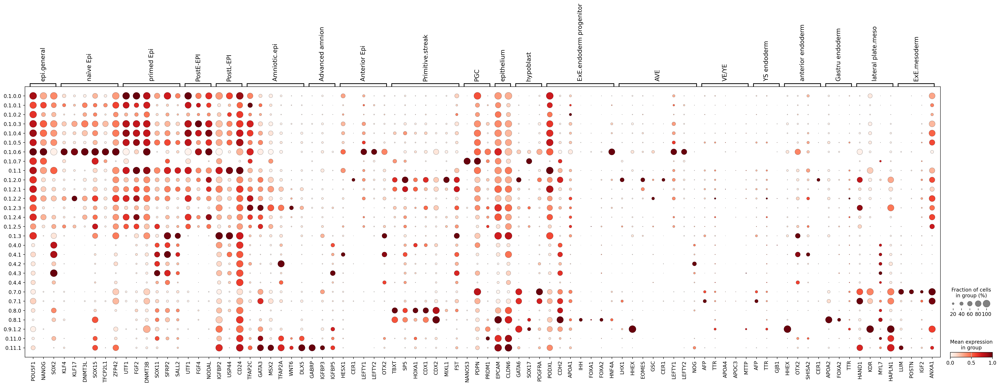

In [79]:
sc.pl.dotplot(ana_sub, epi_marker_genes, groupby="leiden_3", use_raw=False, standard_scale="var")

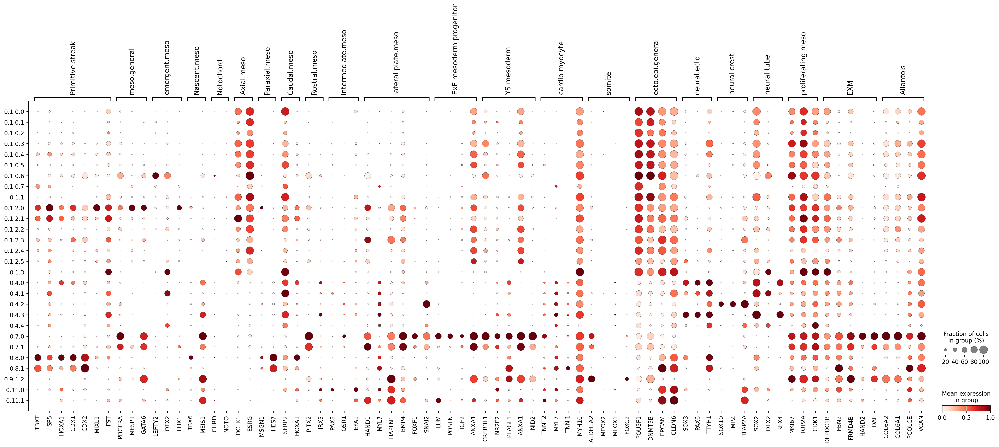

In [80]:
sc.pl.dotplot(ana_sub, meso_marker_genes, groupby="leiden_3", use_raw=False, standard_scale="var")

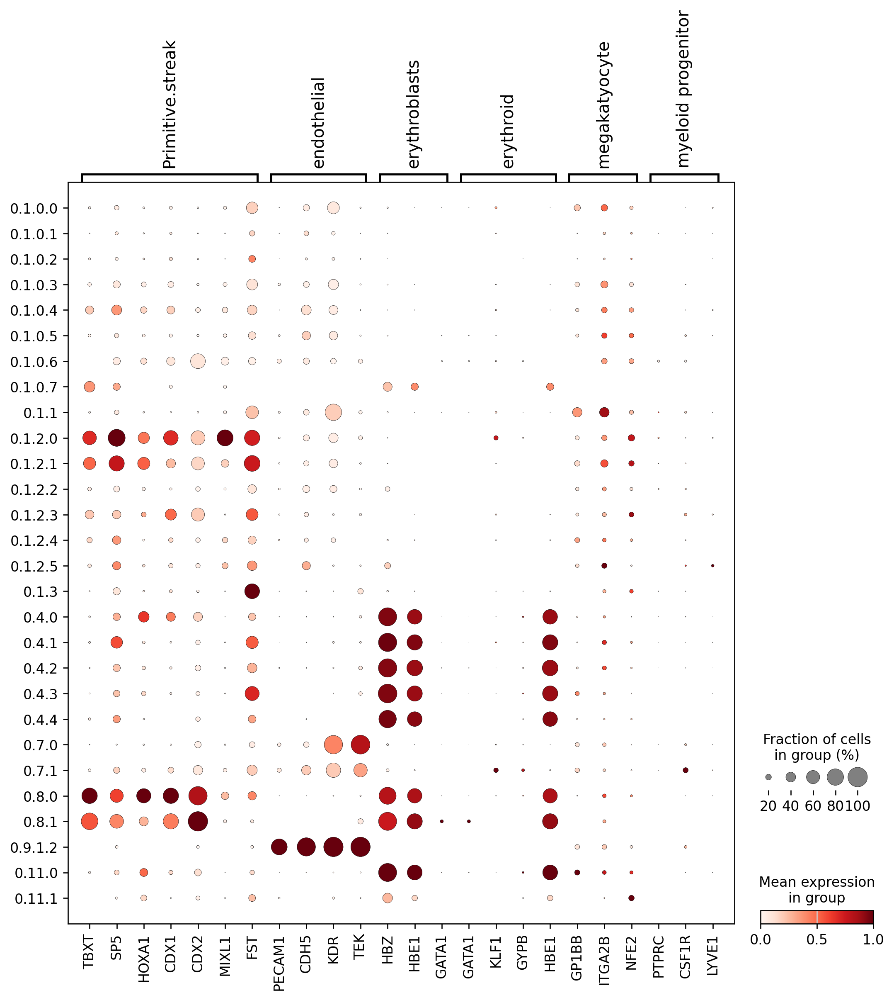

In [81]:
sc.pl.dotplot(ana_sub, hemato_marker_genes, groupby="leiden_3", use_raw=False, standard_scale="var")

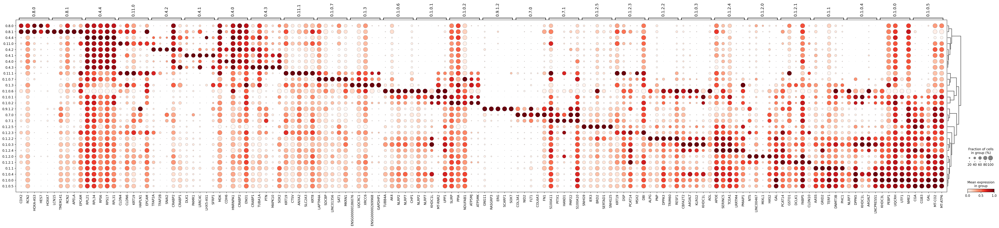

In [82]:
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(ana_sub, groupby="leiden_3", method="wilcoxon",use_raw=False)
sc.tl.dendrogram(ana_sub, groupby="leiden_3")

sc.pl.rank_genes_groups_dotplot(ana_sub, groupby="leiden_3", standard_scale="var", n_genes=5,use_raw=False, save='marker')

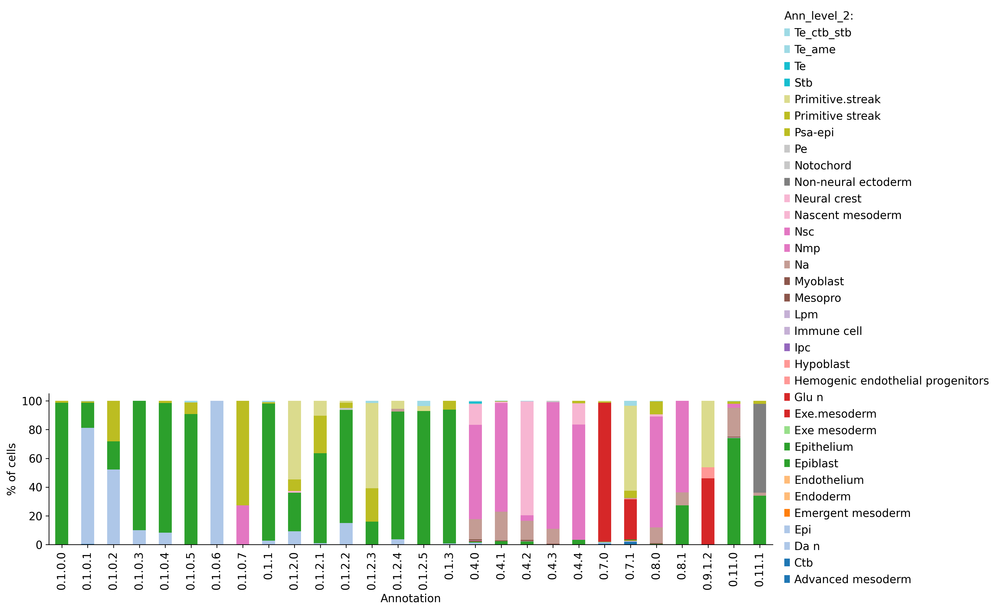

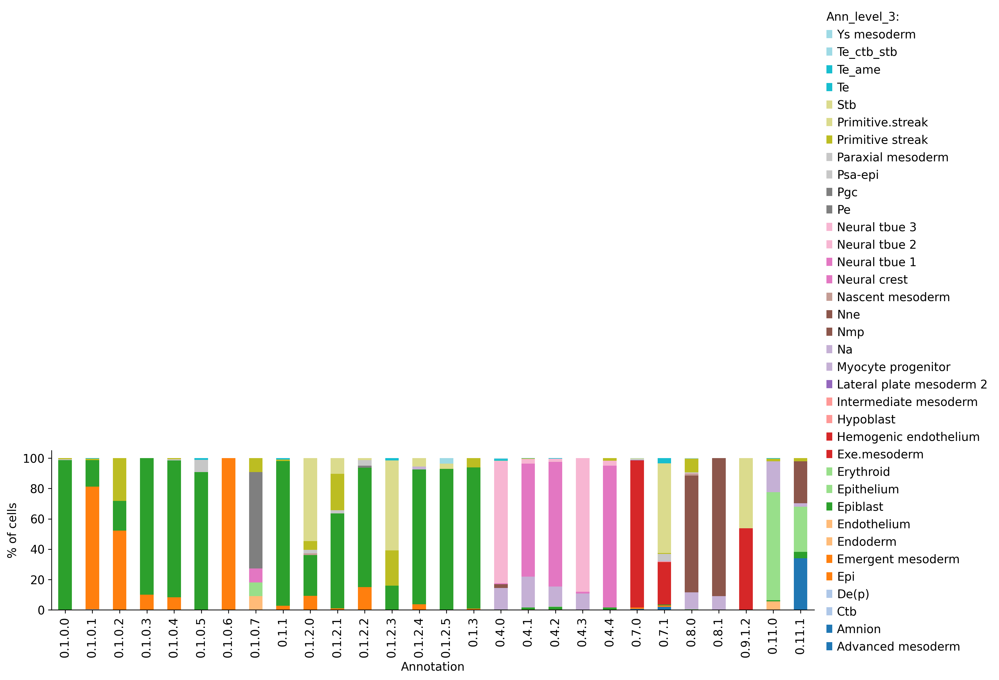

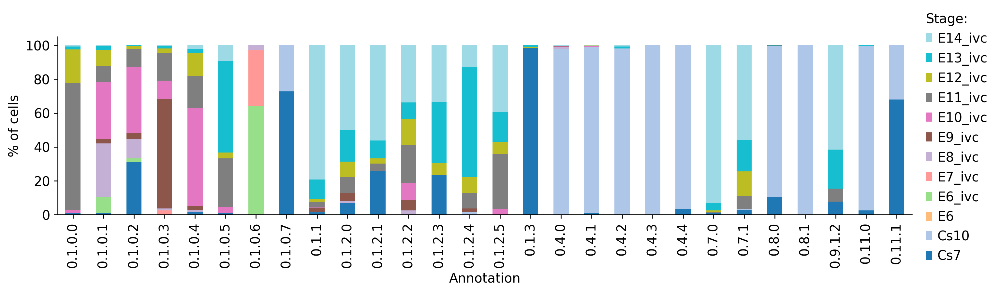

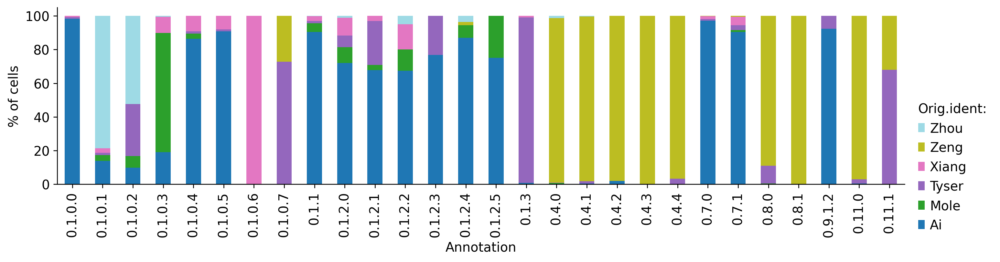

In [83]:
FIGURES = dict()
fz = 12
annos = ['ann_level_2','ann_level_3','stage', 'orig.ident']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['leiden_3'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

In [84]:
##rename clusters

ana_sub.obs['reanno'] = ana_sub.obs['leiden_3'].cat.add_categories(['Amnion','Ectoderm','Primitive.streak',
                                                                   'Neural tube_1','Neural tube_2','Neural crest','Exe.meso progenitor','YS.mesoderm',
                                                                   'PGC','Epi_1','Epi_2','Epi_3','Epi_4','Epi_5','Amniotic_epi','Nascent mesoderm','Exe.endothelium'])

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.11.0'])] = 'Amnion'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.11.1'])] = 'Amnion'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.8.0'])] = 'Nascent mesoderm'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.8.1'])] = 'Nascent mesoderm'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.4.0',])] = 'Neural tube_1'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.4.1'])] = 'Neural tube_2'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.4.3'])] = 'Neural tube_1'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.4.2','0.4.0.2'])] = 'Neural crest'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.4.4'])] = 'Neural tube_2'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.7.0'])] = 'YS.mesoderm'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.7.1'])] = 'Exe.meso progenitor'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.0.7'])] = 'PGC'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.0.6'])] = 'Epi_1'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.0.3'])] = 'Epi_2'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.0.1'])] = 'Epi_2'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.0.4'])] = 'Epi_2'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.0.2'])] = 'Epi_2'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.0.0'])] = 'Epi_3'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.0.5'])] = 'Epi_3'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.1'])] = 'Epi_3'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.3'])] = 'Ectoderm'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.2.1'])] = 'Epi_4'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.2.0'])] = 'Primitive.streak'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.2.2'])] = 'Epi_2'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.2.3'])] = 'Amniotic_epi'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.2.4'])] = 'Epi_4'
ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.1.2.5'])] = 'Epi_4'

ana_sub.obs['reanno'][np.in1d(ana_sub.obs['reanno'], ['0.9.1.2'])] = 'Exe.endothelium'


ana_sub.obs['reanno'] = ana_sub.obs['reanno'].cat.remove_unused_categories()


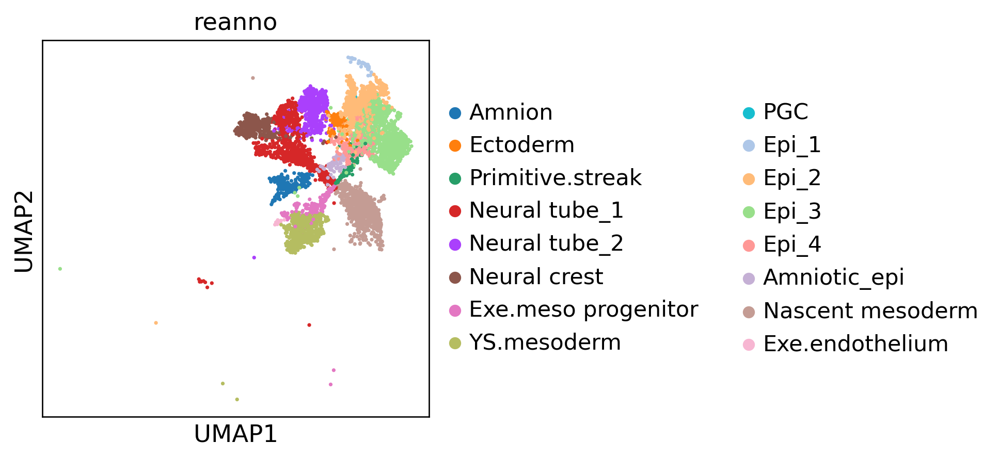

In [85]:
sc.pl.umap(ana_sub, color=['reanno'])

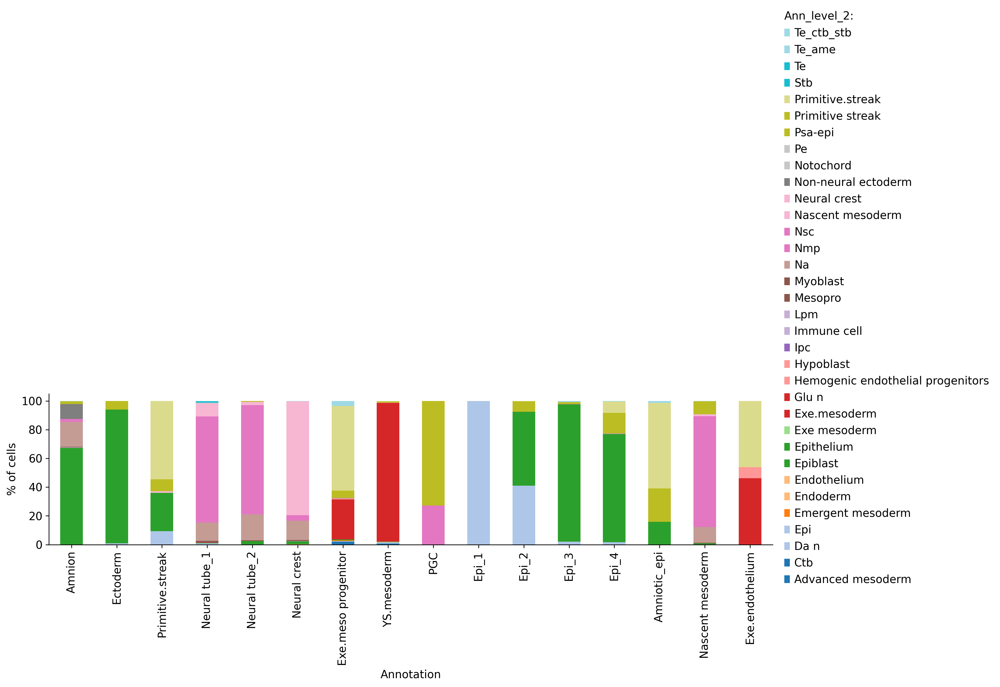

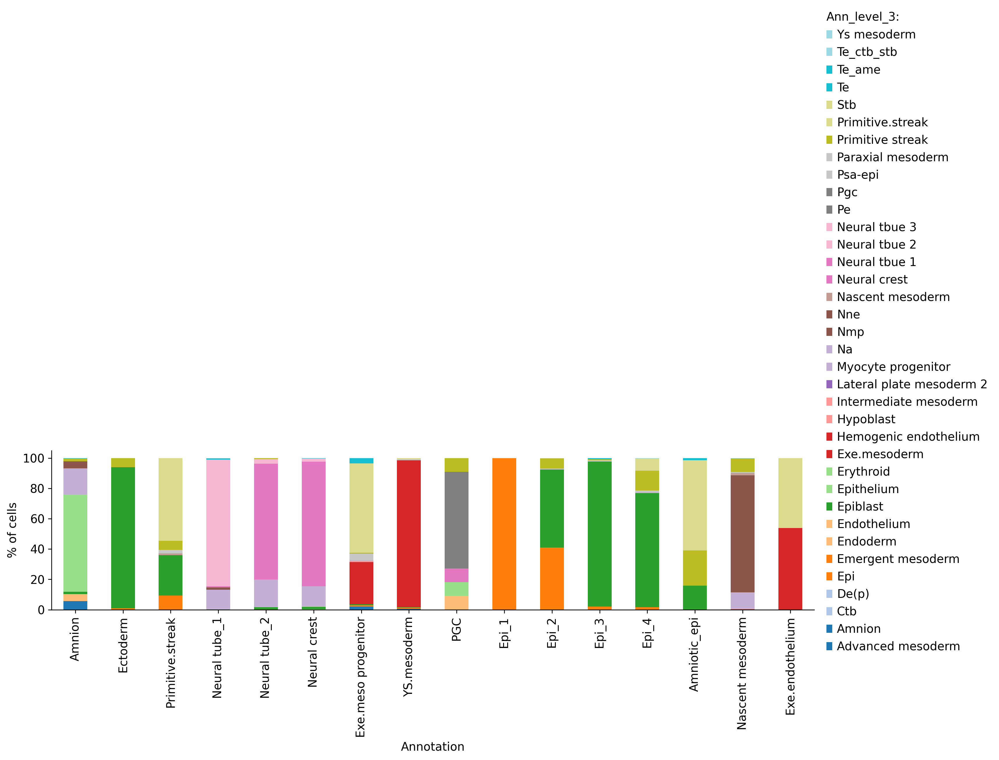

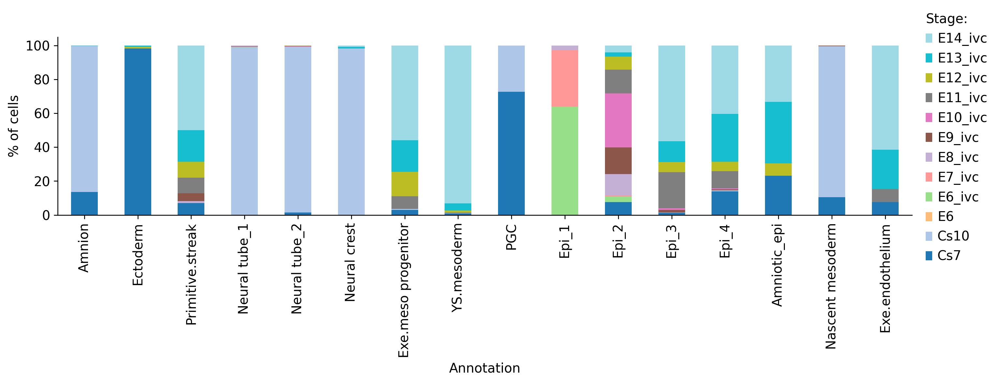

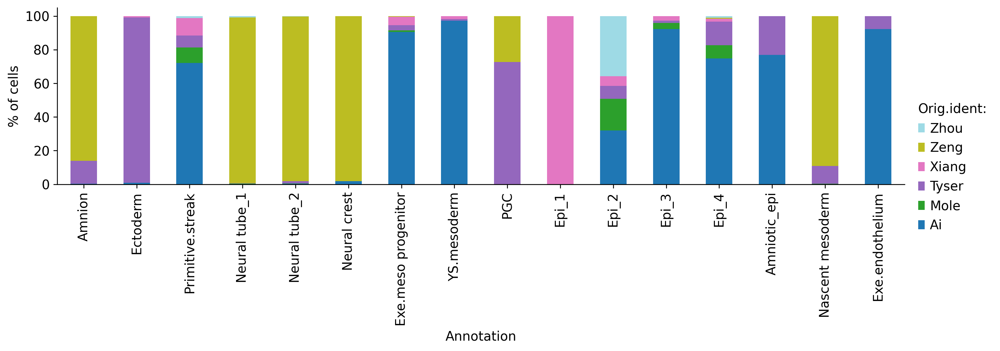

In [86]:
FIGURES = dict()
fz = 12
annos = ['ann_level_2','ann_level_3','stage', 'orig.ident']
for x in annos:
    study_count_per_ct = pd.crosstab(ana_sub.obs['reanno'], ana_sub.obs[x])
    study_perc_per_ct = (
        study_count_per_ct.divide(study_count_per_ct.sum(axis=1), axis=0) * 100
    )

    with plt.rc_context(
        {
            "figure.figsize": (14, 3),
            "xtick.labelsize": fz,
            "ytick.labelsize": fz,
            "axes.labelsize": fz,
            "font.size": fz,
            "axes.spines.right": False,
            "axes.spines.top": False,
        }
    ):
        fig, ax = plt.subplots()
        study_perc_per_ct.plot(kind="bar", stacked=True, ax=ax, cmap="tab20", grid=False)
        handles, labels = ax.get_legend_handles_labels()
        labels = [lab.capitalize() for lab in labels]
        ax.legend(
            handles[::-1],
            labels[::-1],
            loc=(1.01, -0.3),
            fontsize=fz,
            frameon=False,
            title=f"{x.capitalize()}:",
        )
        leg = ax.get_legend()
        leg._legend_box.align = "left"
        plt.ylabel("% of cells")
        plt.xlabel("Annotation")
        FIGURES[f"ED_4a_cell_type_{x}"] = fig
        plt.show()

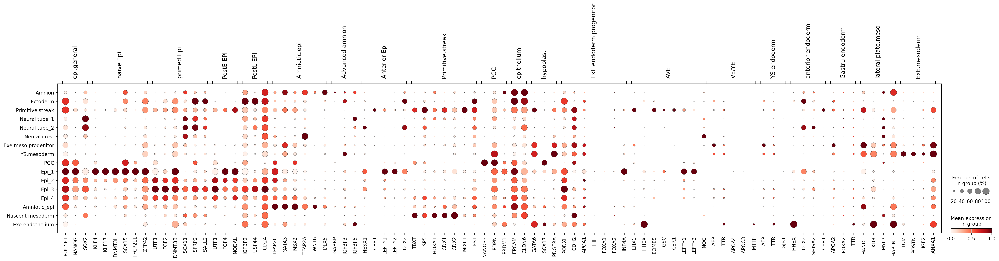

In [87]:
sc.pl.dotplot(ana_sub, epi_marker_genes, groupby="reanno", use_raw=False, standard_scale="var")

In [88]:
# Obtain cluster-specific differentially expressed genes
#sc.tl.rank_genes_groups(ana_sub, groupby="reanno", method="wilcoxon",use_raw=False)
#sc.tl.dendrogram(ana_sub, groupby="reanno")

#sc.pl.rank_genes_groups_dotplot(ana_sub, groupby="reanno", standard_scale="var", n_genes=5,use_raw=False, save='marker')

In [89]:
# Extract the sub-cluster labels
sub_cluster_labels = ana_sub.obs['reanno']

# Combine the categories
combined_categories = pd.CategoricalDtype(categories=list(set(adata.obs['reanno'].cat.categories).union(set(sub_cluster_labels.cat.categories))))

# Convert both columns to the combined categories
adata.obs['reanno'] = adata.obs['reanno'].astype(combined_categories)
sub_cluster_labels = sub_cluster_labels.astype(combined_categories)

# Ensure indices in ann_sub are a subset of those in adata
assert set(ana_sub.obs.index).issubset(set(adata.obs.index)), "Indices in ann_sub are not a subset of those in adata"

# Update 'reanno' in adata with the values from sub_cluster_labels
adata.obs.loc[ana_sub.obs.index, 'reanno'] = sub_cluster_labels.loc[ana_sub.obs.index]

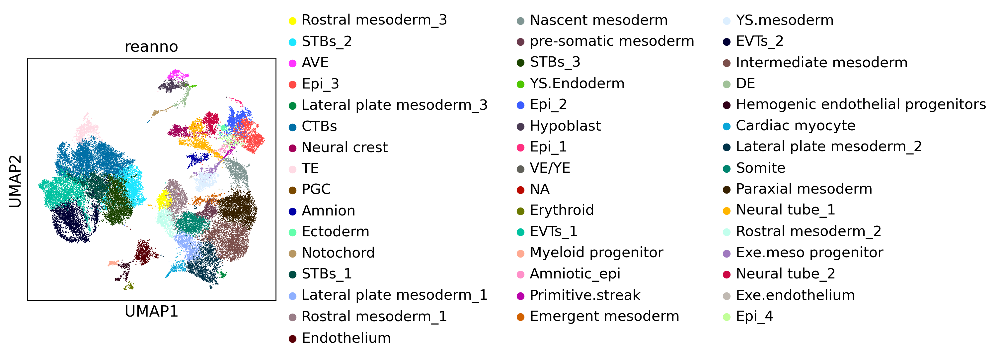

In [90]:
sc.pl.umap(adata, color=['reanno'])

In [91]:
#check clusters
print(adata.obs['reanno'].value_counts())

CTBs                                 4284
STBs_3                               2360
EVTs_2                               2189
EVTs_1                               2186
Paraxial mesoderm                    2151
Intermediate mesoderm                2104
STBs_2                               1674
STBs_1                               1533
Epi_3                                1258
Somite                               1247
Lateral plate mesoderm_2             1204
Rostral mesoderm_1                    947
Neural tube_1                         946
Epi_2                                 774
Nascent mesoderm                      757
Lateral plate mesoderm_1              742
YS.mesoderm                           649
Rostral mesoderm_2                    642
Endothelium                           634
Neural tube_2                         623
TE                                    621
pre-somatic mesoderm                  508
Rostral mesoderm_3                    413
Neural crest                          368
Hypoblast                             324
Amnion                                279
AVE                                   232
Cardiac myocyte                       227
Exe.meso progenitor                   200
Emergent mesoderm                     182
Hemogenic endothelial progenitors     181
Epi_4                                 178
DE                                    162
Ectoderm                              115
VE/YE                                 109
Myeloid progenitor                    108
Notochord                              93
Primitive.streak                       86
Erythroid                              86
Amniotic_epi                           69
Lateral plate mesoderm_3               64
Epi_1                                  36
YS.Endoderm                            30
Exe.endothelium                        13
PGC                                    11
NA                                      0
Name: reanno, dtype: int64

In [92]:
# Drop unused categories from the 'reanno' column
adata.obs['reanno'] = adata.obs['reanno'].cat.remove_unused_categories()

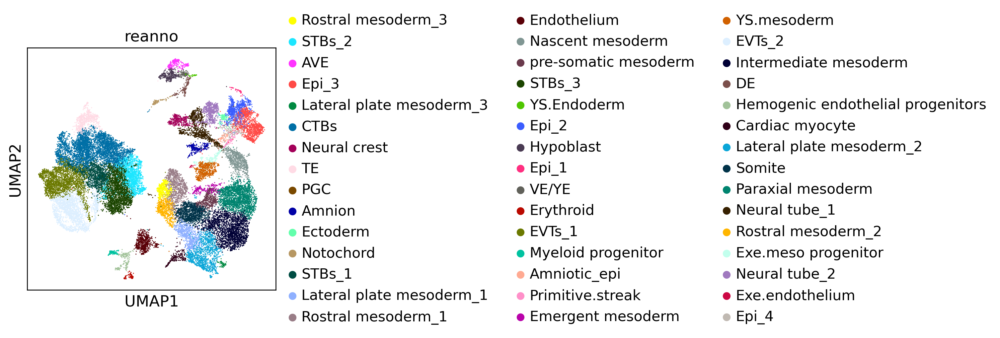

In [93]:
sc.pl.umap(adata, color=['reanno'])

In [94]:
# Assuming `adata.obs['reanno']` contains your reanno names
reanno_names = set(adata.obs['reanno'].unique())  # Get unique reanno names as a set

# Your ordered labels list
ordered_labels = [ 'TE', 'CTBs', 'STBs_1','STBs_2','STBs_3', 'EVTs_1', 'EVTs_2', 
                 'Epi_1','Epi_2','Epi_3','Epi_4','Primitive.streak','Notochord', 'PGC',
                  'Nascent mesoderm',
                  'Hypoblast', 'AVE','VE/YE','YS.Endoderm', 'Exe.meso progenitor', 'YS.mesoderm', 'Exe.endothelium',
                  'Amnion', 'Amniotic_epi', 'Ectoderm','Neural crest','Neural tube_1', 'Neural tube_2','DE',
                  'Paraxial mesoderm','Intermediate mesoderm','Emergent mesoderm',
                  'Lateral plate mesoderm_1','Lateral plate mesoderm_2','Lateral plate mesoderm_3',
                  'pre-somatic mesoderm','Somite',
                  'Rostral mesoderm_1','Rostral mesoderm_2',
                  'Rostral mesoderm_3', 'Cardiac myocyte',
                  'Hemogenic endothelial progenitors', 'Endothelium', 'Erythroid','Myeloid progenitor',
  ]


# Convert `ordered_labels` list to a set
ordered_labels_set = set(ordered_labels)

# Find names in reanno that are not in ordered_labels
missing_in_ordered = reanno_names.difference(ordered_labels_set)

# Output the results
if len(missing_in_ordered) == 0:
    print("All reanno names are listed in ordered_labels.")
else:
    print("These reanno names are missing in ordered_labels:", missing_in_ordered)


All reanno names are listed in ordered_labels.

In [95]:
# Ensure the 'reanno' column is of type 'category' with the specified order
adata.obs['reanno'] = pd.Categorical(adata.obs['reanno'], categories=ordered_labels, ordered=True)

# Verify the changes
print(adata.obs['reanno'].cat.categories)


Index(['TE', 'CTBs', 'STBs_1', 'STBs_2', 'STBs_3', 'EVTs_1', 'EVTs_2', 'Epi_1',
       'Epi_2', 'Epi_3', 'Epi_4', 'Primitive.streak', 'Notochord', 'PGC',
       'Nascent mesoderm', 'Hypoblast', 'AVE', 'VE/YE', 'YS.Endoderm',
       'Exe.meso progenitor', 'YS.mesoderm', 'Exe.endothelium', 'Amnion',
       'Amniotic_epi', 'Ectoderm', 'Neural crest', 'Neural tube_1',
       'Neural tube_2', 'DE', 'Paraxial mesoderm', 'Intermediate mesoderm',
       'Emergent mesoderm', 'Lateral plate mesoderm_1',
       'Lateral plate mesoderm_2', 'Lateral plate mesoderm_3',
       'pre-somatic mesoderm', 'Somite', 'Rostral mesoderm_1',
       'Rostral mesoderm_2', 'Rostral mesoderm_3', 'Cardiac myocyte',
       'Hemogenic endothelial progenitors', 'Endothelium', 'Erythroid',
       'Myeloid progenitor'],
      dtype='object')

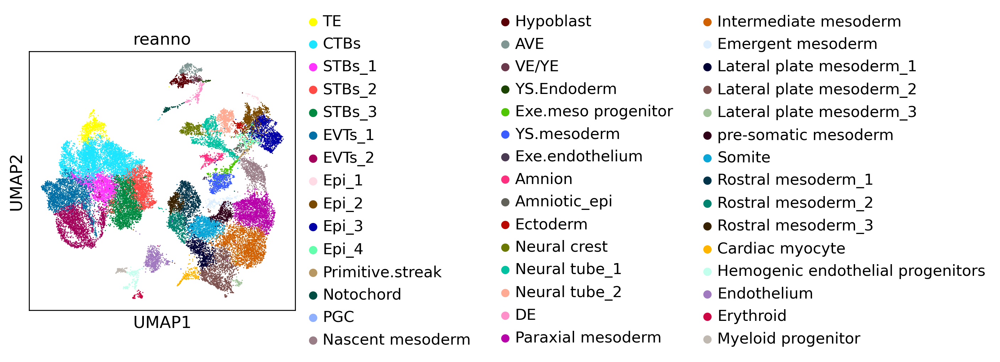

In [96]:
sc.pl.umap(adata, color=['reanno'])

In [97]:
##save dataset
adata.raw.var.rename(columns={'_index': 'index'}, inplace=True)
adata.write_h5ad(filename="human_reanno.h5ad")